In [3]:
%load_ext autoreload
%autoreload 2

from ff_energy.utils import pickle_output, read_from_pickle
import pandas as pd
import scikit_posthocs as sp
import seaborn as sns
import matplotlib.pyplot as plt
from ff_energy.plot import plot_energy_MSE, plot_ff_fit
# plt.style.use(['science','nature','no-latex'])

from ff_energy.structure import atom_key_pairs
from ff_energy.potential import LJ, akp_indx
from ff_energy.ff import FF
from ff_energy.ff_fit import LJ_bound
from ff_energy.data import pairs_data
akp_indx

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


{('CG331', 'CG331'): 0,
 ('CG331', 'HGA3'): 1,
 ('CG331', 'HGP1'): 2,
 ('CG331', 'HT'): 3,
 ('CG331', 'OG311'): 4,
 ('CG331', 'OT'): 5,
 ('HGA3', 'HGA3'): 6,
 ('HGA3', 'HGP1'): 7,
 ('HGA3', 'HT'): 8,
 ('HGA3', 'OG311'): 9,
 ('HGA3', 'OT'): 10,
 ('HGP1', 'HGP1'): 11,
 ('HGP1', 'HT'): 12,
 ('HGP1', 'OG311'): 13,
 ('HGP1', 'OT'): 14,
 ('HT', 'HT'): 15,
 ('HT', 'OG311'): 16,
 ('HT', 'OT'): 17,
 ('OG311', 'OG311'): 18,
 ('OG311', 'OT'): 19,
 ('OT', 'OT'): 20}

In [5]:
pc_pbe0_dz_d4 = next(read_from_pickle("data_pc_pbe0_d4.obj.pkl"))
pc_pbe0_dz = next(read_from_pickle("data_pc_pbe0.obj.pkl"))
pc_hf_dz = next(read_from_pickle("data_pc_hfdz.obj.pkl"))
pc_pbe0tz = next(read_from_pickle("data_pc_pbe0tz.obj.pkl"))
pnolccsd_pvtzdf = next(read_from_pickle("data_pc_pno-lccsd-pvtzdf.obj.pkl"))

In [6]:
pnolccsd_pvtzdf.data.head()

,TOTAL,ELEC,VDW,KEY,M_ENERGY,KEY,n_monomers,C_ENERGY,n_pairs,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol
test467,None,None,None,test467,-1527.407808,test467,20,-1527.492783,190,-53.322300,-49.887047,-958452.981455,-958454.414035,-958506.303754
test263,None,None,None,test263,-1527.409971,test263,20,-1527.514189,190,-65.397365,-65.127503,-958454.338813,-958455.664324,-958519.736178
test35,None,None,None,test35,-1527.395943,test35,20,-1527.511688,190,-72.629939,-68.380696,-958445.536552,-958446.939042,-958518.166492
test223,None,None,None,test223,-1527.399687,test223,20,NaN,190,NaN,-40.132986,-958447.885716,-958448.602330,NaN
test254,None,None,None,test254,-1527.386899,test254,20,-1527.489028,190,-64.085902,-61.361656,-958439.861409,-958440.588926,-958503.947311


In [7]:
pc_pbe0_dz.data.head()

,ECOL,KEY,TOTAL,ELEC,VDW,KEY,M_ENERGY,KEY,n_monomers,C_ENERGY,n_pairs,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol,NBONDS,nb_intE,n,epol_mike
test0,-173.022645,test0,24.14023,-86.50353,20.41138,test0,-1527.133263,test0,20,-1527.276175,190,-89.677734,-77.478222,-958280.703813,-958281.958376,-958370.381547,-66.09215,-66.09215,0,-197.910658
test1,-105.096240,test1,25.25058,-55.44306,8.97296,test1,-1527.135387,test1,20,-1527.221635,189,-54.121080,-53.285800,-958282.036711,-958282.584930,-958336.157791,-46.47010,-46.47010,1,-113.959761
test2,-144.567121,test2,24.75756,-76.78875,14.41942,test2,-1527.140946,test2,20,-1527.260418,190,-74.969007,-70.885989,-958285.524837,-958285.865743,-958360.493844,-62.36933,-62.36933,2,-160.484782
test3,-105.558619,test3,21.75948,-60.46748,5.74741,test3,-1527.151295,test3,20,-1527.247454,190,-60.340318,-58.662892,-958292.019016,-958292.985606,-958352.359334,-54.72007,-54.72007,3,-118.662845
test4,-141.957058,test4,21.69034,-77.22292,12.55821,test4,-1527.150321,test4,20,-1527.270835,190,-75.623009,-73.371184,-958291.407609,-958292.418141,-958367.030618,-64.66471,-64.66471,4,-155.773808


In [8]:
pc_pbe0_dz.pairs_df

,p_ENERGY,p_m1_ENERGY,p_m2_ENERGY,p_int_ENERGY,key,pair
test467_4_16,-152.718742,-76.359402,-76.358684,-0.000656,test467,"(4, 16)"
test467_2_12,-152.717266,-76.357394,-76.359906,0.000034,test467,"(2, 12)"
test467_4_5,-152.714677,-76.359402,-76.355286,0.000012,test467,"(4, 5)"
test467_5_16,-152.713801,-76.355286,-76.358684,0.000168,test467,"(5, 16)"
test467_4_20,-152.714093,-76.359402,-76.354903,0.000213,test467,"(4, 20)"
...,...,...,...,...,...,...
test66_3_5,-152.705818,-76.352102,-76.354001,0.000286,test66,"(3, 5)"
test66_2_20,-152.707280,-76.352639,-76.354519,-0.000122,test66,"(2, 20)"
test66_3_10,-152.711822,-76.352102,-76.359671,-0.000049,test66,"(3, 10)"
test66_4_15,-152.712115,-76.358842,-76.353240,-0.000033,test66,"(4, 15)"


n: 393
8.905163484164466e-239


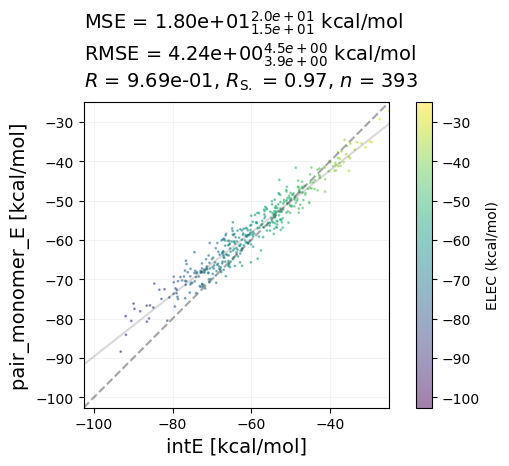

In [11]:
pc_pbe0_dz.plot_pair_monomer_E()

In [43]:
p_d_, jax_data = pairs_data(pc_pbe0_dz.pairs_df)

Strcuture,PDB already already exists, loading structure from pickle


In [54]:
p_d_.groupby("key").sum().loc["test467"]

/tmp/ipykernel_10432/1271169984.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  p_d_.groupby("key").sum().loc["test467"]


p_ENERGY       -29016.010277
p_m1_ENERGY    -14507.952611
p_m2_ENERGY    -14507.977511
p_int_ENERGY       -0.080156
ECOL_PC           -53.451731
angle_1          5643.236971
angle_2          5626.909958
dih              1167.481726
theta             838.616547
distance         1137.252218
min_hbond        1021.729702
Name: test467, dtype: float64

In [45]:
jax_data

{'dcm_ecols': Array([  8.914283 , -16.457504 ,   6.8699346, ...,   5.4019375,
        -12.314625 ,   6.3897295], dtype=float32),
 'dcm_c_idx1': Array([0, 0, 0, ..., 2, 2, 2], dtype=int32),
 'dcm_c_idx2': Array([0, 1, 2, ..., 0, 1, 2], dtype=int32),
 'dcm_c1s': Array([0.338, 0.338, 0.338, ..., 0.338, 0.338, 0.338], dtype=float32),
 'dcm_c2s': Array([ 0.338, -0.676,  0.338, ...,  0.338, -0.676,  0.338], dtype=float32),
 'dcm_pairs_idx': Array([[[ 4, 16]],
 
        [[ 4, 16]],
 
        [[ 4, 16]],
 
        ...,
 
        [[ 1, 16]],
 
        [[ 1, 16]],
 
        [[ 1, 16]]], dtype=int32),
 'dcm_dists': Array([4.2556744, 4.6102114, 5.5220737, ..., 7.0227184, 6.161176 ,
        5.9370723], dtype=float32),
 'dcm_dists_labels': Array([    0,     0,     0, ..., 94751, 94751, 94751], dtype=int32),
 'cluster_labels': Array([467, 467, 467, ...,  66,  66,  66], dtype=int32)}

In [46]:
from ff_energy.potential import ecol


In [47]:
outE = ecol(jax_data["dcm_c1s"], jax_data["dcm_c2s"], jax_data["dcm_dists"])

In [48]:
import jax
jax.ops.segment_sum(outE, jax_data["dcm_dists_labels"])

Array([-0.41785288,  0.07762909,  0.03894663, ..., -0.02339125,
       -0.08855104,  0.10346365], dtype=float32)

In [55]:
jax.ops.segment_sum(outE, jax_data["cluster_labels"])[467]

Array(-53.45181, dtype=float32)

In [52]:
jax_data["cluster_labels"]

Array([467, 467, 467, ...,  66,  66,  66], dtype=int32)

In [49]:
p_d_["ECOL_PC"]

test467_4_16   -0.417853
test467_2_12    0.077630
test467_4_5     0.038944
test467_5_16    0.144882
test467_4_20    0.180717
                  ...   
test66_3_5      0.181986
test66_2_20    -0.084239
test66_3_10    -0.023391
test66_4_15    -0.088553
test66_1_16     0.103462
Name: ECOL_PC, Length: 94752, dtype: float64

In [56]:
kmdcm_path = "/home/boittier/homeb/water_cluster/pbe0dz_kmdcm/{}/charmm/dcm.xyz"

In [57]:
kmdcm_p_d_, jax_data = pairs_data(pc_pbe0_dz.pairs_df, name="kmdcm", dcm_path_=kmdcm_path)

Strcuture,PDB already already exists, loading structure from pickle


In [58]:
kmdcm_p_d_.head()

,p_ENERGY,p_m1_ENERGY,p_m2_ENERGY,p_int_ENERGY,key,pair,ECOL_PC,angle_1,angle_2,dih,theta,distance,min_hbond,dcms,ECOL_kmdcm
test467_4_16,-152.718742,-76.359402,-76.358684,-0.000656,test467,"(4, 16)",-0.417853,17.339039,20.503450,-167.920146,132.809173,5.457905,3.836838,"[[[-3.5195, 0.193, -3.9432], [-3.7284, 0.1404,...",-0.384970
test467_2_12,-152.717266,-76.357394,-76.359906,0.000034,test467,"(2, 12)",0.077630,31.291186,28.290189,63.359007,61.070362,6.499726,5.167323,"[[[-0.357, -1.3034, -5.7965], [-0.7411, -1.662...",0.035019
test467_4_5,-152.714677,-76.359402,-76.355286,0.000012,test467,"(4, 5)",0.038944,28.133396,17.516706,48.957649,57.943799,6.735905,5.708780,"[[[-3.5195, 0.193, -3.9432], [-3.7284, 0.1404,...",0.015178
test467_5_16,-152.713801,-76.355286,-76.358684,0.000168,test467,"(5, 16)",0.144882,11.628122,16.364509,-165.931551,124.681660,6.151530,4.888614,"[[[-1.3749, 5.7091, -3.5927], [-1.8948, 5.6584...",0.116138
test467_4_20,-152.714093,-76.359402,-76.354903,0.000213,test467,"(4, 20)",0.180717,34.183827,27.185213,29.313988,-80.603652,7.043256,6.132629,"[[[-3.5195, 0.193, -3.9432], [-3.7284, 0.1404,...",0.141950


In [61]:
outE = ecol(jax_data["dcm_c1s"], jax_data["dcm_c2s"], jax_data["dcm_dists"])

jax.ops.segment_sum(outE, jax_data["dcm_dists_labels"])

Array([-0.3849694 ,  0.03501844,  0.0151785 , ..., -0.02125731,
        0.06373268,  0.13207424], dtype=float32)

In [366]:
mdcm_path = "/home/boittier/homeb/water_cluster/pbe0dz_mdcm/{}/charmm/dcm.xyz"
mdcm_p_d_ = pairs_data(pc_pbe0_dz.pairs_df, name="mdcm", dcm_path_=mdcm_path)

Strcuture,PDB already already exists, loading structure from pickle


In [68]:
# pc_pbe0_dz.data
kmdcm = next(read_from_pickle("data_kmdcm_pbe0.obj.pkl"))

In [147]:
scale = 1
set((scale * jax_data["dcm_c1s"]).tolist())

{-0.3034000098705292, 0.1054999977350235, 0.19789999723434448}

In [148]:
scale = 1
set((scale * jax_data["dcm_c2s"]).tolist())

{-0.3034000098705292, 0.1054999977350235, 0.19789999723434448}

In [76]:
from ff_energy.utils import str2int
kmdcm.data["k"] = [str2int(_) for _ in kmdcm.data.index]
kmdcm.data = kmdcm.data.sort_values("k").copy()

In [149]:
scale = 1.313
KEY = "epol_mike"
outE = ecol(scale * jax_data["dcm_c1s"], scale * jax_data["dcm_c2s"], jax_data["dcm_dists"])

kmdcm.data["kmdcm_calc"] = jax.ops.segment_sum(outE, jax_data["cluster_labels"])
((kmdcm.data["kmdcm_calc"] - kmdcm.data[KEY])**2).mean()

KeyError: 'epol_mike'

In [140]:
# kmdcm.data

0.0


(<Axes: xlabel='NBOND energy\n(kcal/mol)', ylabel='CCSD(T) interaction energy\n(kcal/mol)'>,
 {'MSE': 3210.1909596343576,
  'RMSE': 56.65854710133642,
  'R': 0.974642974616211,
  'RS': 0.9712630530522122,
  'n': 500,
  'slope': 0.5898450470221722,
  'intercept': 0.7442057103565531})

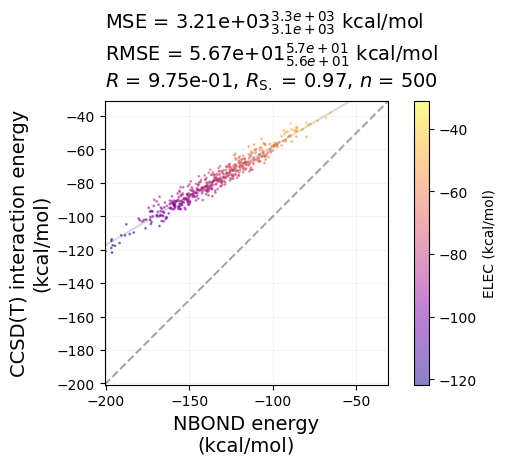

In [141]:
plot_energy_MSE(kmdcm.data, "ECOL", "ELEC", elec="ELEC", CMAP="plasma")

8.3681586174e-314


(<Axes: xlabel='NBOND energy\n(kcal/mol)', ylabel='CCSD(T) interaction energy\n(kcal/mol)'>,
 {'MSE': 37.61585630912492,
  'RMSE': 6.133176689866755,
  'R': 0.9715811006622338,
  'RS': 0.9676600626402504,
  'n': 500,
  'slope': 1.010774457150319,
  'intercept': 1.0524561908896146})

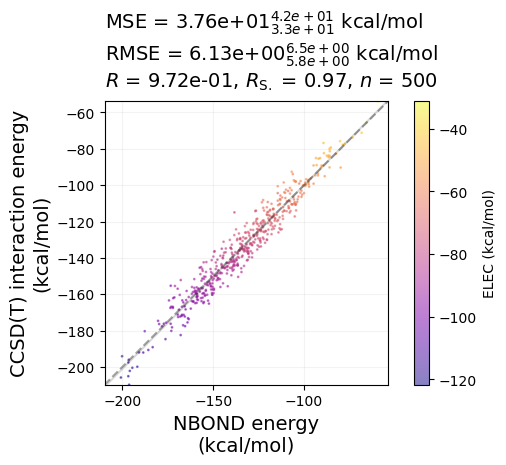

In [142]:
plot_energy_MSE(kmdcm.data, "ECOL", "kmdcm_calc",  elec="ELEC", CMAP="plasma")

In [151]:
test_ff_fn = "pbe0_dz_kmdcm_LJ_water_cluster_ELEC_harmonic_ELEC.pkl"
test_ff = next(read_from_pickle(test_ff_fn))

AttributeError: Can't get attribute 'FF' on <module 'ff_energy.potential' from '/home/boittier/Documents/phd/ff_energy/ff_energy/potential.py'>

In [150]:
kmdcm.data

,ECOL,KEY,TOTAL,ELEC,VDW,KEY,M_ENERGY,KEY,n_monomers,C_ENERGY,n_pairs,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol,NBONDS,nb_intE,k,kmdcm_calc
test0,-173.022645,test0,26.51820,-104.54998,20.41138,test0,-1527.133263,test0,20,-1527.276175,190,-89.677734,-77.478222,-958280.703813,-958281.958376,-958370.381547,-84.13860,-84.13860,0,-180.155991
test1,-105.096240,test1,26.52417,-63.45565,8.97296,test1,-1527.135387,test1,20,-1527.221635,189,-54.121080,-53.285800,-958282.036711,-958282.584930,-958336.157791,-54.48269,-54.48269,1,-109.258102
test2,-144.567121,test2,26.23794,-89.34864,14.41942,test2,-1527.140946,test2,20,-1527.260418,190,-74.969007,-70.885989,-958285.524837,-958285.865743,-958360.493844,-74.92922,-74.92922,2,-153.952515
test3,-105.558619,test3,23.48704,-62.57541,5.74741,test3,-1527.151295,test3,20,-1527.247454,190,-60.340318,-58.662892,-958292.019016,-958292.985606,-958352.359334,-56.82800,-56.82800,3,-107.842354
test4,-141.957058,test4,23.51431,-90.29468,12.55821,test4,-1527.150321,test4,20,-1527.270835,190,-75.623009,-73.371184,-958291.407609,-958292.418141,-958367.030618,-77.73647,-77.73647,4,-155.577515
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
test495,-156.403481,test495,26.51738,-95.04093,17.54292,test495,-1527.129876,test495,20,-1527.255655,190,-78.926606,-72.611238,-958278.578831,-958280.757990,-958357.505436,-77.49801,-77.49801,495,-163.788971
test496,-126.839243,test496,17.42032,-75.31144,12.74644,test496,-1527.168887,test496,20,-1527.264530,190,-60.016740,-61.118914,-958303.057842,-958304.589708,-958363.074582,-62.56500,-62.56500,496,-129.823486
test497,-160.377711,test497,22.32988,-90.76807,24.76786,test497,-1527.154064,test497,20,-1527.248923,190,-59.524062,-57.960443,-958293.756804,-958294.973787,-958353.280867,-66.00021,-66.00021,497,-156.484238
test498,-154.210967,test498,22.87724,-87.19819,20.35679,test498,-1527.150078,test498,20,-1527.257280,190,-67.269733,-65.470853,-958291.255270,-958293.538908,-958358.525003,-66.84140,-66.84140,498,-150.347595


<Axes: >

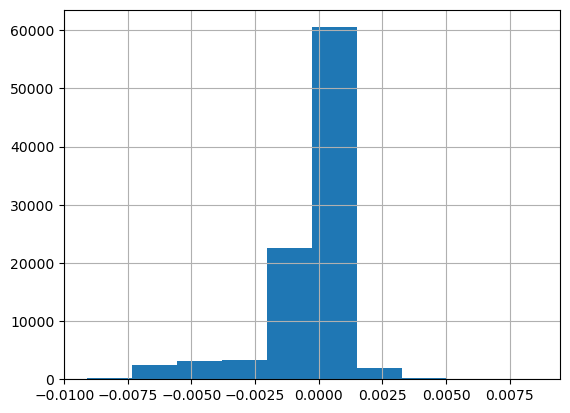

In [399]:
mdcm_p_d_.p_int_ENERGY.hist()

In [371]:
ff = FF(mdcm_p_d_, 
        [], 
        LJ, 
        LJ_bound, 
        pc_pbe0tz.structure_key_pairs['test467'], 
        pairs=True,
       elec="ECOL_PC"
       )



In [372]:
ff.atom_type_pairs

[('HT', 'HT'), ('HT', 'OT'), ('OT', 'OT')]

In [373]:
test = pc_pbe0tz.pairs_df
test

,p_ENERGY,p_m1_ENERGY,p_m2_ENERGY,p_int_ENERGY,key,pair
test467_4_20,-152.753907,-76.379425,-76.374699,0.000217,test467,"(4, 20)"
test467_5_13,-152.754182,-76.374969,-76.378879,-0.000334,test467,"(5, 13)"
test467_7_8,-152.752493,-76.377996,-76.375156,0.000659,test467,"(7, 8)"
test467_7_11,-152.755901,-76.377996,-76.377815,-0.000090,test467,"(7, 11)"
test467_2_16,-152.756188,-76.377125,-76.378947,-0.000116,test467,"(2, 16)"
...,...,...,...,...,...,...
test66_1_18,-152.757224,-76.378513,-76.379381,0.000669,test66,"(1, 18)"
test66_6_12,-152.753140,-76.375769,-76.376892,-0.000479,test66,"(6, 12)"
test66_11_16,-152.756776,-76.377345,-76.378652,-0.000779,test66,"(11, 16)"
test66_12_18,-152.756440,-76.376892,-76.379381,-0.000168,test66,"(12, 18)"


In [374]:
for key in pc_pbe0tz.structure_key_pairs.keys():
    pc_pbe0tz.structure_key_pairs[key].set_2body()

In [375]:
pairs_key_pairs = {}

for iindex in test.index:
    key, a, b = iindex.split("_")
    a, b = int(a), int(b)
    # print(key, a, b)
    pairs_key_pairs[iindex] = [0]*21
    for i, akp in enumerate(ff.atom_type_pairs):
        k = akp_indx[akp]
        dists= pc_pbe0tz.structure_key_pairs[key].distances_pairs[k][(a,b)]
        pairs_key_pairs[iindex][k] = dists



In [376]:
# pairs_key_pairs.keys()
ff.dists = pairs_key_pairs

In [377]:
pkpl = list(pairs_key_pairs.keys())
ff.data = ff.data.query("index in @pkpl").copy()

In [3]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))


In [4]:
fit = ff.LJ_performace(ff.eval_func([1.34, 1.04, 0.01, 0.15]))
# fit = ff.LJ_performace(ff.eval_func([2.49, 0.85, 0.0001, 0.0001]))
# fit = ff.LJ_performace(ff.eval_func([1.63, 0.25, 0.25, 0.38]))
# fit = ff.LJ_performace(ff.eval_func([0.25, 1.8, 0.5, 0.06]))
# fit = ff.LJ_performace(ff.eval_func([1.8, 0.25, 0.06, 0.5, ]))

In [379]:
# fit.groupby("key").sum()

/tmp/ipykernel_835282/3961709191.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  plot_energy_MSE(fit.groupby("key").sum(),


(<Axes: xlabel='Pair int. $E$ [kcal/mol]', ylabel='LJ int. $E$ [kcal/mol]'>,
 {'MSE': 88.32954164284271,
  'RMSE': 9.39837973497787,
  'R': 0.8932046720528768,
  'RS': 0.8764516338065352,
  'n': 500})

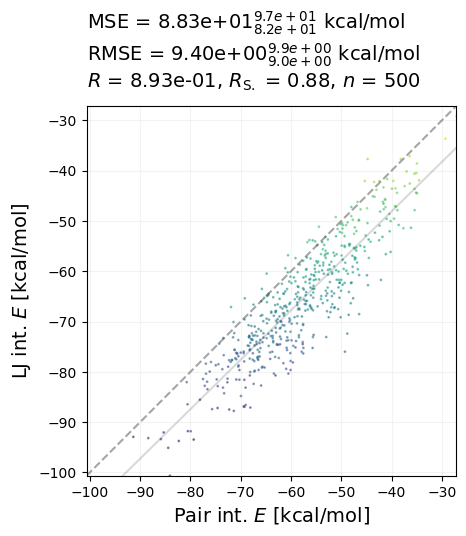

In [5]:
plot_energy_MSE(fit.groupby("key").sum(), 
                "intE", 
                "nb_intE", 
                elec='ECOL_PC', 
                bootstrap=True,
                xlabel="Pair int. $E$ [kcal/mol]",
                ylabel="LJ int. $E$ [kcal/mol]"
               )

In [6]:
fit.describe()

,p_ENERGY,p_m1_ENERGY,p_m2_ENERGY,p_int_ENERGY,ECOL_PC,angle_1,angle_2,dih,theta,distance,min_hbond,ECOL_kmdcm,ECOL_mdcm,intE,LJ,nb_intE,SE
count,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,94748.000000,9.474800e+04
mean,-152.715118,-76.357327,-76.357304,-0.000488,-0.356586,32.792300,32.485654,0.206900,-3.362819,6.142301,5.608742,-0.410780,-0.425065,-0.305922,0.009554,-0.347032,1.918052e-01
std,0.003147,0.001928,0.001943,0.001567,1.272407,22.890597,23.665641,103.864340,94.589752,2.084259,2.139655,1.459773,1.508399,0.983583,0.252317,1.150750,1.028693e+00
min,-152.726605,-76.359913,-76.359913,-0.009118,-8.567905,0.041352,0.106423,-179.998969,-179.808303,2.120206,1.040163,-11.489025,-10.500416,-5.721861,-0.679545,-6.464610,2.183033e-14
25%,-152.717140,-76.358751,-76.358747,-0.000489,-0.266552,17.445700,16.620978,-89.466224,-89.728622,4.544299,3.963391,-0.262787,-0.276050,-0.306913,-0.014801,-0.280162,9.267923e-05
50%,-152.715385,-76.357755,-76.357756,-0.000078,-0.040983,27.328840,26.543686,-0.093532,4.450766,6.018311,5.527768,-0.039893,-0.041947,-0.048992,-0.002829,-0.044943,8.079840e-04
75%,-152.713301,-76.356374,-76.356322,0.000126,0.097761,41.571941,41.251304,90.411841,81.011285,7.704171,7.183410,0.090680,0.096147,0.079374,-0.000649,0.092084,1.144495e-02
max,-152.696128,-76.342729,-76.342729,0.008595,3.711994,178.554355,178.177519,179.998642,178.624596,12.073301,12.486669,4.429839,4.993904,5.393395,9.575535,8.402209,3.774405e+01


In [283]:
# import numpy as np
# key = "min_hbond"
# key_min = fit[key].min()
# key_max = fit[key].max()
# key_range = key_max - key_min
# NBINS = 100
# bins = np.arange(key_min, key_max, key_range/NBINS)
# fit[f"{key}_bin"] = (
#     np.digitize(fit[key], bins=bins) 
# ) 
# fit[f"{key}_bin"] = key_min + fit[f"{key}_bin"] * key_range/NBINS 
# EB = ("sd", 3)


# def intEvsR(fit, ax):
#     sns.lineplot(x="min_hbond_bin", y="nb_intE", data=fit, 
#                  errorbar=EB,
#                  color="purple",
#                  ax=ax,
#                  label="$E_{pairs(Model)}$"
#                 )
#     sns.lineplot(x="min_hbond_bin", y="intE", data=fit, 
#                  errorbar=EB,
#                  color="black",
#                  alpha=0.8,
#                  ax=ax,
#                  label="$E_{pairs(DFT)}$"
#                 )
#     ax.axhline(0, c="k", linewidth=0.5)
#     ax.set_xlim(1.,5)
#     ax.set_xlabel("$r$ [$\mathrm{\\AA}$]")
#     ax.set_ylim(-10,10)
#     ax.grid(alpha=0.5)
#     return ax


In [282]:
# def EvsR(fit, ax, ecol="ECOL_kmdcm"):
#     sns.lineplot(x="min_hbond_bin", y=ecol, data=fit, 
#                  errorbar=EB,
#                  color="orange",
#                  ax=ax,
#                  label="$E_{ELEC}$"
#                 )
#     sns.lineplot(x="min_hbond_bin", y="LJ", data=fit, 
#                  errorbar=EB,
#                  color="green",
#                  ax=ax,
#                  label="$E_{LJ}$"
#                 )
#     ax.axhline(0, c="k", linewidth=0.5)
#     ax.grid(alpha=0.5)
#     ax.set_xlim(1,5)
#     ax.set_xlabel("$r$ [$\mathrm{\\AA}$]")
#     ax.set_ylim(-15,15)
#     return ax

In [284]:
# def plot_dists(fit, ax):
#     # fit = fit.dropna()
#     fit = fit.query("-10 < nb_intE < 10")
#     ax.hist(fit["intE"], color="k", alpha=0.3, label="$E_{pairs(DFT)}$")
#     ax.hist(fit["nb_intE"], color="gold", alpha=0.3, label="$E_{pairs(Model)}$")
#     ax.set_xlabel("$E$ [kcal/mol]")
#     ax.legend()
#     ax.set_xlim(-10,10)
#     return ax

In [285]:
# from ff_energy.plot import plot_energy_MSE
# def cor_pairs(fit, ax):
#     ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(), 
#                 "intE", 
#                 "nb_intE", 
#                 elec='ECOL_PC', 
#                 bootstrap=True,
#                 xlabel="$E_{DFT}$ [kcal/mol]",
#                 ylabel="$E_{Model}$ [kcal/mol]",
#                 ax=ax,
#                 title=False,
#                     FONTSIZE=10,
#                 bounds=(-100,-20)
#                )
#     return ax, stats


# def cor_pairs_cluster(fit, ax):
#     ax, _, stats = plot_energy_MSE(fit, 
#                 "intE", 
#                 "P_intE", 
#                 elec='ECOL', 
#                 bootstrap=True,
#                 xlabel="$E_{Clusters}$ [kcal/mol]",
#                 ylabel="$E_{Pairs}$ [kcal/mol]",
#                 ax=ax,
#                 title=False,
#                 FONTSIZE=10,
#                                 bounds=(-100,-20)
#                )
#     return ax, stats

# def cor_cluster(fit, ax):
#     ax, _, stats = plot_energy_MSE(fit, 
#                 "intE", 
#                 "nb_intE", 
#                 elec='ECOL', 
#                 bootstrap=True,
#                 xlabel="$E_{DFT}$ [kcal/mol]",
#                 ylabel="$E_{Model}$ [kcal/mol]",
#                 ax=ax,
#                 title=False,
#                 FONTSIZE=10,
#                                 bounds=(-100,-20)
#                )
#     return ax, stats

In [386]:
ff_fit.opt_parm

array([ 1.7323672 ,  0.25      ,  0.22202132,  0.12530526,  4.14010503,
       16.        ])

#  EPOL MIKE PAIRS

In [120]:
from pathlib import Path
files = list(Path("/home/boittier/homeb/h2o_epol/").glob("*"))


KEY = []
EPOLS = []
for i in range(len(files)):
    with open(files[i] / "dimer-eel.dat") as f:
        name = files[i].name

        for l in f.readlines():
            p1, p2, Epol = l.split()
            KEY.append(f"{name}_{p1}_{p2}")
            EPOLS.append(float(Epol))
            


In [125]:
mike_pair_epol_df = pd.DataFrame({"epol_mike": EPOLS}, index=KEY)
ff.data = pd.merge(mike_pair_epol_df, ff.data, left_index=True, right_index=True)

In [126]:
ff.data

,epol_mike,p_ENERGY,p_m1_ENERGY,p_m2_ENERGY,p_int_ENERGY,key,pair,ECOL_PC,angle_1,angle_2,...,min_hbond,dcms,ECOL_kmdcm,ECOL_mdcm,intE,LJ,nb_intE,SE,min_hbond_bin,DUMMY
test0_1_4,0.317974,-152.711914,-76.354433,-76.357858,0.000376,test0,"(1, 4)",0.342586,36.060998,37.499135,...,4.814702,"[[[3.6607, -3.9869, 0.3627], [3.584, -3.6572, ...",0.289394,0.325864,0.236198,-0.009342,0.333244,9.417823e-03,4.855665,0
test0_1_6,0.751515,-152.707301,-76.354433,-76.353664,0.000796,test0,"(1, 6)",0.501720,40.489479,16.296290,...,4.894730,"[[[3.6607, -3.9869, 0.3627], [3.584, -3.6572, ...",0.580611,0.600744,0.499455,-0.008466,0.493254,3.845176e-05,5.008285,0
test0_1_9,-0.525247,-152.713815,-76.354433,-76.358583,-0.000799,test0,"(1, 9)",0.013310,28.968520,19.871660,...,3.242240,"[[[3.6607, -3.9869, 0.3627], [3.584, -3.6572, ...",-0.159482,-0.187526,-0.501651,-0.047870,-0.034560,2.181735e-01,3.329464,0
test0_1_5,-11.999878,-152.717363,-76.354433,-76.356527,-0.006404,test0,"(1, 5)",-5.655584,24.500893,26.511180,...,2.861061,"[[[3.6607, -3.9869, 0.3627], [3.584, -3.6572, ...",-6.734176,-7.167582,-4.018222,0.501330,-5.154254,1.290568e+00,2.871604,0
test0_1_2,-0.880919,-152.711533,-76.354433,-76.355908,-0.001192,test0,"(1, 2)",-0.432284,26.259526,5.470347,...,3.771821,"[[[3.6607, -3.9869, 0.3627], [3.584, -3.6572, ...",-0.601759,-0.652367,-0.748115,-0.017691,-0.449975,8.888790e-02,3.787324,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
test499_17_18,-0.085227,-152.717532,-76.359304,-76.358107,-0.000121,test499,"(17, 18)",-0.075332,26.940443,22.080765,...,7.042422,"[[[1.0864, 3.0515, 5.847], [1.5773, 3.0563, 6....",-0.074096,-0.077285,-0.075915,-0.000583,-0.075916,1.157913e-13,7.144966,0
test499_17_20,-6.807906,-152.721767,-76.359304,-76.358867,-0.003597,test499,"(17, 20)",-3.088361,20.235411,22.429134,...,3.458020,"[[[1.0864, 3.0515, 5.847], [1.5773, 3.0563, 6....",-3.673874,-4.241587,-2.256852,0.187524,-2.900837,4.147161e-01,3.482084,0
test499_18_19,-0.069389,-152.717071,-76.358107,-76.358861,-0.000102,test499,"(18, 19)",-0.075283,25.734116,59.520757,...,9.392718,"[[[-1.2539, 9.5864, 4.7772], [-1.3242, 9.4611,...",-0.064215,-0.068768,-0.064018,-0.000195,-0.075478,1.313351e-04,9.434267,0
test499_18_20,0.069433,-152.716881,-76.358107,-76.358867,0.000093,test499,"(18, 20)",0.071954,16.058715,19.710475,...,7.785652,"[[[-1.2539, 9.5864, 4.7772], [-1.3242, 9.4611,...",0.059303,0.061258,0.058220,-0.000402,0.071552,1.777394e-04,7.908066,0


#  pickle

In [127]:
pickle_output(ff, "ff_pc_pairs")

<Axes: >

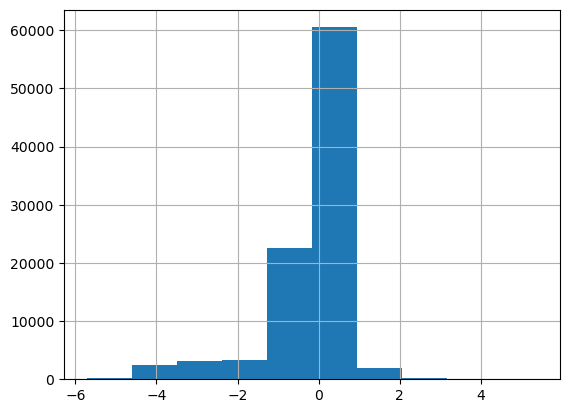

In [394]:
plot

In [143]:
# ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))

#  PC LJ

1.599009687851722 1.2645195482283862
0
30.6613586207218


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


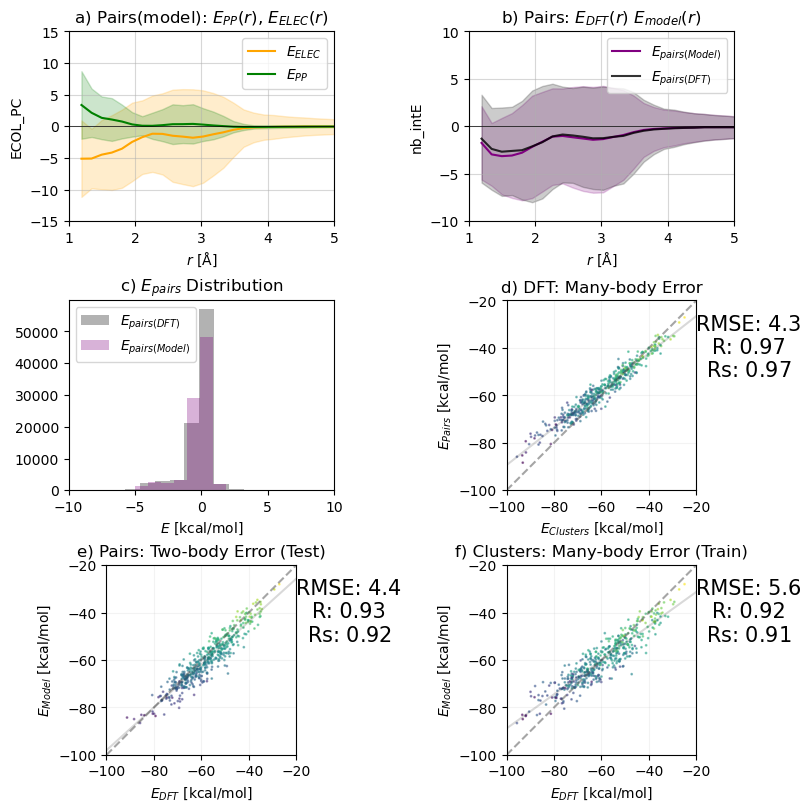

1
30.661358589193814


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


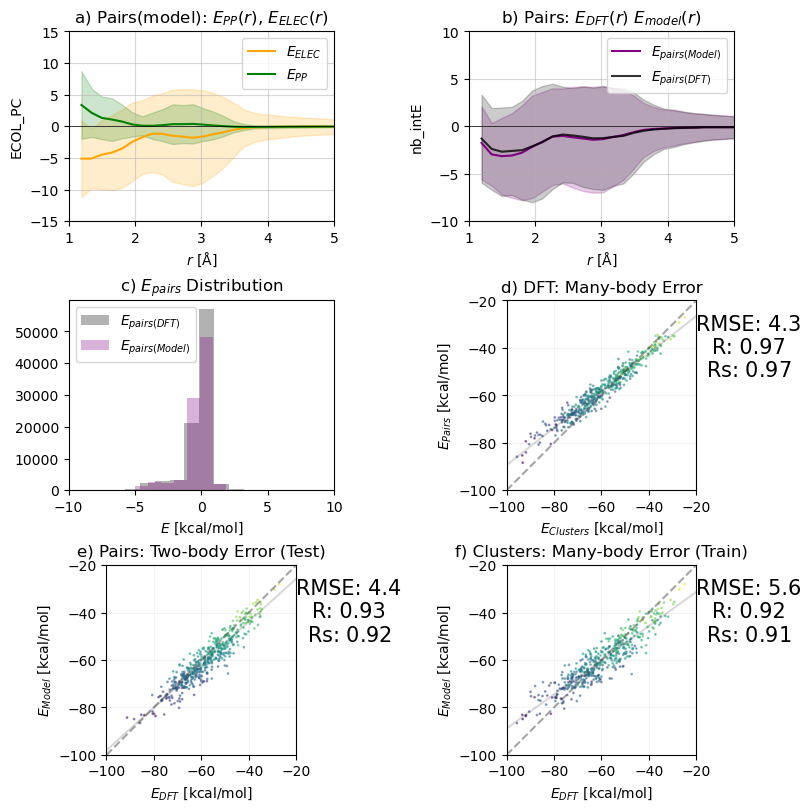

2
35.14200454065623


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


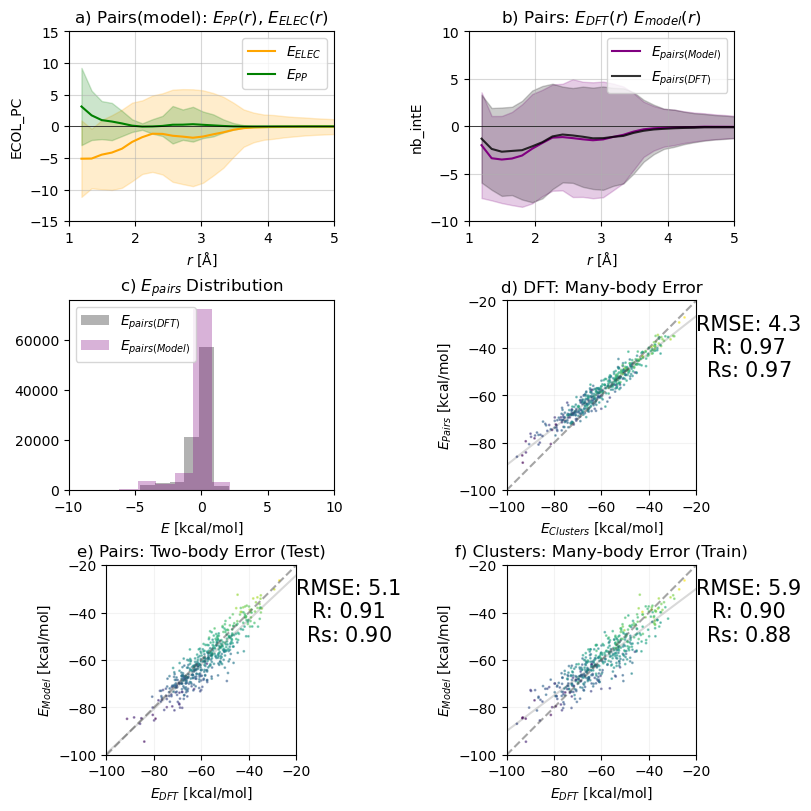

3
30.661358589007705


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


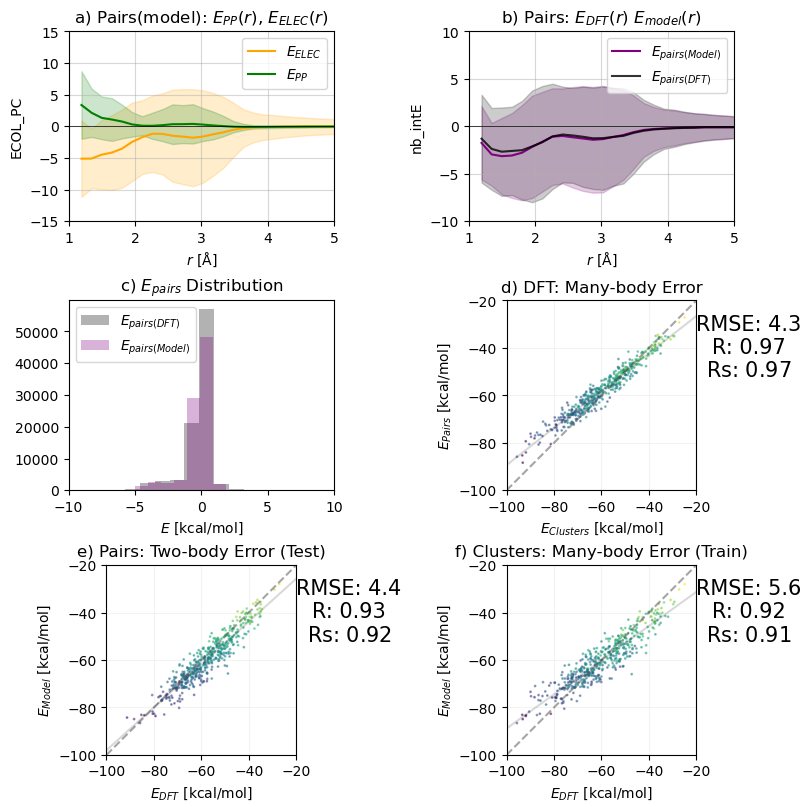

4
112.64028038219507


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


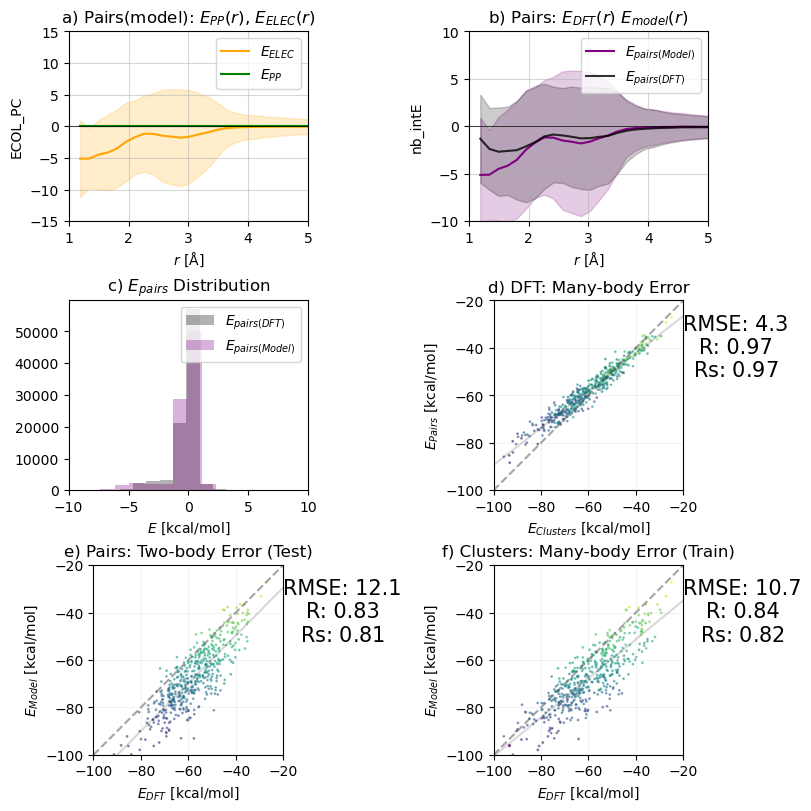

5
112.64028038219507


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


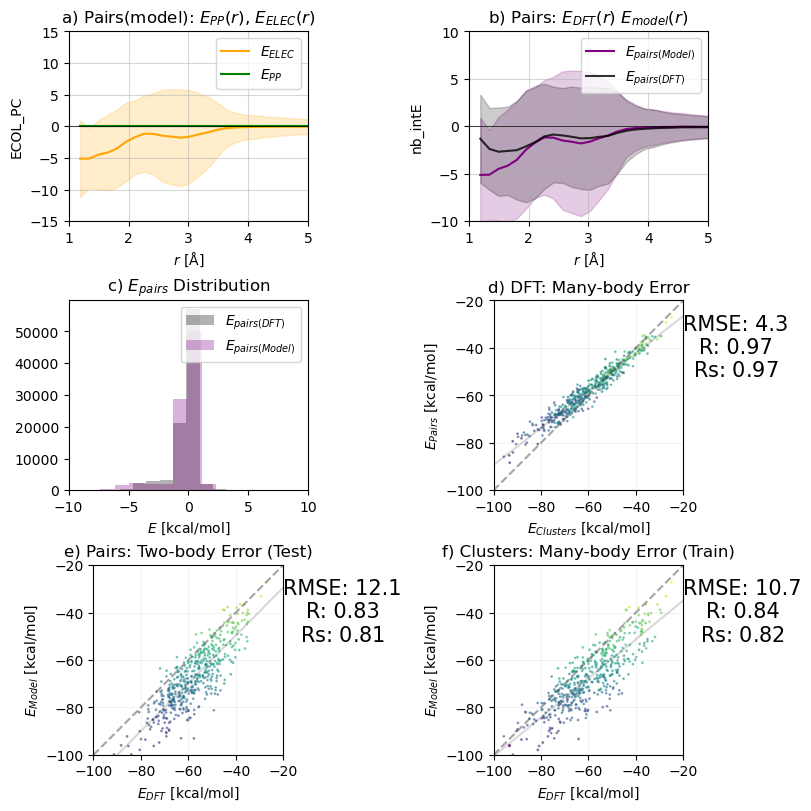

6
30.66135858900608


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


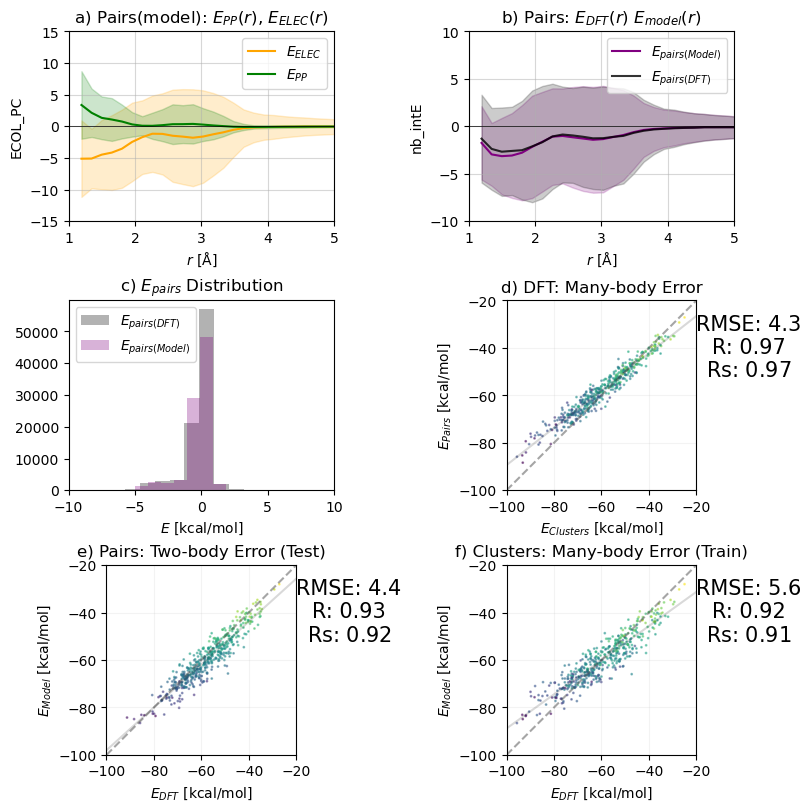

7
31.108246314631337


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


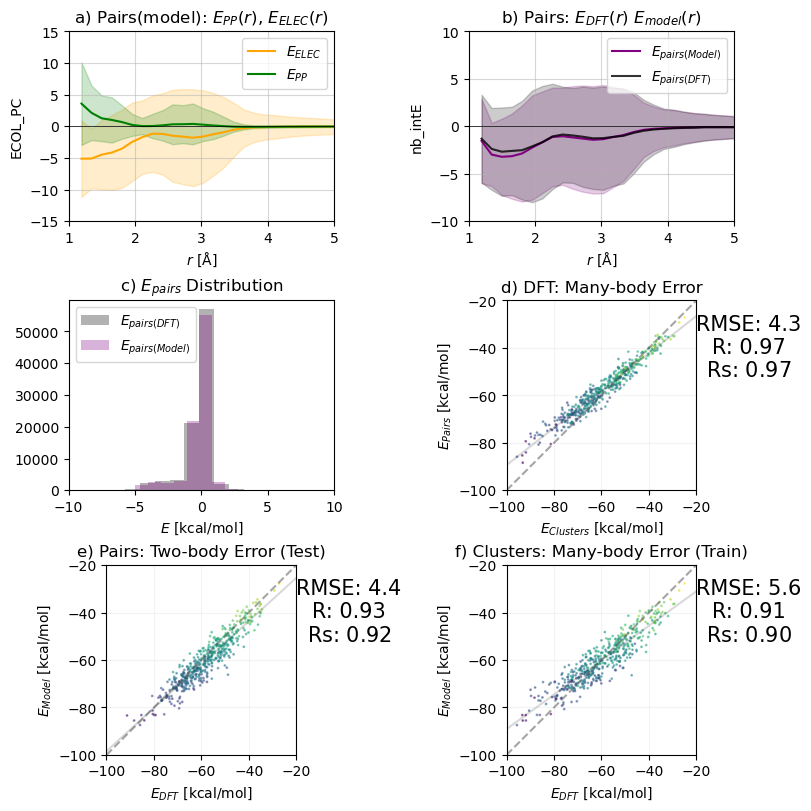

8
31.108246314610135


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


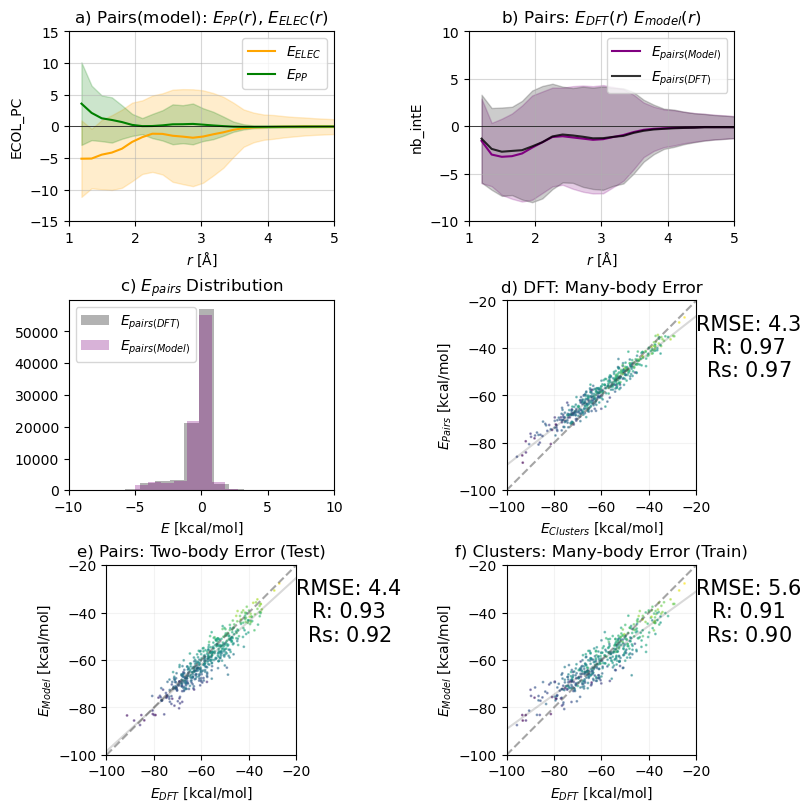

9
30.661358589027355


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


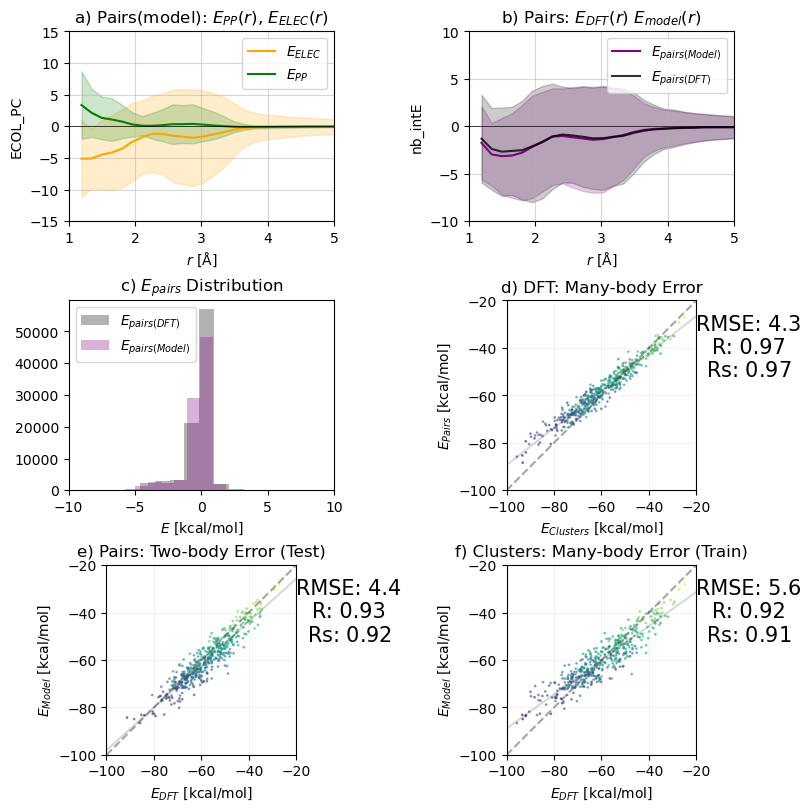

In [672]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit = next(read_from_pickle('pickles/pbe0_dz_pc_LJ_water_cluster_ELEC_harmonic_ELEC.pkl'))
pc_jc_harm_stats = plot_ff_fit(ff, ff_fit, ecol="ECOL_PC", EB=("sd", 3), suptitle="PC-LJ")

In [306]:
import matplotlib as mpl
norm = mpl.colors.Normalize(vmin=0, vmax=20)
cmap = plt.get_cmap("jet")

In [298]:
TEST = pc_jc_harm_stats[0]

In [578]:

def parm_plots(stats, title="PC/LJ"):


    norm = mpl.colors.Normalize(vmin=0, vmax=15)
    ax = plt.figure(layout=None).subplot_mosaic(
            """
            aac
            bbc
            """,
            # set the height ratios between the rows
            height_ratios=[1,0.05],
            # set the width ratios between the columns
            width_ratios=[2,2,2],
            empty_sentinel="X",
            # sharex=,
        )

    plt.subplots_adjust(wspace=0.35)
    plt.subplots_adjust(hspace=0.43)
    
    

    xs = np.arange(-140, 0, 1)
    for i in range(len(stats)):
        TEST = stats[i].copy()
        NPARM = len(TEST[0])
        PLAB = ['$\sigma_O$','$\sigma_H$','$\epsilon_O$','$\epsilon_H$'] if NPARM < 5 else ['$\sigma_O$','$\sigma_H$','$\epsilon_O$','$\epsilon_H$', '$a$', '$b$']
        COLOR = cmap(norm(TEST[1]["RMSE"]))
        ys = TEST[1]["slope"]*xs + TEST[1]["intercept"]
        ax['a'].plot(xs, ys, c=COLOR, alpha=0.5)
        ys = TEST[2]["slope"]*xs + TEST[2]["intercept"]
        ax['a'].plot(xs, ys, '-.', c=COLOR, alpha=0.5)
        ax['a'].plot(xs, xs, '--', c="gray")
        xlabel="$E_{DFT}$ [kcal/mol]"
        ylabel="$E_{Model}$ [kcal/mol]"
        ax['a'].set_xlabel(xlabel,fontsize=20)
        ax['a'].set_ylabel(ylabel,fontsize=20)
        
        PARMS = list(TEST[0][:4])
        # print(TEST[0])
        if NPARM > 4:
            PARMS.append(1.8 * (TEST[0][4] - 0)/16)
            PARMS.append(1.8 * (TEST[0][5] - 0)/16)
        # print(PARMS)

        ax["c"].plot(np.arange(0, NPARM) - 0.5 + i/len(stats), PARMS, color = COLOR, alpha=0.2)
        ax["c"].scatter(np.arange(0, NPARM) - 0.5 + i/len(stats), PARMS, color = COLOR, alpha=0.5)
        
        if NPARM > 4:
            twinc = ax["c"].twinx()
            twinc.set_yticks(np.arange(0,1.9,0.2), 
                             [f"{_:.0f}" for _ in np.arange(0,1.9,0.2)*16/1.8],
                             fontsize=10)
        
        
        
        ax["c"].set_xticks(range(NPARM), PLAB, fontsize=20)
        ax["c"].set_ylim(0,1.8)
        for i in range(NPARM-1):
            if i == 3:
                ax["c"].axvline(i+0.5, c='k', linewidth=1)
            else:
                ax["c"].axvline(i+0.5, c='k', linewidth=0.3)
        ax["c"].set_xlim(-0.5,NPARM-0.5)
        ax["c"].set_title("Parameters",fontsize=20)
        # ax["c"].yaxis.set_label_position("right")
    ax["c"].grid()
    ax['a'].set_xlim(-140, -0)
    ax['a'].set_ylim(-140, -0)
    ax['a'].set_aspect("equal")


    ax['a'].text(0.02,0.8, "under-\nestimated", transform=ax['a'].transAxes, fontsize=20, alpha=0.25)
    ax['a'].text(0.5,0.05, "over-\nestimated", transform=ax['a'].transAxes, fontsize=20, alpha=0.25)

    fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
                 cax=ax['b'], orientation='horizontal', label='RMSE [kcal/mol]')

    # ax['a'].set_title("PC-LJ", fontsize=20)
    plt.suptitle(title, fontsize=20)
# ax[1,0].set_aspect("equal")




# plt.set_aspect(0)

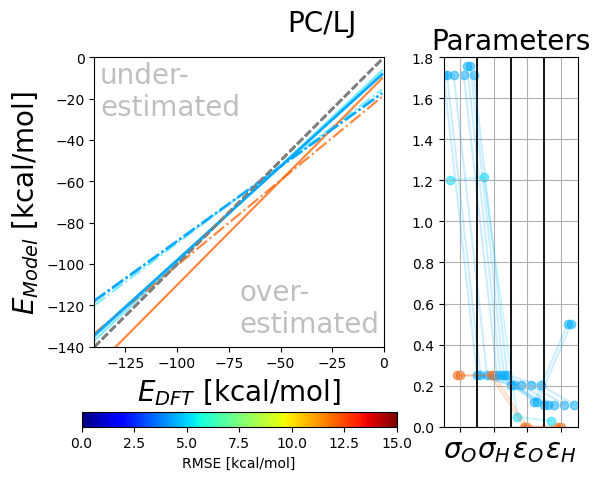

In [690]:
parm_plots(pc_jc_harm_stats, title="PC/LJ")
plt.savefig("PCLJ.png", bbox_inches="tight")

## exact

1.5990096878517222 1.2645195482283862
31.108246314677103


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


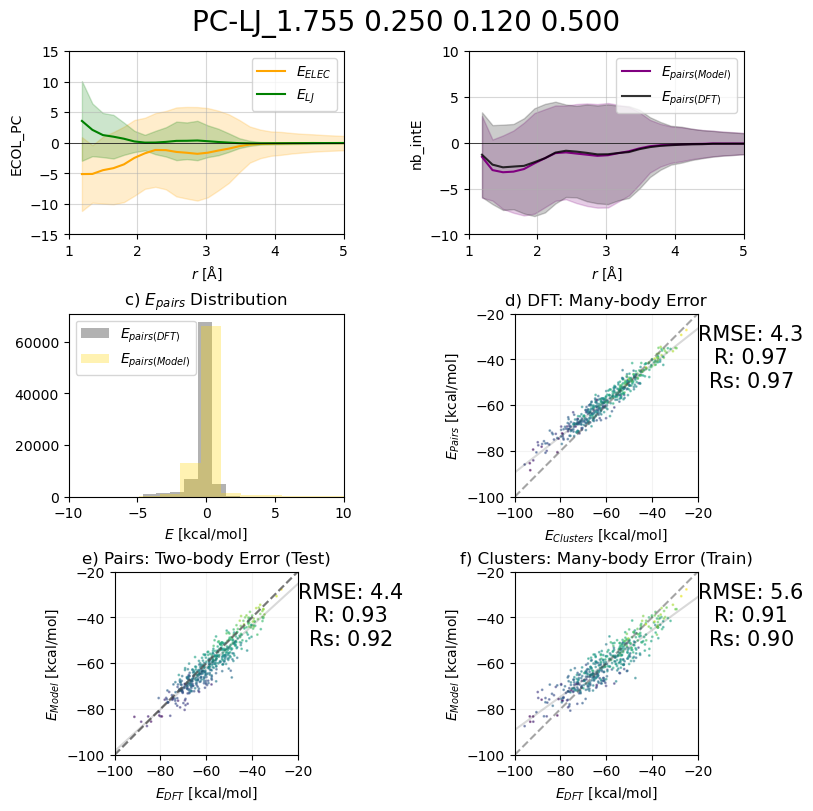

30.661358589007104


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


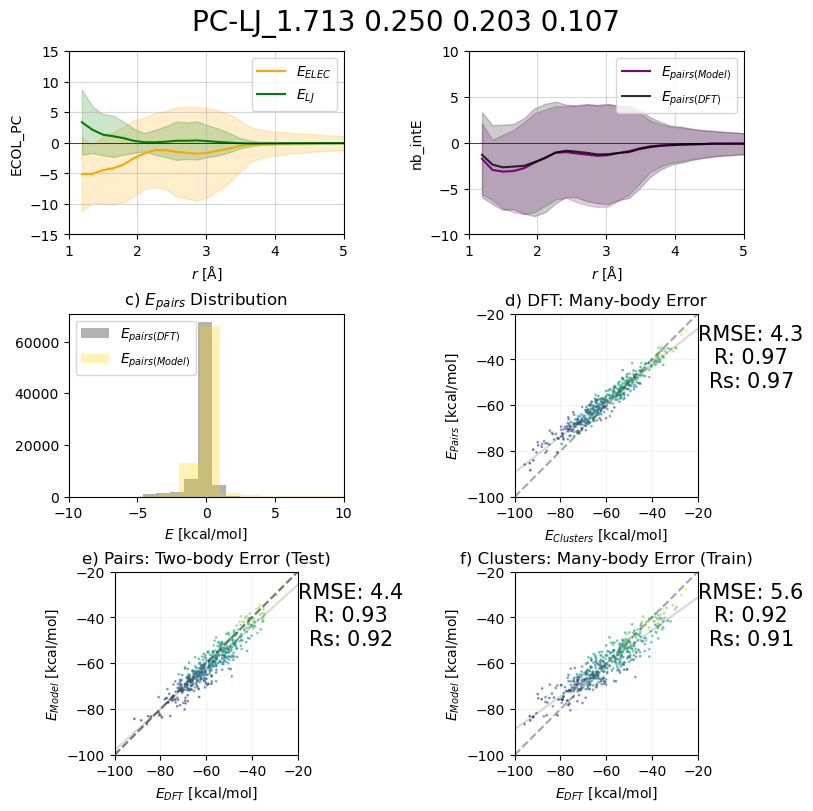

30.661358589007193


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


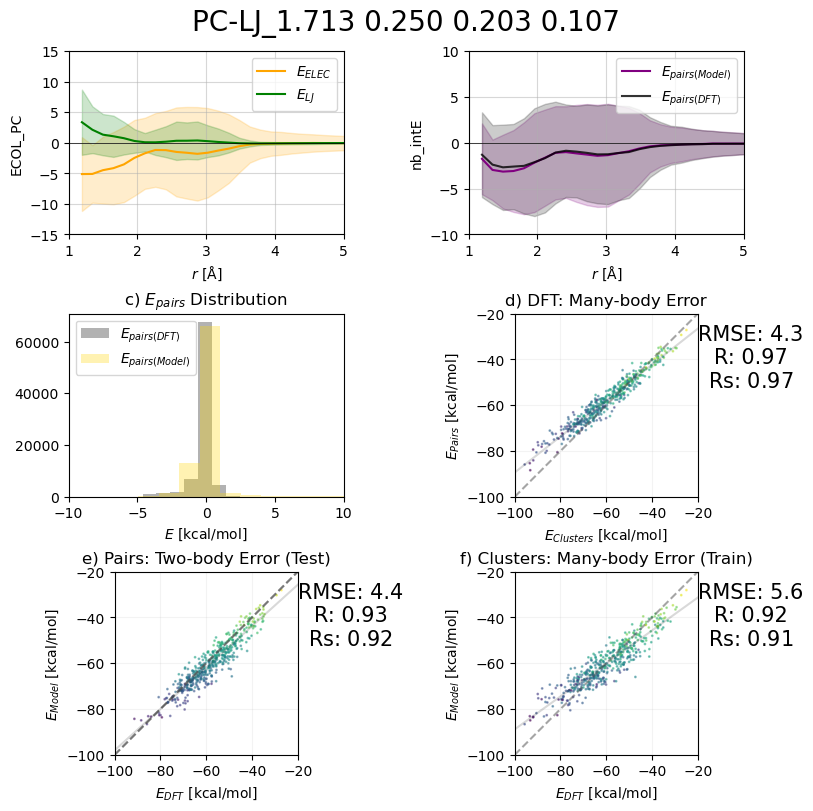

31.10824632603576


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


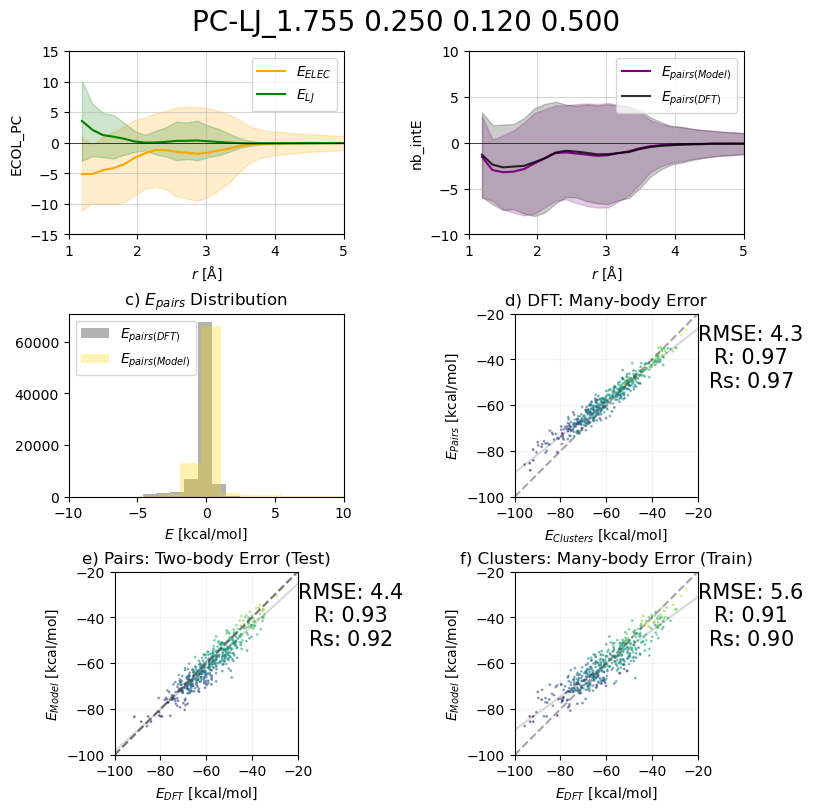

30.66135858901149


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


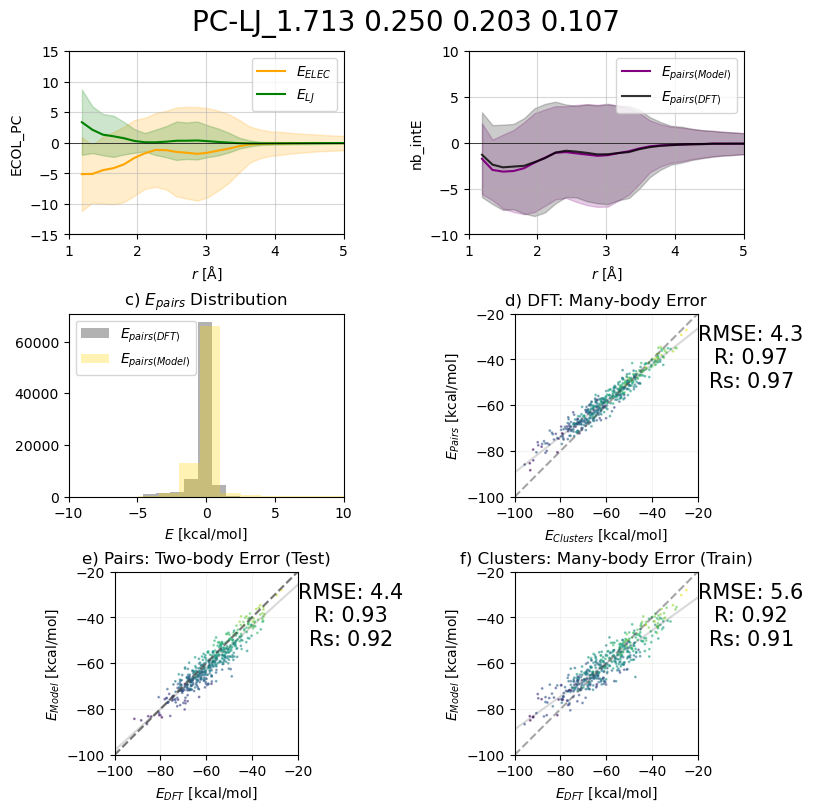

30.661358589007307


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


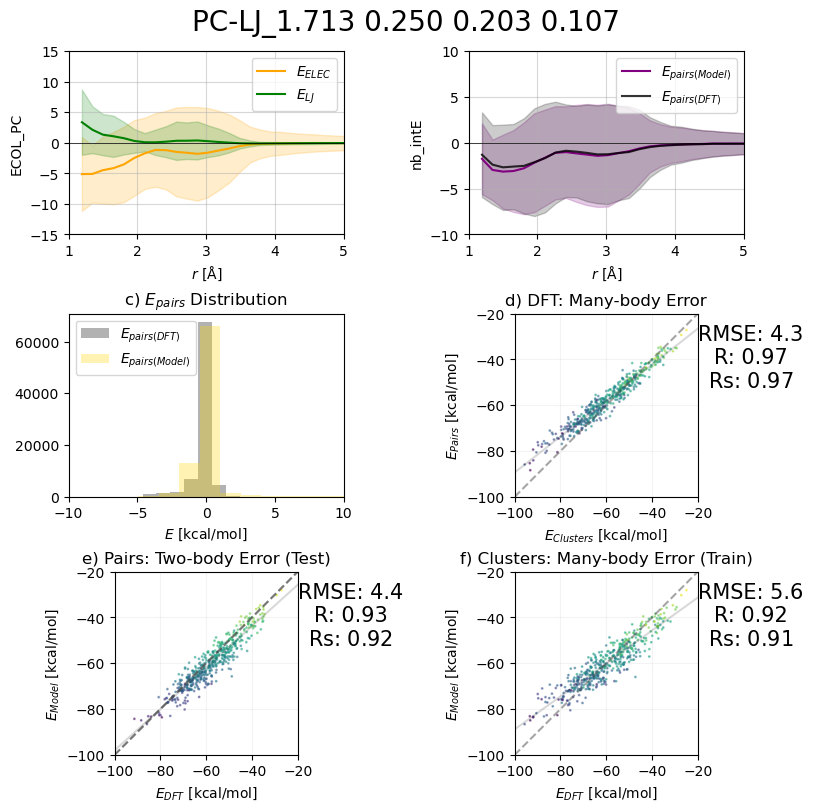

35.177411508881136


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


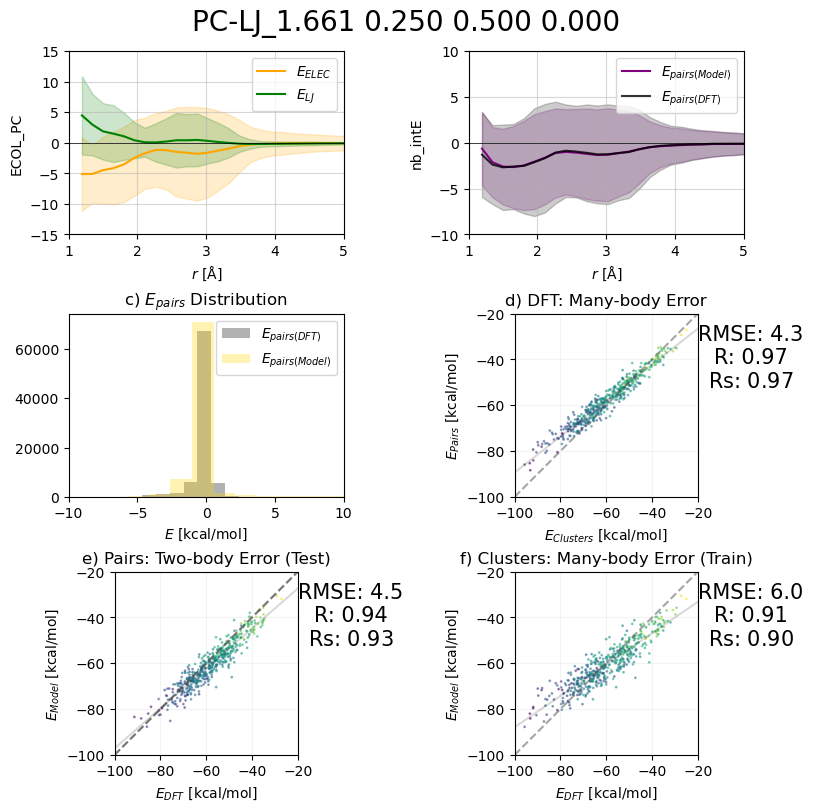

35.142004540655364


/tmp/ipykernel_835282/1637181137.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


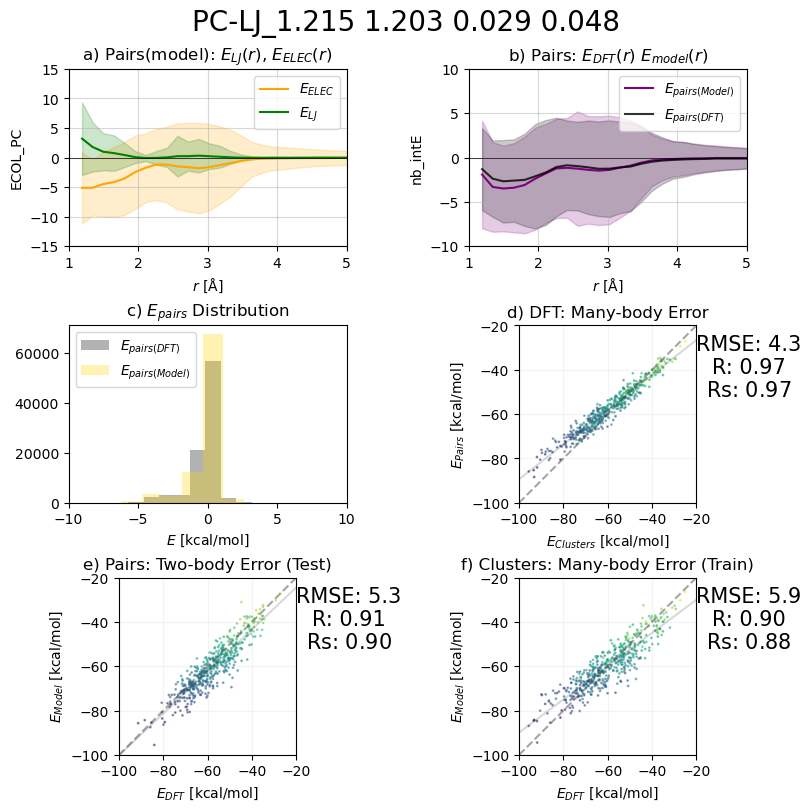

In [56]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit = next(read_from_pickle('pickles/pbe0_dz_pc_LJ_water_cluster_ELEC_Exact_ELEC.pkl'))
pc_de_exact_stats = plot_ff_fit(ff, ff_fit, ecol="ECOL_PC", EB=("sd", 3), suptitle="PC-LJ")

#  PC DE

1.599009687851722 1.2645195482283862
0
30.71684219731807


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


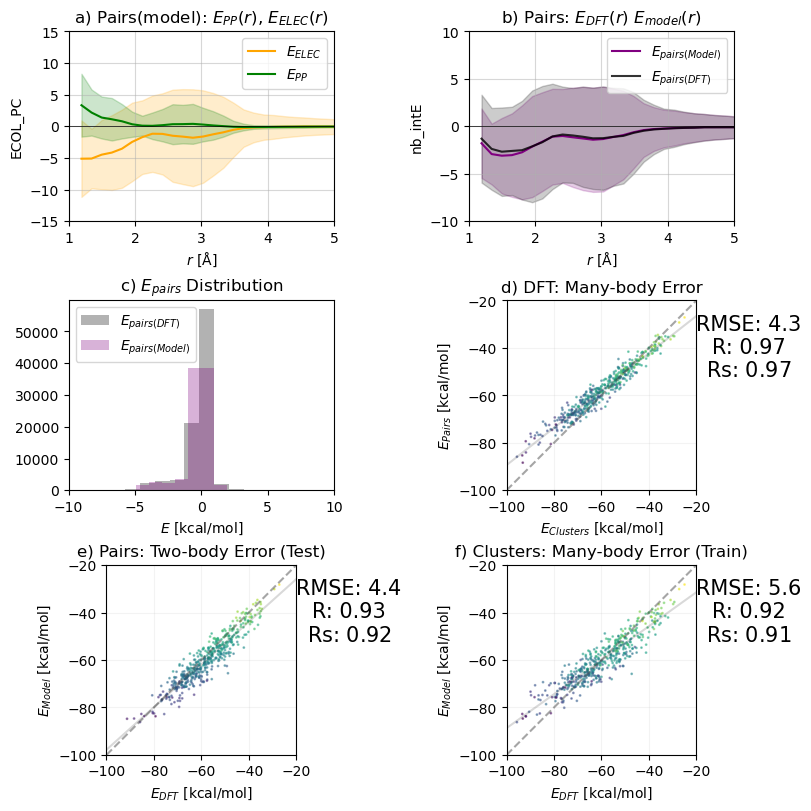

1
32.506433014502164


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


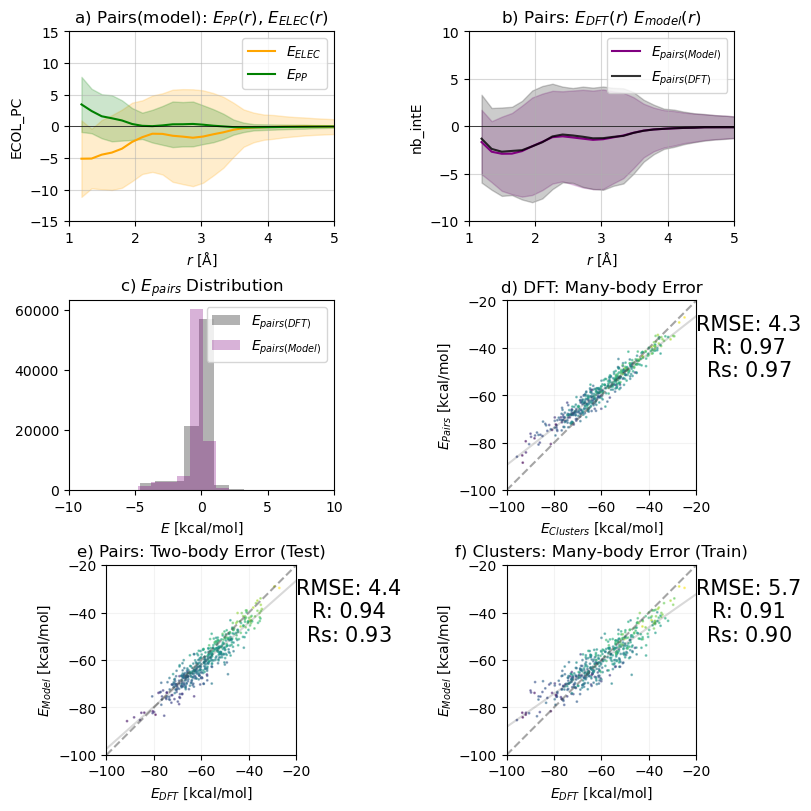

2
112.64023516647954


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


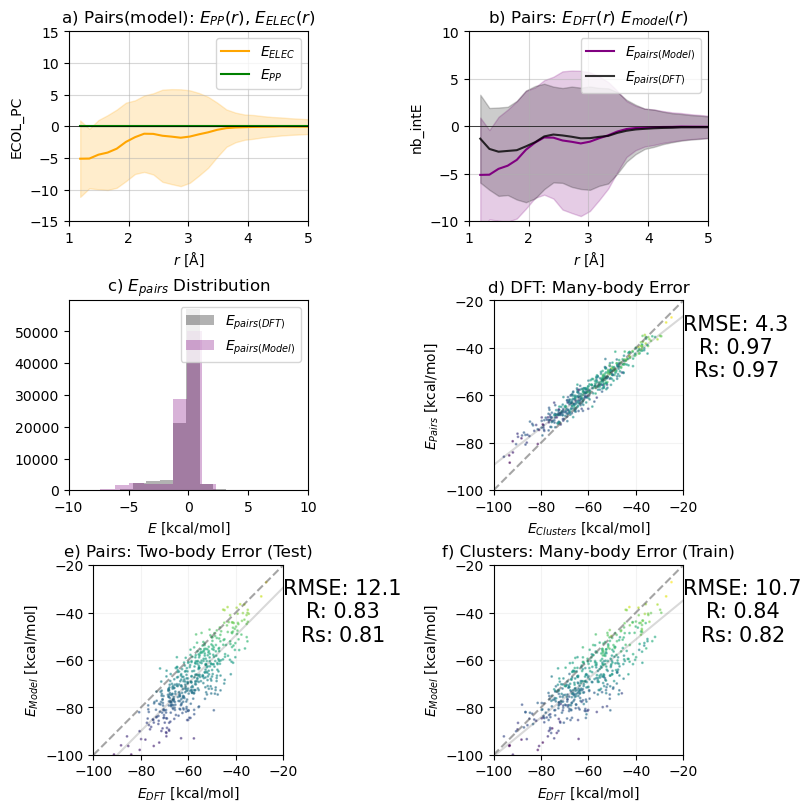

3
112.64023516647957


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


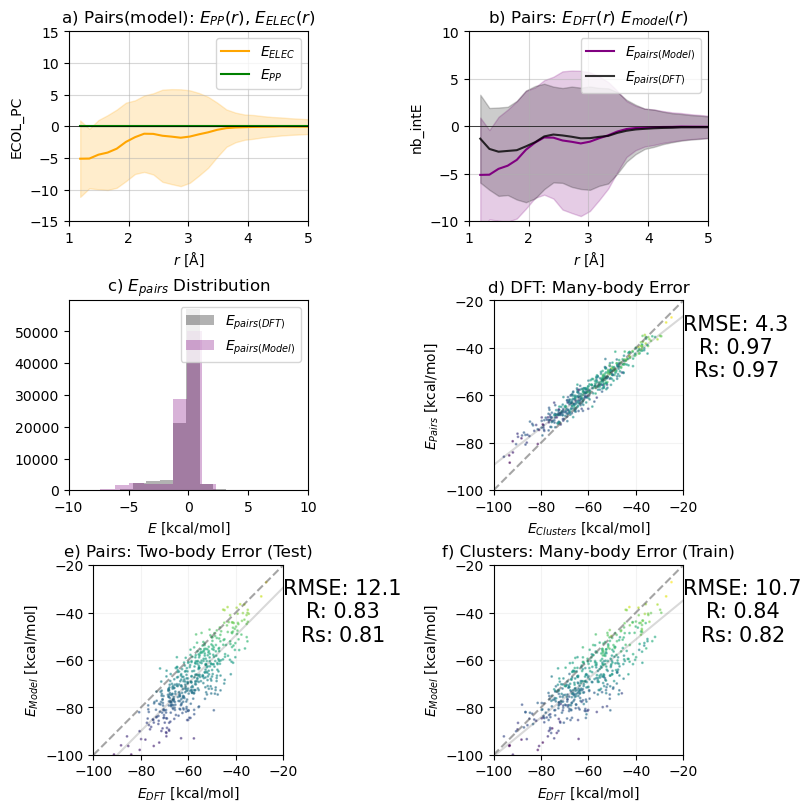

4
30.716842237775122


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


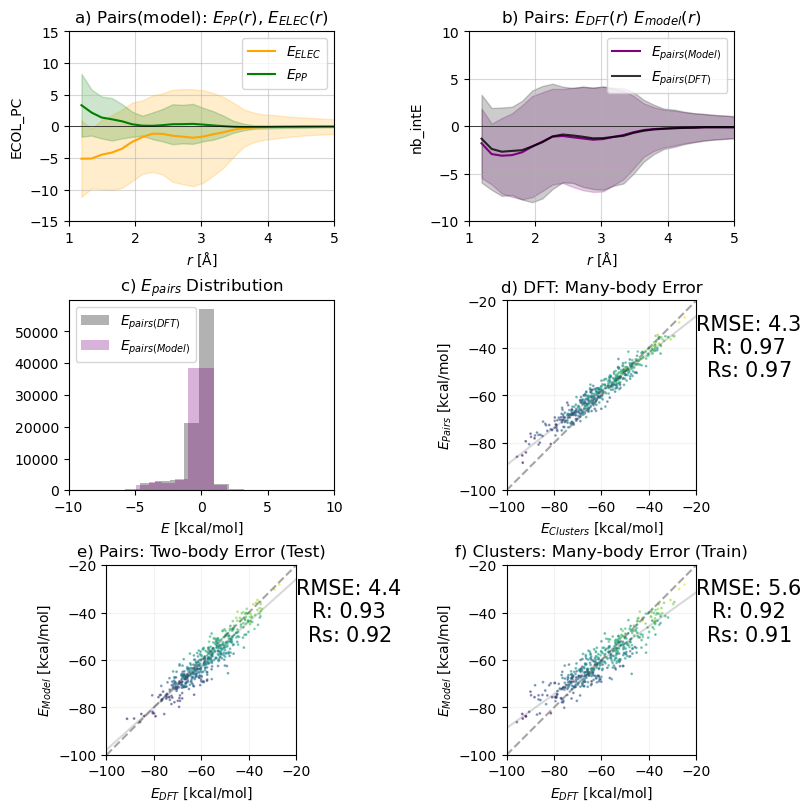

5
30.71684219731799


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


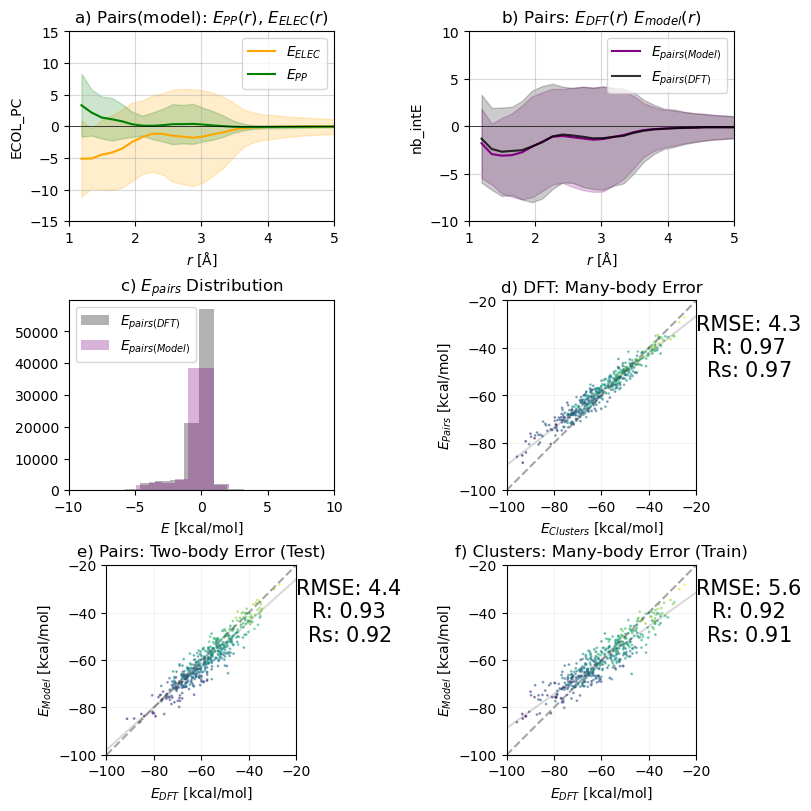

6
112.64023516647957


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


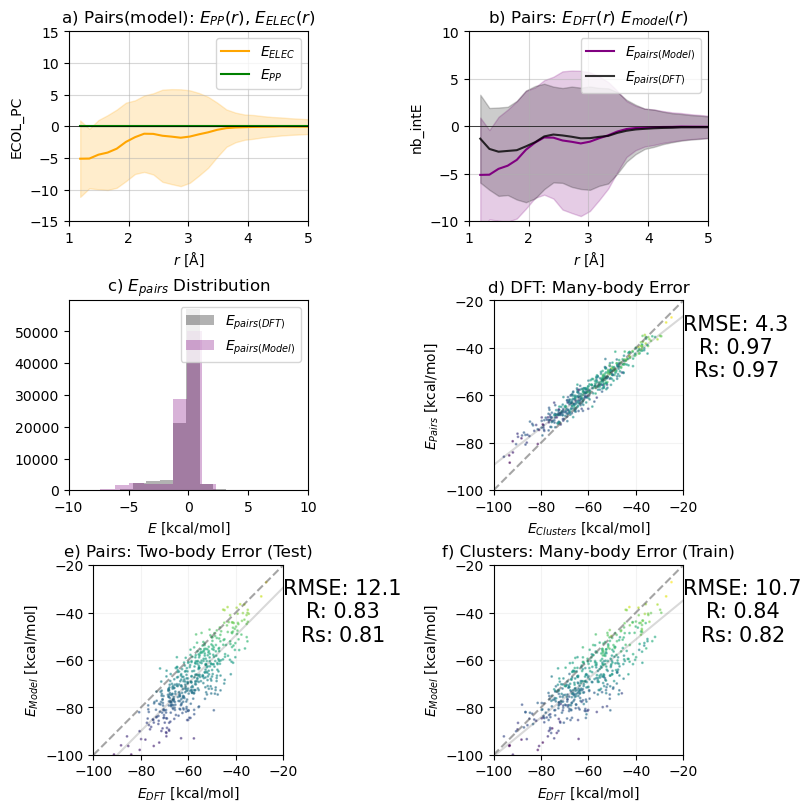

7
35.183543302419054


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


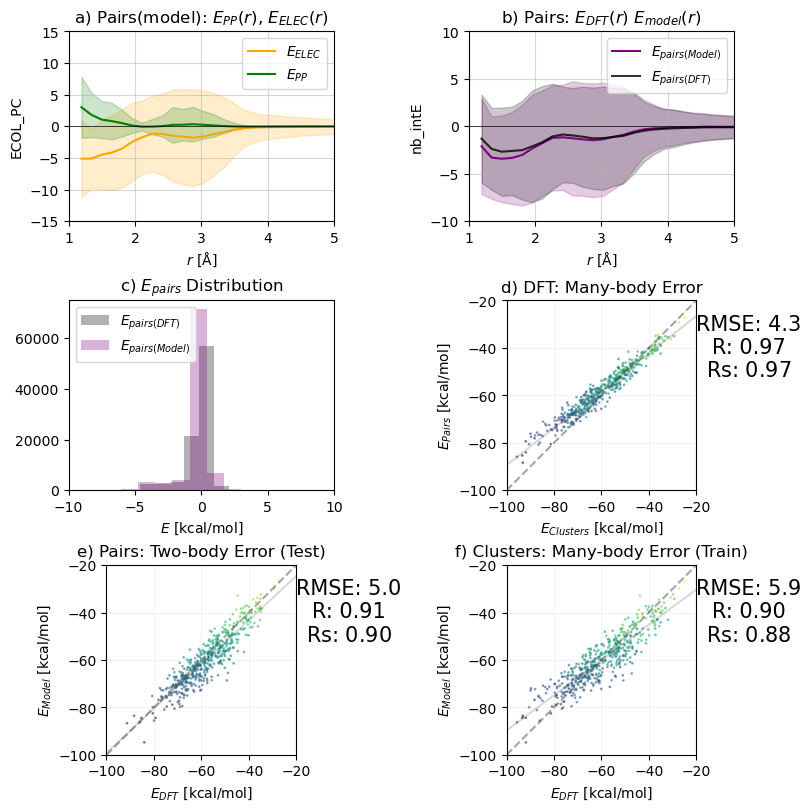

8
35.183383838099296


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


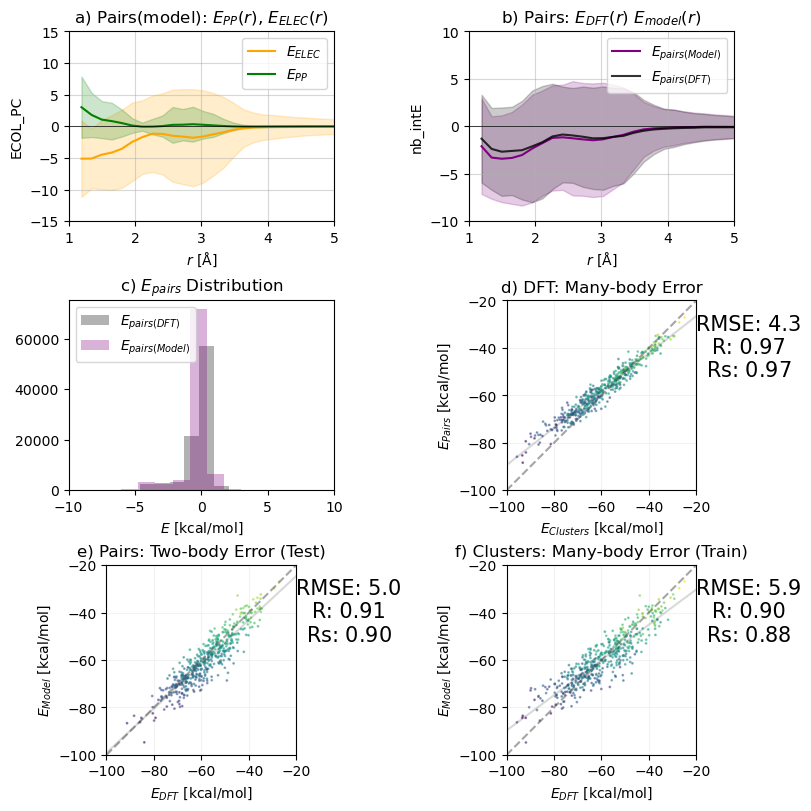

9
112.64023516647968


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


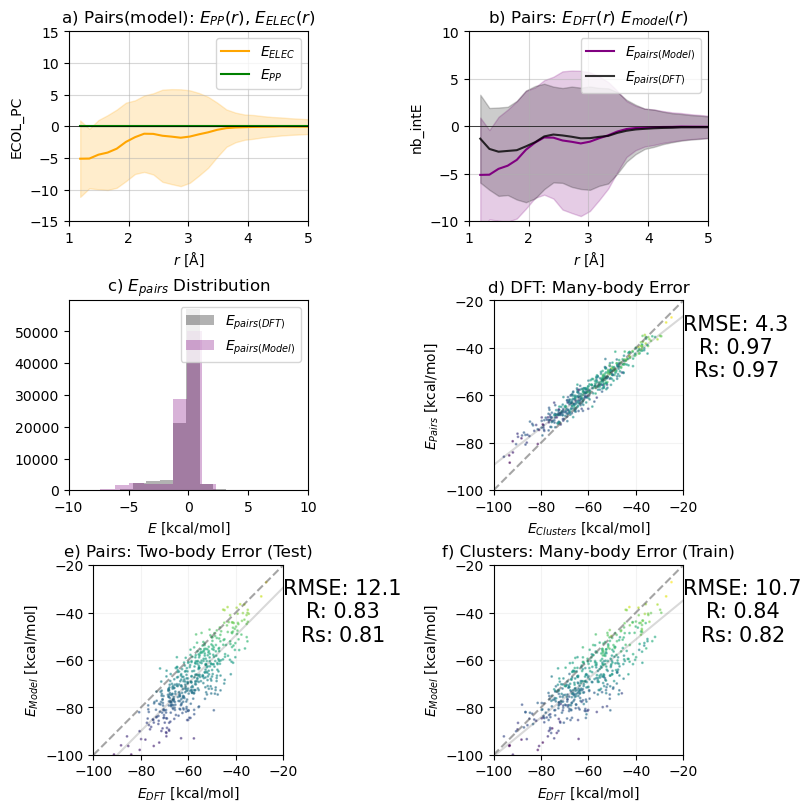

In [673]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit = next(read_from_pickle('pickles/pbe0_dz_pc_DE_water_cluster_ELEC_harmonic_ELEC.pkl'))
pc_de_harm_stats = plot_ff_fit(ff, ff_fit, ecol="ECOL_PC", EB=("sd", 3), suptitle="PC-DE")

In [501]:
pc_de_harm_stats

[[array([ 1.73236717,  0.25      ,  0.2220213 ,  0.12530532,  4.1401057 ,
         16.        ]),
  {'MSE': 19.08525844174554,
   'RMSE': 4.368667810871587,
   'R': 0.9335351273919045,
   'RS': 0.9240999424691347,
   'n': 470,
   'slope': 0.899066907594414,
   'intercept': -7.9192356708105365},
  {'MSE': 30.899179618166787,
   'RMSE': 5.55870305180685,
   'R': 0.9174582235247637,
   'RS': 0.9065598189525917,
   'n': 470,
   'slope': 0.7158627963165461,
   'intercept': -17.128026570643343}],
 [array([1.67899510e+00, 2.50000000e-01, 5.00000000e-01, 7.66832878e-03,
         8.96826499e+00, 8.96826522e+00]),
  {'MSE': 19.106491236298865,
   'RMSE': 4.3710972577030205,
   'R': 0.9354968580438474,
   'RS': 0.9266611206642722,
   'n': 470,
   'slope': 0.8855568768577309,
   'intercept': -8.82468518256455},
  {'MSE': 32.82429118568498,
   'RMSE': 5.729248745314256,
   'R': 0.9129129310832234,
   'RS': 0.9018874227010266,
   'n': 470,
   'slope': 0.7002039597223741,
   'intercept': -18.19562305

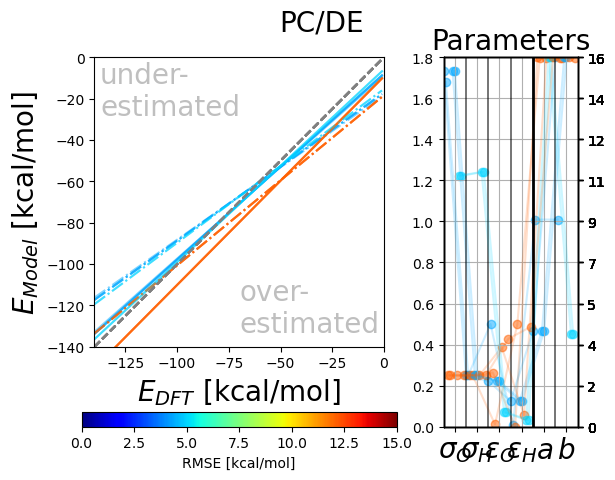

In [575]:
parm_plots(pc_de_harm_stats, title="PC/DE")

# kMDCM LJ

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


2.3182941512369415 1.5225945459106773
0
16.089194883937886


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


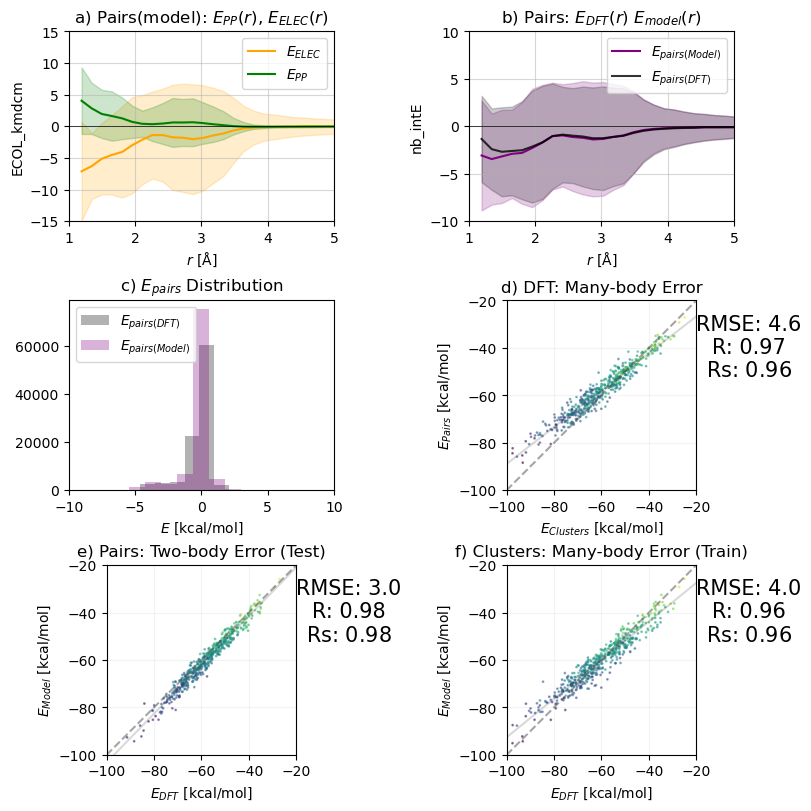

In [2]:
ff = next(read_from_pickle('ff_pc_pairs.pkl'))
ff_fit_kmdcm = next(read_from_pickle('pbe0_dz_kmdcm_LJ_water_cluster_ELEC_harmonic_ELEC.pkl'))
kmdcm_lj_harm_stats = plot_ff_fit(ff, ff_fit_kmdcm, ecol="ECOL_kmdcm",EB=("sd", 3), suptitle="kMDCM-LJ")

In [463]:
ff_fit_kmdcm = next(read_from_pickle('pbe0_dz_kmdcm_LJ_water_cluster_ELEC_harmonic_ELEC.pkl'))
ff_fit_kmdcm

FF: LJ

In [464]:
ff_fit_kmdcm.p

Array([1.764   , 0.25    , 0.1687  , 0.006871], dtype=float32)

In [465]:
ff_fit_kmdcm.atom_type_pairs

[('HT', 'HT'), ('HT', 'OT'), ('OT', 'OT')]

In [466]:
ff_fit_kmdcm.atom_types

['HT', 'OT']

In [467]:
import jax.numpy as jnp
# p = jnp.array( ff_fit_kmdcm.get_random_parm())
# p = jnp.array([1.764e+00 , 2.500e-01 , 1.687e-01 , 6.871e-03])
p = ff_fit_kmdcm.p
p

Array([1.764   , 0.25    , 0.1687  , 0.006871], dtype=float32)

In [468]:
parms =   jnp.array([2*p[1], p[0]+p[1], 2*p[0],
                       p[3], jnp.sqrt((p[2]*p[3])), p[2]])

In [469]:
import timeit

%timeit 
ff_fit_kmdcm.get_loss(p)

2217705.216

In [470]:
min(ff_fit_kmdcm.out_groups_dict.values())

0

In [471]:
# ff_fit_kmdcm.out_groups = ff_fit_kmdcm.out_akps

In [472]:
%timeit 
ff_fit_kmdcm.get_loss_jax(parms)

Array(31649.406, dtype=float32)

In [473]:
type(ff_fit_kmdcm.out_akps)
ff_fit_kmdcm.out_akps.shape

(855000,)

In [474]:
type(ff_fit_kmdcm.out_dists)
ff_fit_kmdcm.out_dists.shape

(855000,)

In [475]:
type(ff_fit_kmdcm.out_groups)
ff_fit_kmdcm.out_groups.shape

(855000,)

In [476]:
type(ff_fit_kmdcm.targets)
ff_fit_kmdcm.targets.shape

(500,)

In [477]:
from ff_energy.potential import LJRUN
# # dists, indexs, groups, parms
# LJRUN(ff_fit_kmdcm.out_dists, ff_fit_kmdcm.out_akps, ff_fit_kmdcm.out_groups, parms)


In [478]:
# p = jnp.array([ 2.500e-01 ,1.764e+00 ,  6.871e-03, 1.687e-01 ,])
parms =   jnp.array([2*p[1], p[0]+p[1], 2*p[0],
                       p[3], jnp.sqrt((p[2]*p[3])), p[2]])

res = ff_fit_kmdcm.eval_func(p)
res["jax"] = LJRUN(ff_fit_kmdcm.out_dists, ff_fit_kmdcm.out_akps, ff_fit_kmdcm.out_groups, parms)
# res["out_es"] = 
res

,LJ,jax
test467,895.6727,22.512337
test263,1965.0305,10.543934
test35,1319.5564,16.387897
test223,581.2646,7.111959
test254,1010.5317,14.344592
...,...,...
test100,794.01776,19.614714
test304,868.047,14.576603
test327,1740.55,27.400295
test185,1563.2157,22.760120


In [479]:
ff_fit_kmdcm.data

,ECOL,KEY,TOTAL,ELEC,VDW,KEY,M_ENERGY,KEY,n_monomers,C_ENERGY,n_pairs,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol,NBONDS,nb_intE,DUMMY,LJX
test467,-113.436686,test467,22.56645,-64.08560,14.82881,test467,-1527.154217,test467,20,-1527.236629,190,-51.714066,-50.297664,-958293.852586,-958295.211607,-958345.566652,-49.25679,-49.25679,0,12.371534
test263,-159.213355,test263,21.29141,-92.76477,20.54380,test263,-1527.156016,test263,20,-1527.258259,190,-64.157783,-66.601357,-958294.981314,-958296.144719,-958359.139096,-72.22097,-72.22097,0,28.606987
test35,-138.530827,test35,23.43646,-87.37824,11.05221,test35,-1527.143158,test35,20,-1527.258584,189,-72.430230,-65.790457,-958286.913137,-958288.376038,-958359.343368,-76.32603,-76.32603,0,14.948010
test223,-85.840765,test223,24.37323,-47.13218,6.72946,test223,-1527.147556,test223,20,-1527.203106,190,-34.857221,-39.243367,-958289.673128,-958290.449874,-958324.530348,-40.40272,-40.40272,0,12.274959
test254,-157.431989,test254,27.07465,-90.75359,21.85417,test254,-1527.135568,test254,20,-1527.237145,188,-63.739697,-57.830990,-958282.150371,-958283.041933,-958345.890067,-68.89942,-68.89942,0,27.013893
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
test100,-120.244324,test100,25.63059,-66.67887,19.45476,test100,-1527.141372,test100,20,-1527.210157,190,-43.162995,-42.125801,-958285.792204,-958287.528319,-958328.955198,-47.22411,-47.22411,0,23.515875
test304,-123.903711,test304,23.20412,-72.62700,17.28253,test304,-1527.150985,test304,20,-1527.239633,189,-55.626955,-54.710834,-958291.824384,-958293.116885,-958347.451339,-55.34447,-55.34447,0,17.000045
test327,-195.846922,test327,21.75196,-117.28678,31.12436,test327,-1527.154084,test327,20,-1527.300559,190,-91.913853,-79.340573,-958293.768884,-958295.335949,-958385.682737,-86.16242,-86.16242,0,25.372927
test185,-114.232038,test185,25.65796,-69.10066,11.20177,test185,-1527.144999,test185,20,-1527.232387,190,-54.835874,-54.451833,-958288.068584,-958289.053297,-958342.904458,-57.89889,-57.89889,0,14.264786


In [480]:
# ff_fit_kmdcm.data["intE"] - ff_fit_kmdcm.data["ELEC"]

In [ ]:
gg = []
for _ in ff_fit_kmdcm.out_groups:
    if _ not in gg:
        # print(_)
        gg.append(_)

In [358]:
ff_fit_kmdcm.out_es


Array([-2.4129232e-08, -2.4129232e-08, -3.8686006e-09, ...,
       -3.8794164e-02, -1.5319310e-01,  6.9698972e-01], dtype=float32)

In [359]:
from ff_energy.potential import LJflat

LJflat(ff_fit_kmdcm.out_dists, ff_fit_kmdcm.out_akps, parms)

Array([-2.4129232e-08, -2.4129232e-08, -3.8686006e-09, ...,
       -3.8794164e-02, -1.5319310e-01,  6.9698972e-01], dtype=float32)

In [424]:
ff_fit_kmdcm.data["k"] = [ff_fit_kmdcm.data.index.get_loc(g) for g in ff_fit_kmdcm.out_groups_dict.keys()]
ff_fit_kmdcm.data.sort_values("k")

,ECOL,KEY,TOTAL,ELEC,VDW,KEY,M_ENERGY,KEY,n_monomers,C_ENERGY,...,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol,NBONDS,nb_intE,DUMMY,LJX,k
test42,-119.370569,test42,23.38032,-67.54566,19.55018,test42,-1527.150801,test42,20,-1527.222463,...,-44.968051,-45.410713,-958291.709149,-958292.872125,-958336.677200,-47.99548,-47.99548,0,22.577609,0
test359,-122.818792,test359,26.07528,-68.95380,20.03015,test359,-1527.147272,test359,20,-1527.228209,...,-50.788148,-50.051119,-958289.494791,-958290.474407,-958340.282939,-48.92365,-48.92365,0,18.165652,1
test274,-173.341913,test274,27.36238,-100.38012,26.45322,test274,-1527.134561,test274,20,-1527.244093,...,-68.731414,-57.877601,-958281.518632,-958281.717963,-958350.250046,-73.92690,-73.92690,0,31.648706,2
test315,-123.876123,test315,25.65890,-75.75144,14.43330,test315,-1527.140043,test315,20,-1527.238871,...,-62.015299,-55.357598,-958284.958152,-958286.869104,-958346.973451,-61.31814,-61.31814,0,13.736141,3
test212,-149.579171,test212,27.03099,-91.08725,14.31709,test212,-1527.135323,test212,20,-1527.262352,...,-79.710922,-73.645596,-958281.996551,-958281.945050,-958361.707473,-76.77016,-76.77016,0,11.376328,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
test173,-130.777771,test173,25.11380,-72.89808,13.97164,test173,-1527.144547,test173,20,-1527.225046,...,-50.513483,-55.577317,-958287.784638,-958288.115042,-958338.298122,-58.92644,-58.92644,0,22.384597,495
test40,-90.359303,test40,25.51207,-51.71064,9.79755,test40,-1527.143692,test40,20,-1527.203482,...,-37.518279,-40.441823,-958287.248048,-958288.171722,-958324.766327,-41.91309,-41.91309,0,14.192361,496
test422,-155.228404,test422,26.32312,-82.60048,25.43890,test422,-1527.143977,test422,20,-1527.223067,...,-49.628917,-51.398996,-958287.427037,-958288.605707,-958337.055954,-57.16158,-57.16158,0,32.971563,497
test187,-146.219445,test187,24.56784,-88.46133,18.66478,test187,-1527.145408,test187,20,-1527.260730,...,-72.365359,-66.079697,-958288.324693,-958289.760756,-958360.690052,-69.79655,-69.79655,0,16.095971,498


In [313]:
ff_fit_kmdcm.out_es

Array([-0.22966844, -0.22966844, -0.0625837 , ..., -0.12917355,
       -0.13253906, 12.001985  ], dtype=float32)

In [410]:
jax.ops.segment_sum(ff_fit_kmdcm.out_es, 
                    ff_fit_kmdcm.out_groups, 
                    num_segments=500,
                    indices_are_sorted=False,
                   unique_indices=False)

Array([22.512337  , 10.543934  , 16.387897  ,  7.1119585 , 14.344594  ,
       15.048473  , 21.961836  , 19.992865  , 13.731377  , 21.983294  ,
       10.113796  , 22.927408  , 16.358564  , 24.15661   , 24.18476   ,
       17.647406  , 26.318127  , 27.765566  , 25.40813   , 29.78242   ,
       28.301079  , 24.550009  , 33.18873   , 21.809769  , 22.532803  ,
       20.301237  , 13.519656  , 12.475     ,  5.4312577 , 19.306637  ,
       14.471676  , 18.470858  , 14.513791  , 23.864376  ,  9.806498  ,
       12.926987  , 24.250269  , 12.041277  , 19.236914  , 13.830275  ,
       11.374668  , 18.030622  , 21.330248  , 11.899595  ,  9.080708  ,
       10.514051  , 11.092088  , 11.212343  , 21.74763   , 17.776922  ,
       13.67048   , 15.773021  , 17.734058  , 26.235455  , 14.844851  ,
       13.23117   , 11.398865  , 14.927198  , 18.572046  , 23.940044  ,
       26.822107  , 30.447315  , 15.368901  , 19.406683  , 11.581314  ,
       29.165728  , 16.123325  , 14.615199  , 22.944725  , 12.48

In [387]:
import jax
jax.ops.segment_sum(LJflat(ff_fit_kmdcm.out_dists, ff_fit_kmdcm.out_akps, parms), 
                    ff_fit_kmdcm.out_groups, 
                    num_segments=500,
                    indices_are_sorted=True)

Array([22.512337  , 10.543934  , 16.387897  ,  7.1119585 , 14.344592  ,
       15.048473  , 21.961836  , 19.992865  , 13.731377  , 21.983295  ,
       10.113797  , 22.927408  , 16.358564  , 24.15661   , 24.18476   ,
       17.647408  , 26.318125  , 27.765568  , 25.40813   , 29.78242   ,
       28.30108   , 24.550013  , 33.18873   , 21.809769  , 22.5328    ,
       20.301237  , 13.519655  , 12.474998  ,  5.431258  , 19.306637  ,
       14.471677  , 18.470858  , 14.513791  , 23.864376  ,  9.806498  ,
       12.926988  , 24.250269  , 12.041278  , 19.236912  , 13.830276  ,
       11.374669  , 18.030624  , 21.330248  , 11.899595  ,  9.0807085 ,
       10.5140505 , 11.092088  , 11.212343  , 21.74763   , 17.776924  ,
       13.67048   , 15.773021  , 17.734058  , 26.235455  , 14.844852  ,
       13.23117   , 11.398864  , 14.9271965 , 18.572046  , 23.940042  ,
       26.822107  , 30.447315  , 15.368901  , 19.406685  , 11.581314  ,
       29.165728  , 16.123325  , 14.615199  , 22.944725  , 12.48

In [93]:
ff_fit_kmdcm.out_groups

Array([467, 467, 467, ...,  66,  66,  66], dtype=int32)

In [37]:
jnp.take(p, ff_fit_kmdcm.out_akps, unique_indices=False)

Array([1.1696999 , 1.1696999 , 1.1696999 , ..., 0.25423682, 0.25423682,
       0.25423682], dtype=float32)

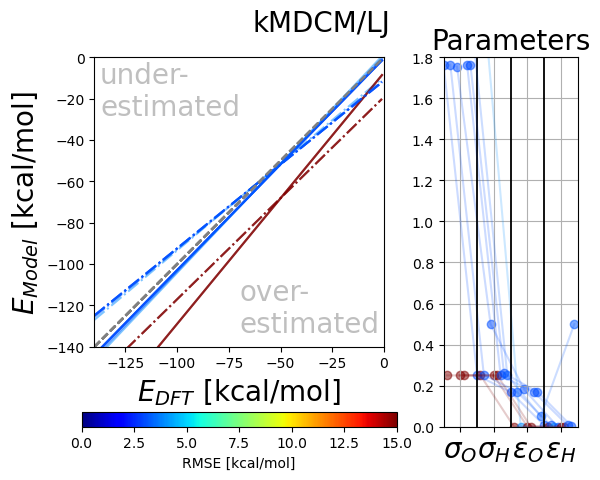

In [693]:
parm_plots(kmdcm_lj_harm_stats, title="kMDCM/LJ")
plt.savefig("kMDCMLJ.png", bbox_inches="tight")

In [565]:
ff_fit_kmdcm.data.mean()

/tmp/ipykernel_835282/2215461409.py:1: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  ff_fit_kmdcm.data.mean()


ECOL                  -133.827185
TOTAL                   22.381426
ELEC                   -67.859102
VDW                     16.144373
M_ENERGY             -1527.146302
n_monomers              20.000000
C_ENERGY             -1527.242271
n_pairs                189.504000
intE                   -60.220800
P_intE                 -57.976652
m_E_tot            -958288.886029
p_m_E_tot          -958289.978786
C_ENERGY_kcalmol   -958349.106829
NBONDS                 -51.714729
nb_intE                -51.714729
n                      249.500000
epol_mike             -148.453094
DUMMY                    0.000000
LJX                      7.638302
dtype: float64

## exact

2.3182941512369415 1.5225945459106773
0
16.089194851264615


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


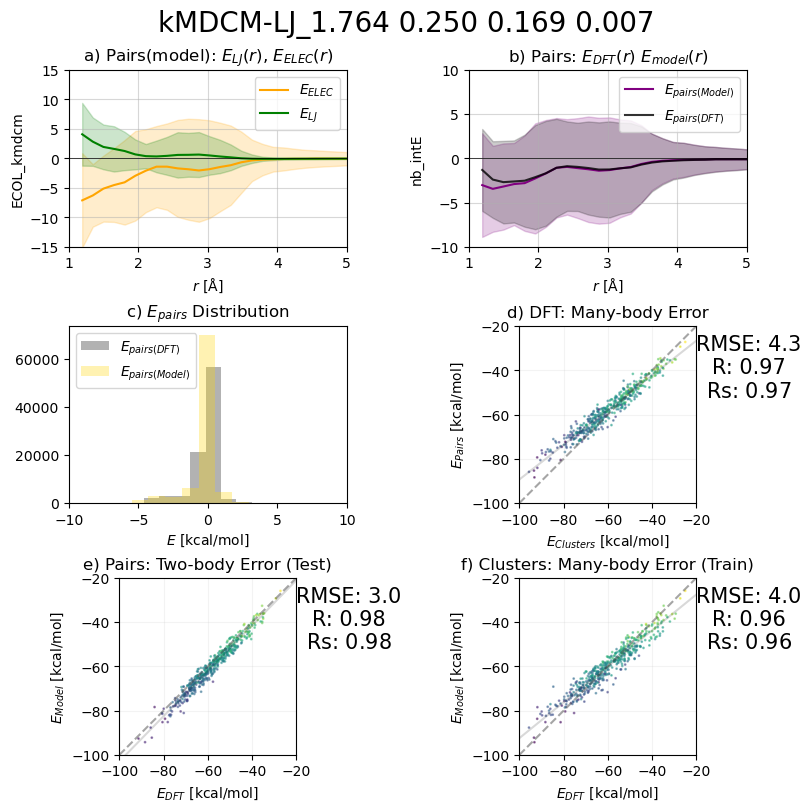

In [539]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_kmdcm = next(read_from_pickle('pickles/pbe0_dz_kmdcm_LJ_water_cluster_ELEC_Exact_ELEC.pkl'))
kmdcm_lj_exact_stats = plot_ff_fit(ff, ff_fit_kmdcm, ecol="ECOL_kmdcm",EB=("sd", 3), suptitle="kMDCM-LJ")

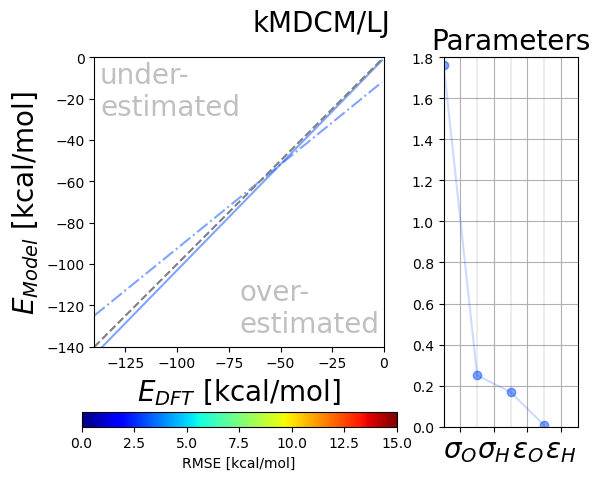

In [577]:
parm_plots(kmdcm_lj_exact_stats, title="kMDCM/LJ")

In [62]:
pc_pbe0_dz.coloumb.index = pc_pbe0_dz.coloumb["KEY"].apply(lambda x: x.split(".")[0])
pc_pbe0_dz.coloumb

,ECOL,KEY
KEY,,
test467_1_2,-0.098394,test467_1_2.py
test467_1_3,-0.059956,test467_1_3.py
test467_1_4,-6.949478,test467_1_4.py
test467_1_5,0.314807,test467_1_5.py
test467_1_6,-1.04799,test467_1_6.py
...,...,...
test66_6_13,-0.119866,test66_6_13.py
test66_2_14,-0.107737,test66_2_14.py
test66_2_16,0.021253,test66_2_16.py


# Correlation


In [64]:
ECOLDF = pd.merge(pc_pbe0_dz.coloumb, ff.data, left_index=True, right_index=True)

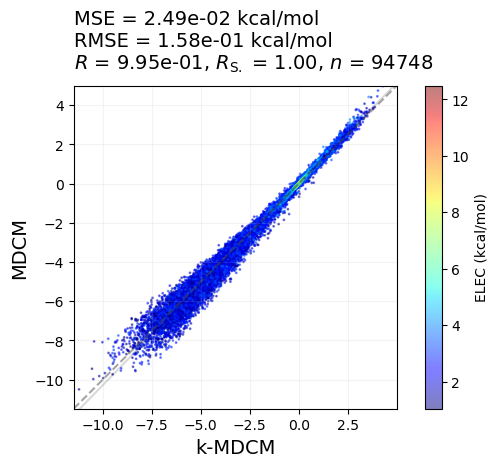

In [65]:
ax, cbar, data = plot_energy_MSE(ECOLDF, "ECOL_kmdcm", 
                "ECOL_mdcm", 
                xlabel="k-MDCM",
                ylabel="MDCM",
                bootstrap=False, 
                CMAP="jet",
                elec="min_hbond")
# cbar.set_clim(0,2)

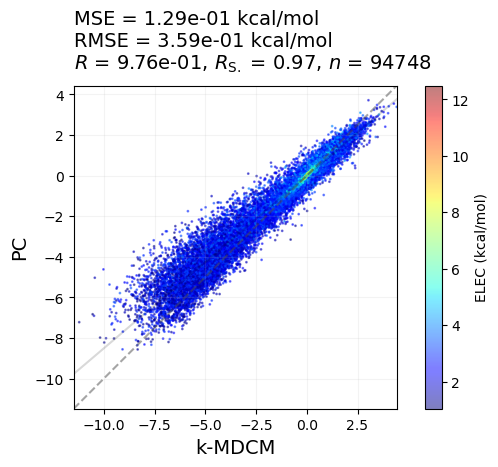

In [66]:
ax, cbar, data = plot_energy_MSE(ECOLDF, "ECOL_kmdcm", 
                "ECOL_PC", 
                xlabel="k-MDCM",
                ylabel="PC",
                bootstrap=False, 
                CMAP="jet",
                elec="min_hbond")

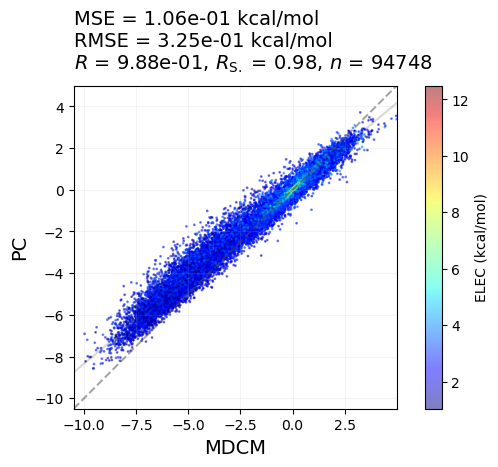

In [67]:
ax, cbar, data = plot_energy_MSE(ECOLDF, "ECOL_mdcm", 
                "ECOL_PC", 
                xlabel="MDCM",
                ylabel="PC",
                bootstrap=False, 
                CMAP="jet",
                elec="min_hbond")

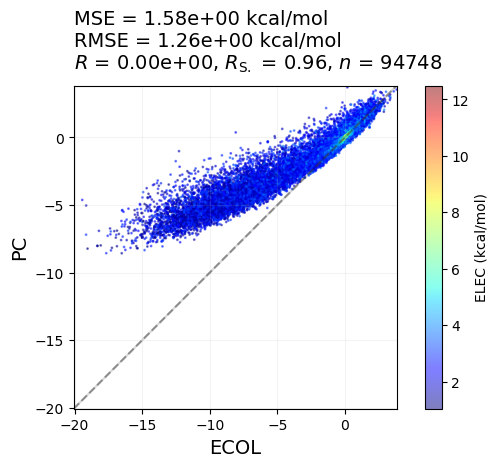

In [278]:
ax, cbar, data = plot_energy_MSE(ECOLDF, "ECOL", 
                "ECOL_PC", 
                xlabel="ECOL",
                ylabel="PC",
                bootstrap=False, 
                CMAP="jet",
                elec="min_hbond")

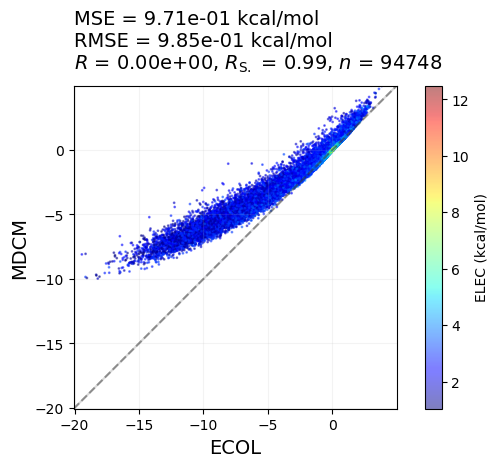

In [279]:
ax, cbar, data = plot_energy_MSE(ECOLDF, "ECOL", 
                "ECOL_mdcm", 
                xlabel="ECOL",
                ylabel="MDCM",
                bootstrap=False, 
                CMAP="jet",
                elec="min_hbond")

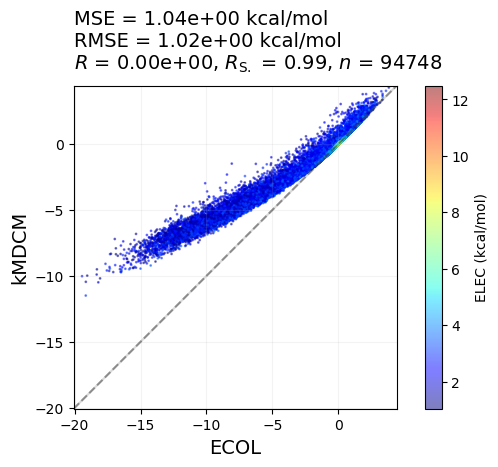

In [80]:
ax, cbar, data = plot_energy_MSE(ECOLDF, "ECOL", 
                "ECOL_kmdcm", 
                xlabel="ECOL",
                ylabel="kMDCM",
                bootstrap=False, 
                CMAP="jet",
                elec="min_hbond")

# distance dependence

In [149]:
ECOLDF.keys()

Index(['ECOL', 'KEY', 'p_ENERGY', 'p_m1_ENERGY', 'p_m2_ENERGY', 'p_int_ENERGY',
       'key', 'pair', 'ECOL_PC', 'angle_1', 'angle_2', 'dih', 'theta',
       'distance', 'min_hbond', 'dcms', 'ECOL_kmdcm', 'ECOL_mdcm', 'intE',
       'LJ', 'nb_intE', 'SE', 'min_hbond_bin'],
      dtype='object')

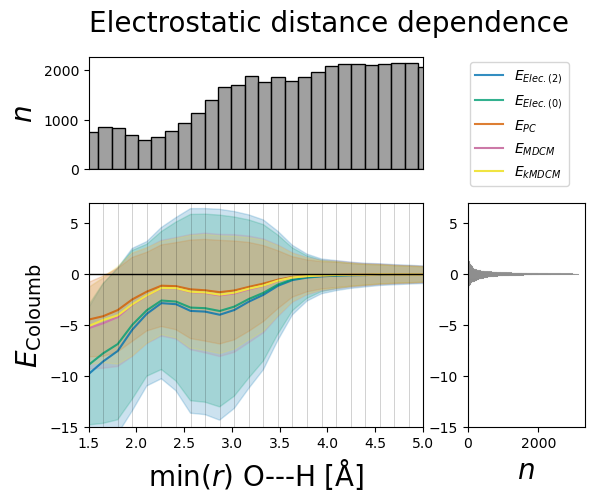

In [281]:
# with plt.style.context("Solarize_Light2"):
# with plt.style.context("ggplot"):
with plt.style.context("seaborn-v0_8-colorblind"):
    plt.rcParams['figure.facecolor'] = 'white'
    axd = plt.figure(layout=None).subplot_mosaic(
        """
        aX
        cb
        """,
        # set the height ratios between the rows
        height_ratios=[0.5, 1],
        # set the width ratios between the columns
        width_ratios=[1,0.35],
        empty_sentinel="X",
        # sharex=,
    )
    EB = ("sd", 2)

    sns.lineplot(x="min_hbond_bin", y="epol_mike", data=ff.data, 
                 errorbar=EB,
                 # color="yellow",
                 alpha=0.8,
                 ax=axd['c'],
                 label="$E_{Elec.(2)}}$"
                )
    sns.lineplot(x="min_hbond_bin", y="ECOL", data=ECOLDF, 
                 errorbar=EB,
                 # color="red",
                 alpha=0.8,
                 ax=axd['c'],
                 label="$E_{Elec.(0)}$"
                )
    sns.lineplot(x="min_hbond_bin", y="ECOL_PC", data=ECOLDF, 
                 errorbar=EB,
                 # color="lightblue",
                 alpha=0.8,
                 ax=axd['c'],
                 label="$E_{PC}$"
                )

    sns.lineplot(x="min_hbond_bin", y="ECOL_mdcm", data=ECOLDF, 
                 errorbar=EB,
                 # color="darkblue",
                 # alpha=0.8,
                 ax=axd['c'],
                 label="$E_{MDCM}$"
                )

    sns.lineplot(x="min_hbond_bin", y="ECOL_kmdcm", data=ECOLDF, 
                 errorbar=EB,
                 # color="black",
                 # alpha=0.8,
                 ax=axd['c'],
                 label="$E_{kMDCM}$"
                )
    
    sns.move_legend(axd['c'], "upper left", bbox_to_anchor=(1.12, 1.66))

    axd['c'].axhline(0, c="k", linewidth=1)
#     plt.legend(fontsize=20,
#                # facecolor='gray', 
#                framealpha=0.5,
#                labelcolor="black")
    
    for _ in set(ECOLDF["min_hbond_bin"]):
        ax=axd['c'].axvline(_, c="k", alpha=0.25, linewidth=0.5)
    
    axd['c'].set_xlabel("min($r$) O---H [$\\mathrm{\\AA}$]", fontsize=20)
    axd['c'].set_ylabel("$E_{\mathrm{Coloumb}}$", fontsize=20)
    axd['c'].set_xlim(1.5,5)
    axd['a'].set_xlim(1.5,5)
    axd['a'].set_xticks([])
    axd['c'].set_ylim(-15,7)
    axd['b'].set_ylim(-15,7)
    sns.histplot(ECOLDF["min_hbond"], ax=axd['a'], color="gray")
    axd['a'].set_ylabel("$n$", fontsize=20)
    sns.histplot(y=ECOLDF["ECOL"], ax=axd["b"], color="gray")
    axd['b'].set_ylabel("", fontsize=20)
    axd['b'].set_xlabel("$n$", fontsize=20)
    plt.suptitle("Electrostatic distance dependence",fontsize=20)
    plt.savefig("ele_dist_dep.pdf", bbox_inches="tight")

In [226]:
ECOLDF

,ECOL,KEY,p_ENERGY,p_m1_ENERGY,p_m2_ENERGY,p_int_ENERGY,key,pair,ECOL_PC,angle_1,...,distance,min_hbond,dcms,ECOL_kmdcm,ECOL_mdcm,intE,LJ,nb_intE,SE,min_hbond_bin
test467_1_2,-0.098394,test467_1_2.py,-152.714095,-76.356498,-76.357394,-0.000203,test467,"(1, 2)",-0.137087,16.323345,...,5.337078,4.005975,"[[[-2.1913, 1.5163, -2.8586], [-1.9395, 1.5654...",-0.100174,-0.108479,-0.127578,-0.020156,-0.120330,5.252775e-05,4.092565
test467_1_3,-0.059956,test467_1_3.py,-152.715701,-76.356498,-76.359083,-0.000120,test467,"(1, 3)",-0.023579,22.979674,...,5.595071,5.866752,"[[[-2.1913, 1.5163, -2.8586], [-1.9395, 1.5654...",-0.053055,-0.057511,-0.075275,-0.015061,-0.068116,5.125598e-05,5.924005
test467_1_4,-6.949478,test467_1_4.py,-152.723089,-76.356498,-76.359402,-0.007189,test467,"(1, 4)",-3.352849,13.185760,...,2.890089,2.052007,"[[[-2.1913, 1.5163, -2.8586], [-1.9395, 1.5654...",-4.867253,-4.665898,-4.510812,0.283866,-4.583387,5.267167e-03,2.108503
test467_1_5,0.314807,test467_1_5.py,-152.711647,-76.356498,-76.355286,0.000137,test467,"(1, 5)",-0.089464,29.311123,...,4.026605,3.245159,"[[[-2.1913, 1.5163, -2.8586], [-1.9395, 1.5654...",0.309404,0.343165,0.085949,-0.132730,0.176673,8.230868e-03,3.329464
test467_1_6,-1.04799,test467_1_6.py,-152.715755,-76.356498,-76.357342,-0.001915,test467,"(1, 6)",-0.982835,26.126546,...,4.234386,4.556229,"[[[-2.1913, 1.5163, -2.8586], [-1.9395, 1.5654...",-0.977621,-1.052712,-1.201587,-0.136687,-1.114308,7.617574e-03,4.703045
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
test66_6_13,-0.119866,test66_6_13.py,-152.710780,-76.355825,-76.354763,-0.000192,test66,"(6, 13)",-0.133966,54.106562,...,8.471257,8.314424,"[[[2.3157, 1.6041, -4.045], [2.6353, 1.8608, -...",-0.119154,-0.135632,-0.120675,-0.001931,-0.121086,1.685074e-07,8.365927
test66_2_14,-0.107737,test66_2_14.py,-152.711776,-76.352639,-76.358945,-0.000191,test66,"(2, 14)",-0.099709,18.605523,...,5.713764,5.904456,"[[[3.2753, -1.3882, -7.4], [3.0284, -1.591, -6...",-0.103903,-0.107323,-0.120066,-0.012546,-0.116450,1.308182e-05,5.924005
test66_2_16,0.021253,test66_2_16.py,-152.711349,-76.352639,-76.358740,0.000030,test66,"(2, 16)",0.009388,21.667782,...,7.528648,7.313374,"[[[3.2753, -1.3882, -7.4], [3.0284, -1.591, -6...",0.021698,0.020629,0.018524,-0.002727,0.018971,2.001297e-07,7.450206
test66_7_15,-0.018651,test66_7_15.py,-152.711233,-76.357956,-76.353240,-0.000037,test66,"(7, 15)",-0.012647,57.225666,...,6.905748,5.241342,"[[[-1.9581, -3.1501, 0.3111], [-1.4073, -3.301...",-0.018019,-0.021800,-0.023280,-0.004564,-0.022582,4.870648e-07,5.313525


#  kMDCM DE

2.3182941512369415 1.5225945459106773
0
16.083692603542058


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


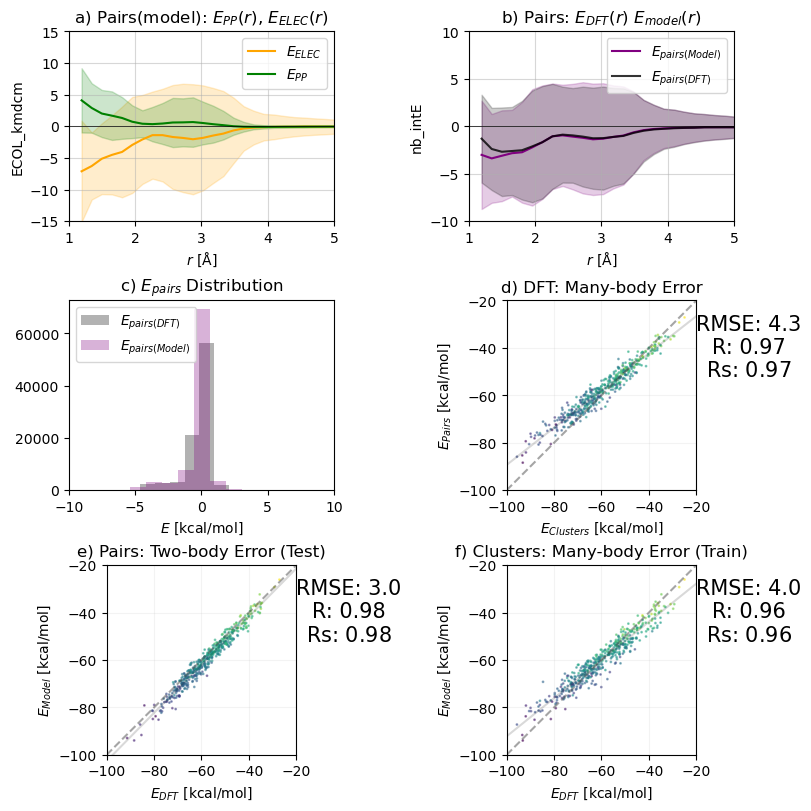

1
16.14423123491609


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


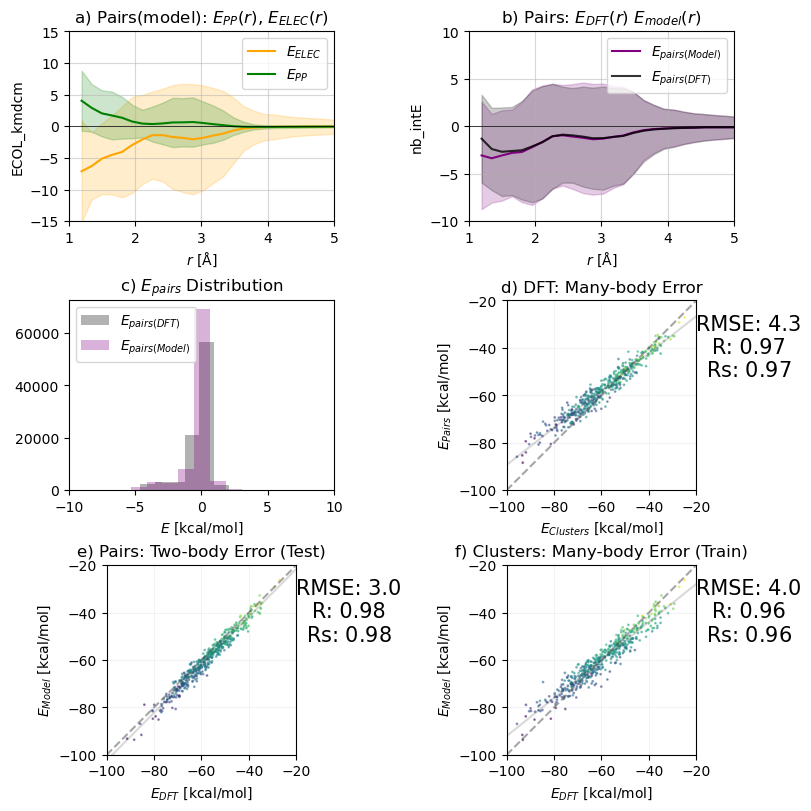

2
18.680274337942244


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


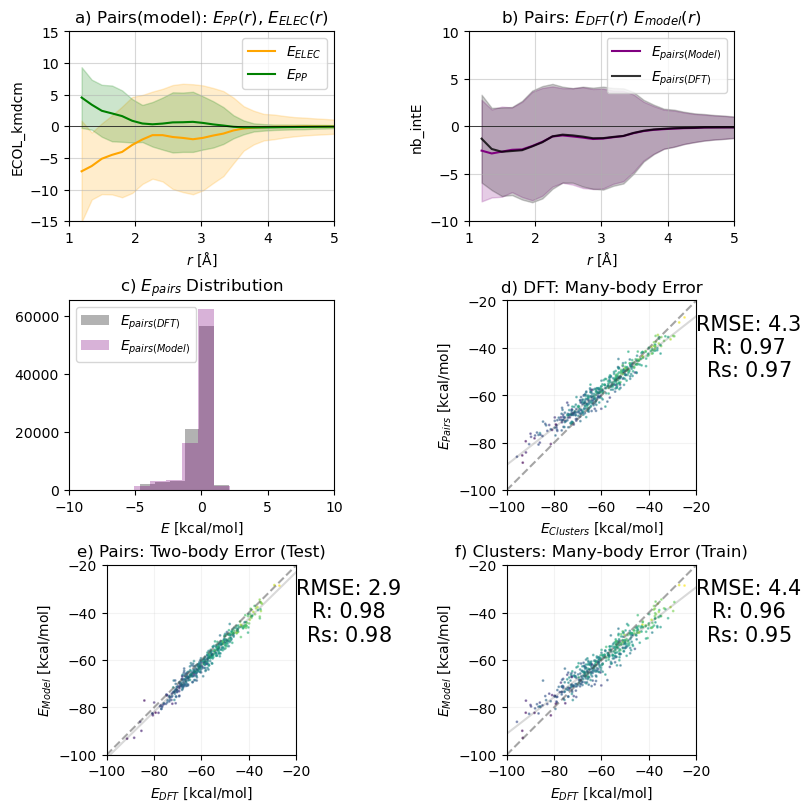

3
16.083743031742973


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


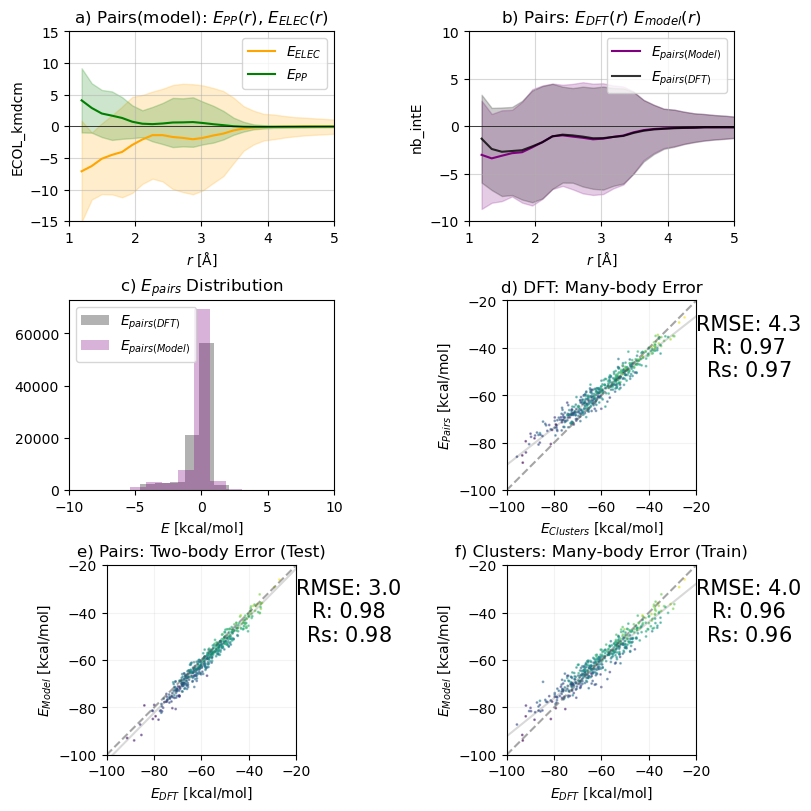

4
16.083743031733874


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


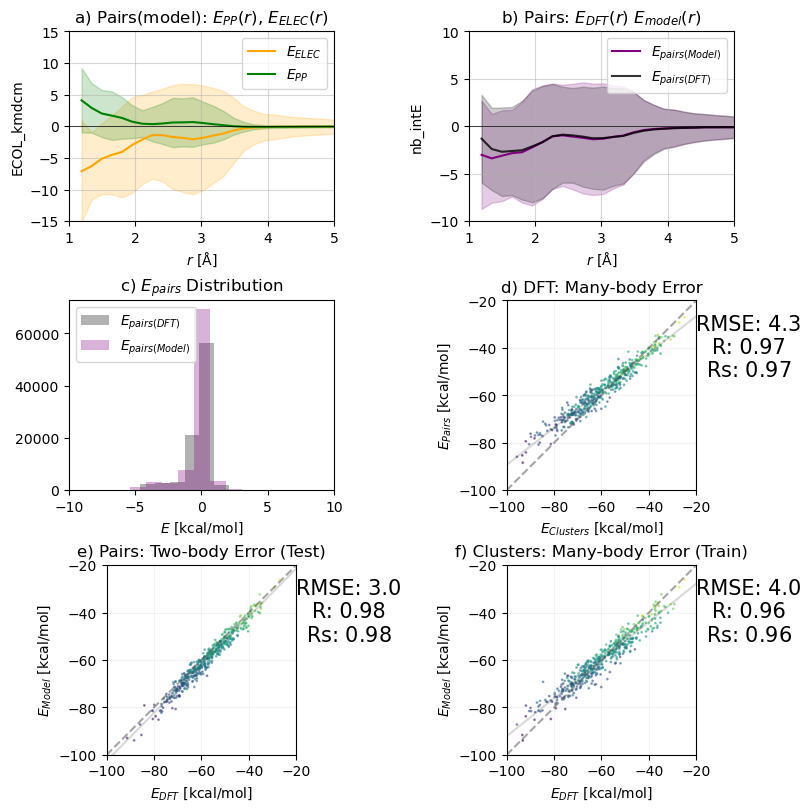

5
16.08369260356271


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


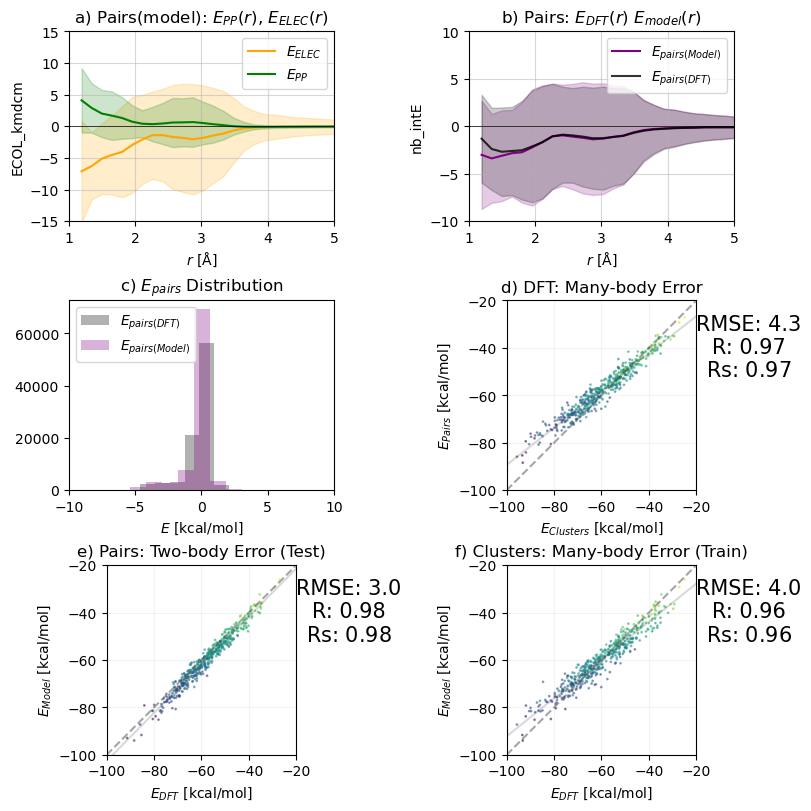

6
17.309935499435298


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


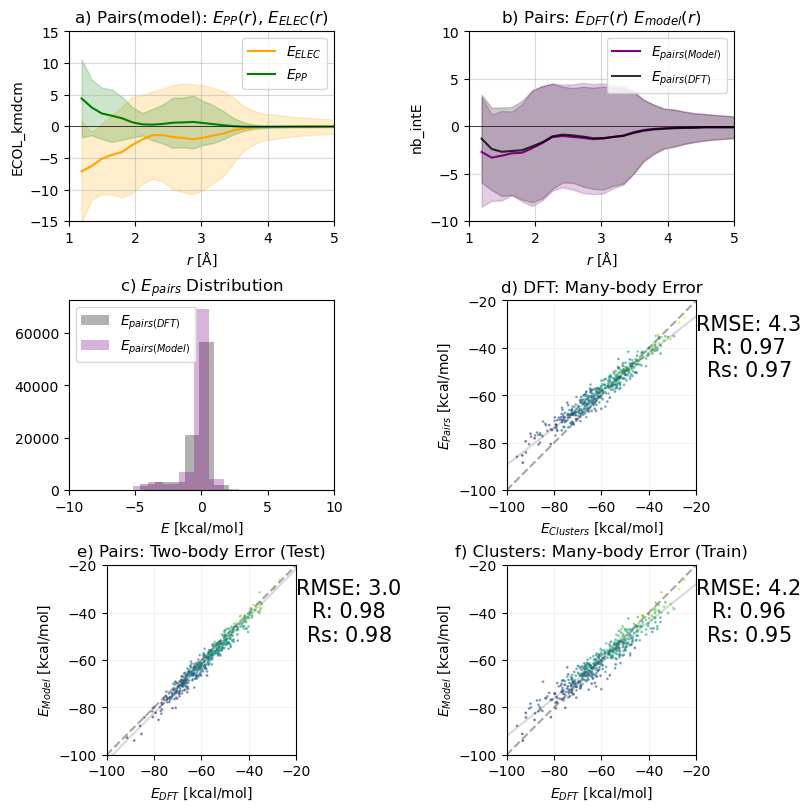

7
378.4058993405073


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


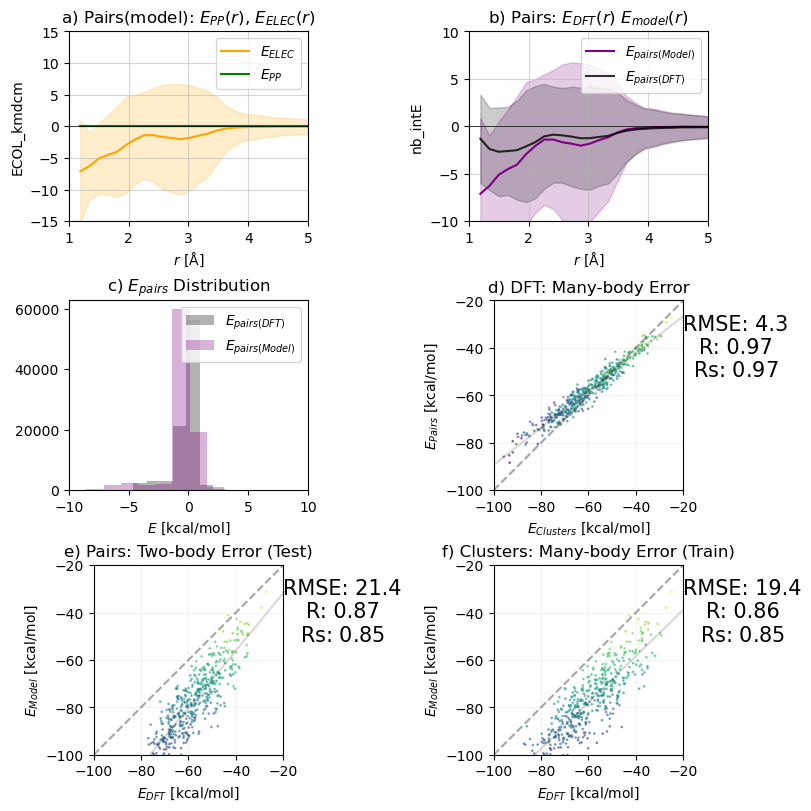

8
16.86033940979354


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


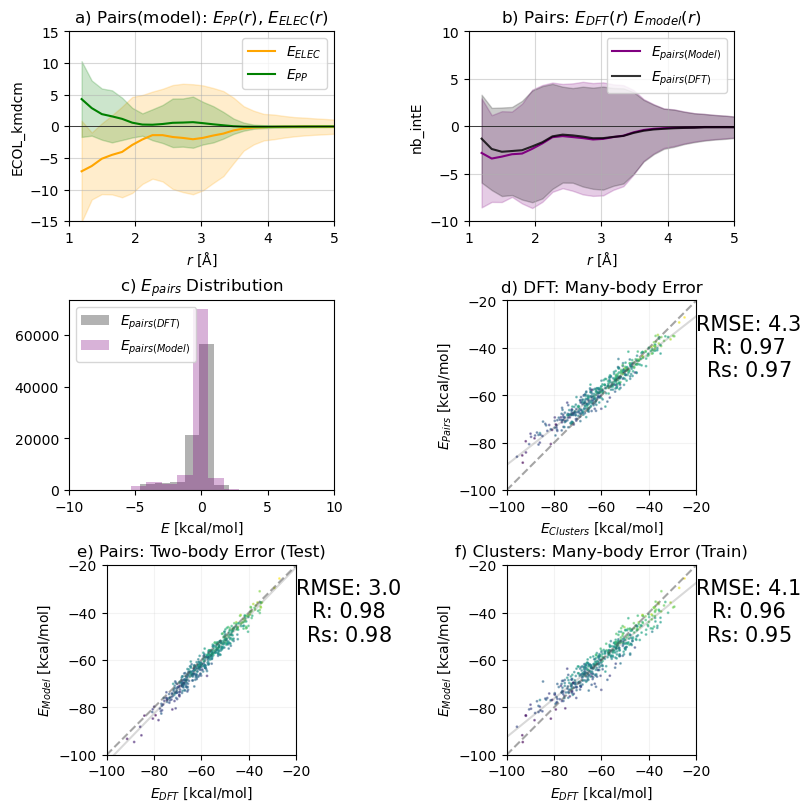

9
16.08374303206578


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


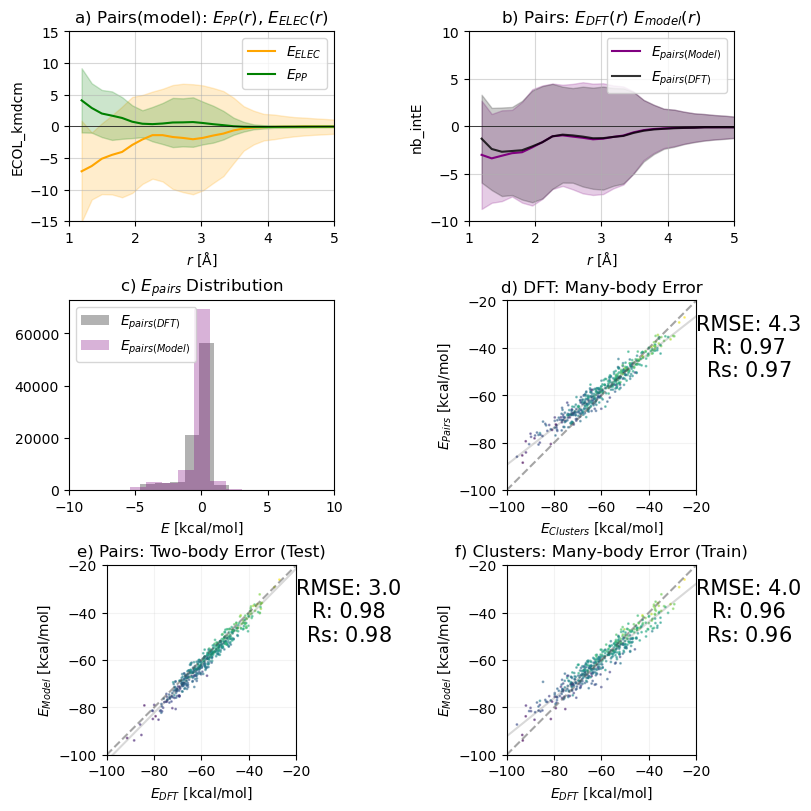

In [671]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_kmdcm = next(read_from_pickle('pickles/pbe0_dz_kmdcm_DE_water_cluster_ELEC_harmonic_ELEC.pkl'))
kmdcm_de_harm_stats = plot_ff_fit(ff, ff_fit_kmdcm, ecol="ECOL_kmdcm",EB=("sd", 3), suptitle="kMDCM-DE")

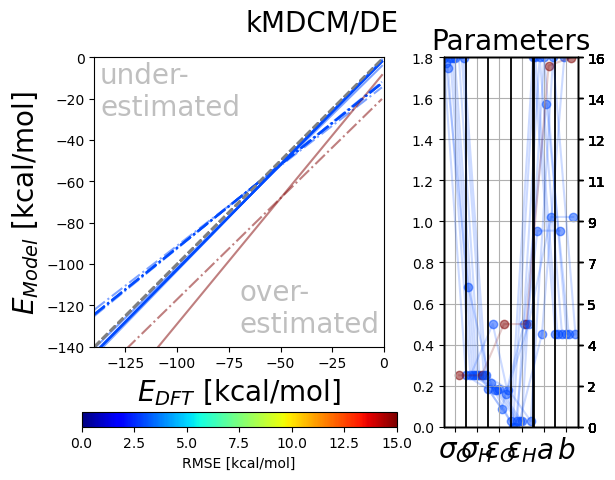

In [667]:
parm_plots(kmdcm_de_harm_stats, title="kMDCM/DE")

#  MDCM LJ

2.410696410024927 1.552641751990757
0
28.373173118924793


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


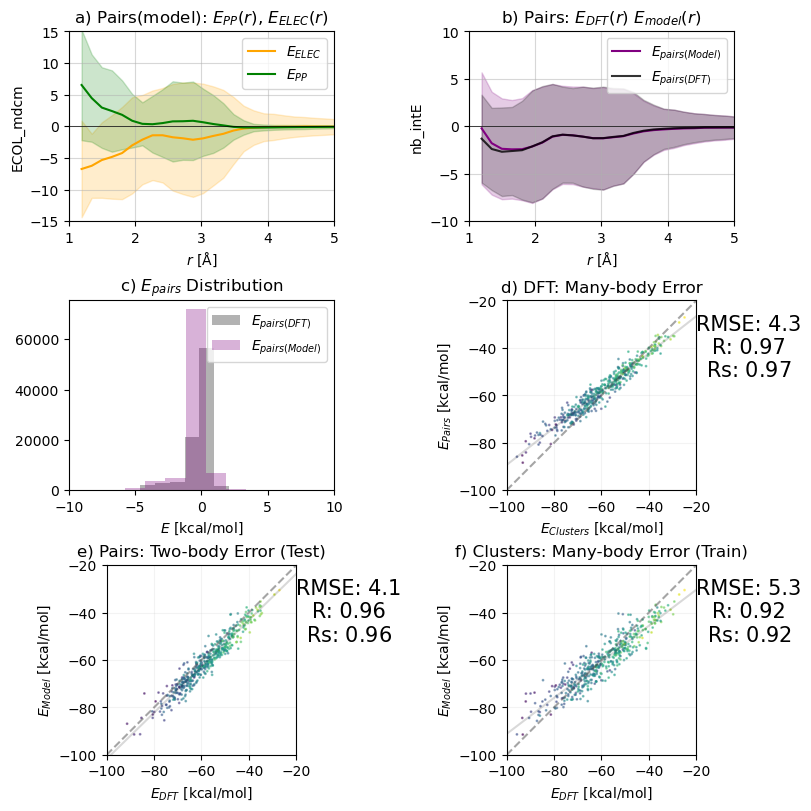

1
16.846981603232166


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


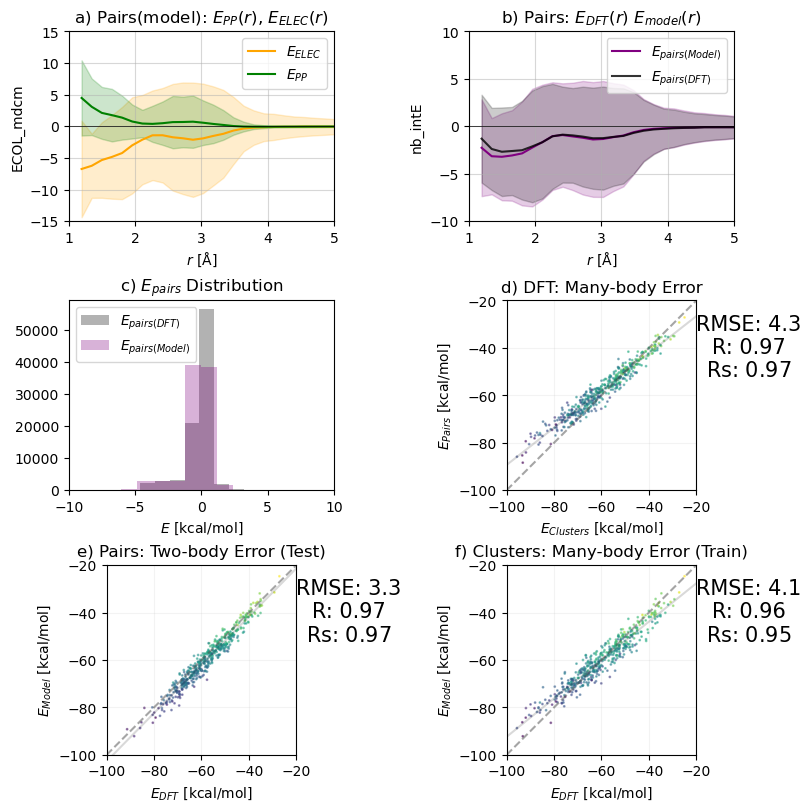

In [675]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_mdcm = next(read_from_pickle('pickles/pbe0_dz_mdcm_LJ_water_cluster_ELEC_harmonic_ELEC.pkl'))
mdcm_lj_harm_stats = plot_ff_fit(ff, ff_fit_mdcm, ecol="ECOL_mdcm", EB=("sd", 3), suptitle="MDCM-LJ")

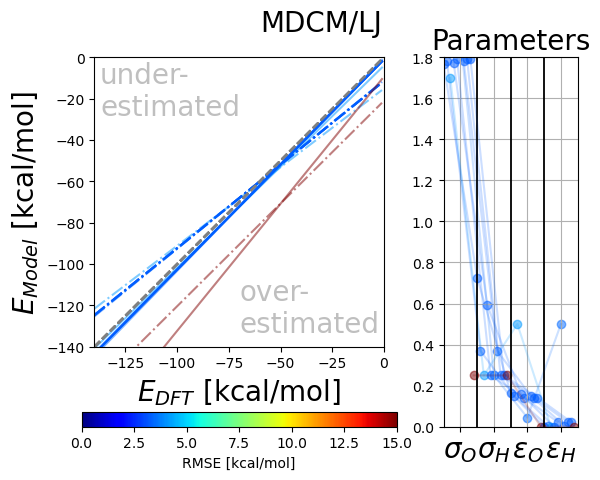

In [697]:
parm_plots(mdcm_lj_harm_stats, title="MDCM/LJ")
plt.savefig("MDCMLJ.png", bbox_inches="tight")

#  MDCM DE


2.410696410024927 1.552641751990757
0
16.677123108980705


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


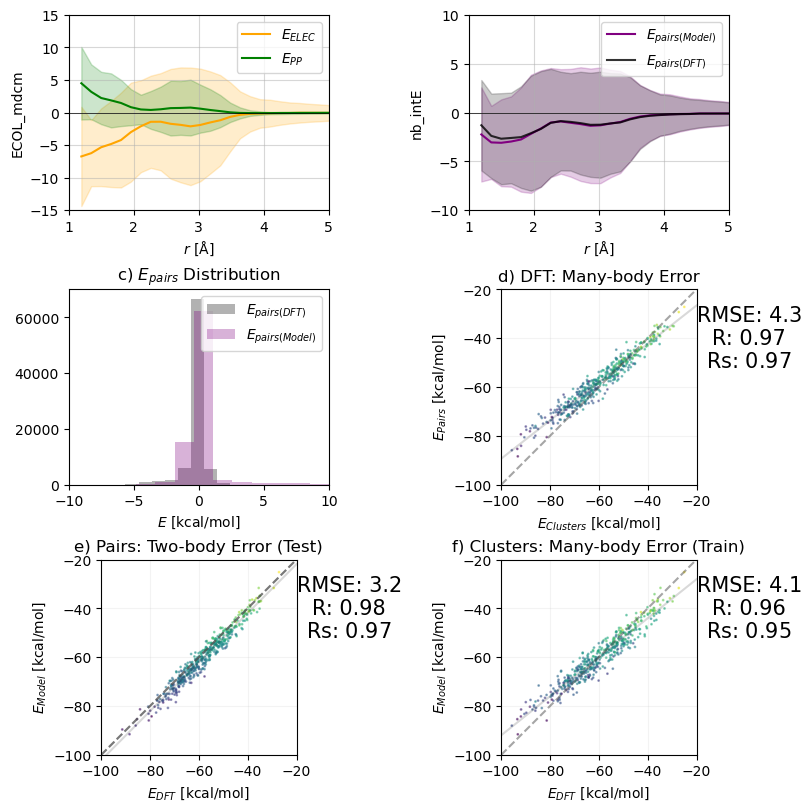

1
16.711759216712338


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


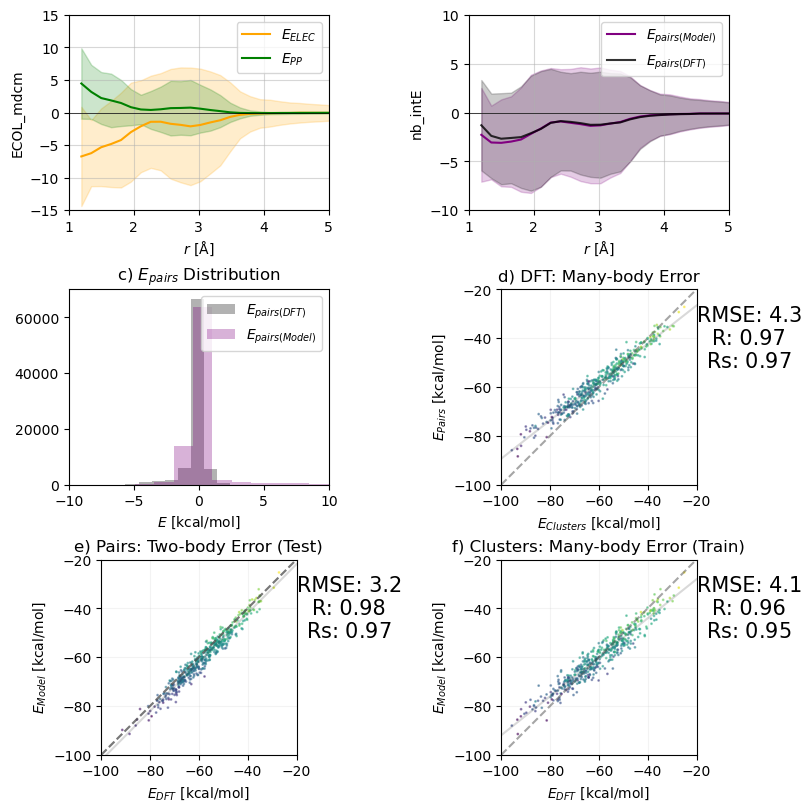

2
16.76166365299405


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


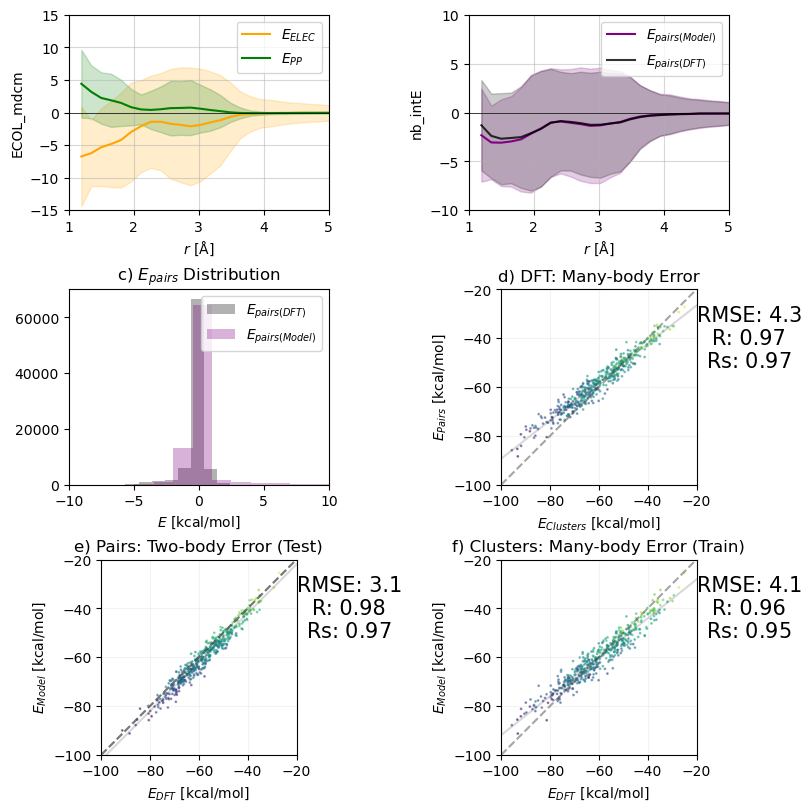

3
16.677123111295113


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


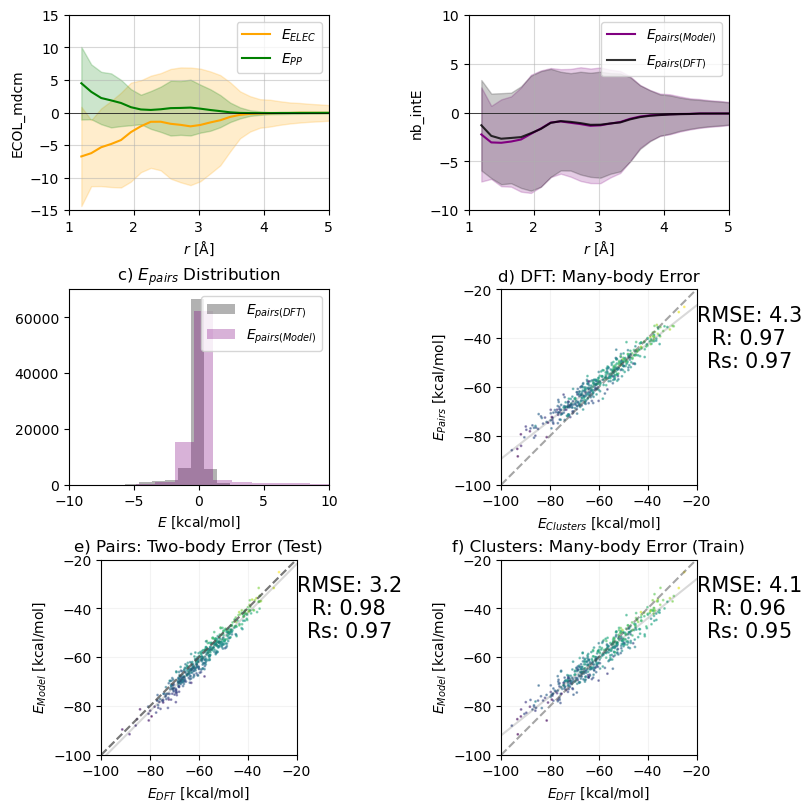

4
16.761663651286618


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


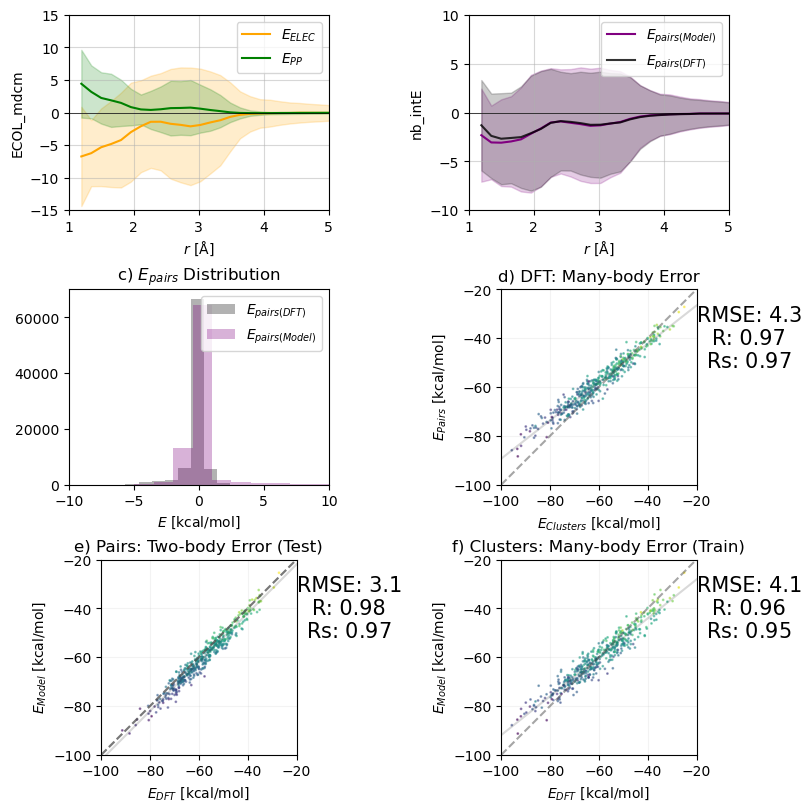

In [676]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_mdcm = next(read_from_pickle('pickles/pbe0_dz_mdcm_DE_water_cluster_ELEC_harmonic_ELEC.pkl'))
mdcm_de_harm_stats = plot_ff_fit(ff, ff_fit_mdcm, ecol="ECOL_mdcm",EB=("sd", 3), suptitle="MDCM-DE")

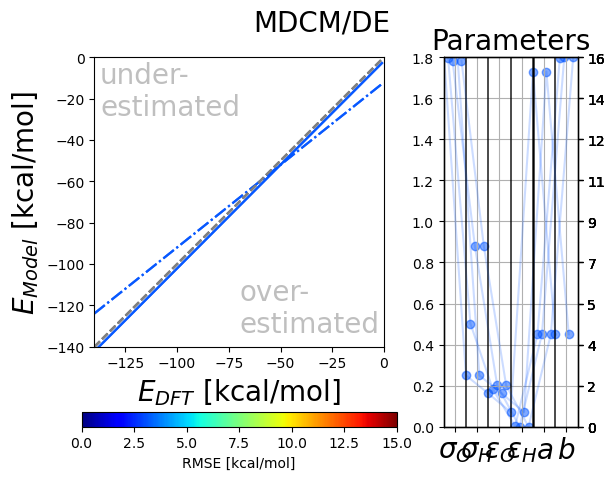

In [581]:
parm_plots(mdcm_de_harm_stats, title="MDCM/DE")

#  DUMMY

6339.998932246535 79.62411024461457
0
872.065563411921


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


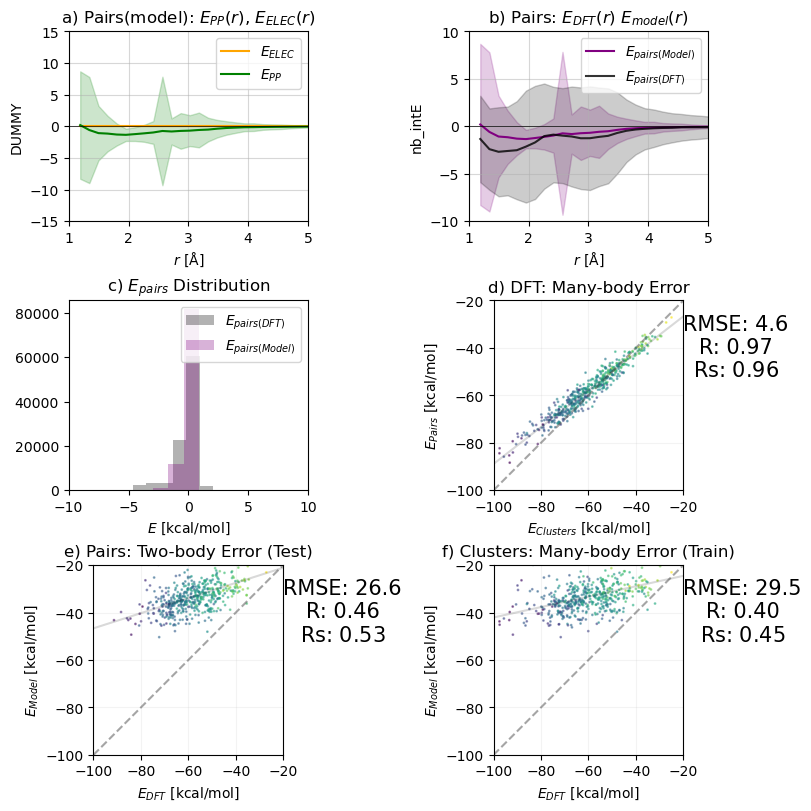

1
872.0655634117834


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


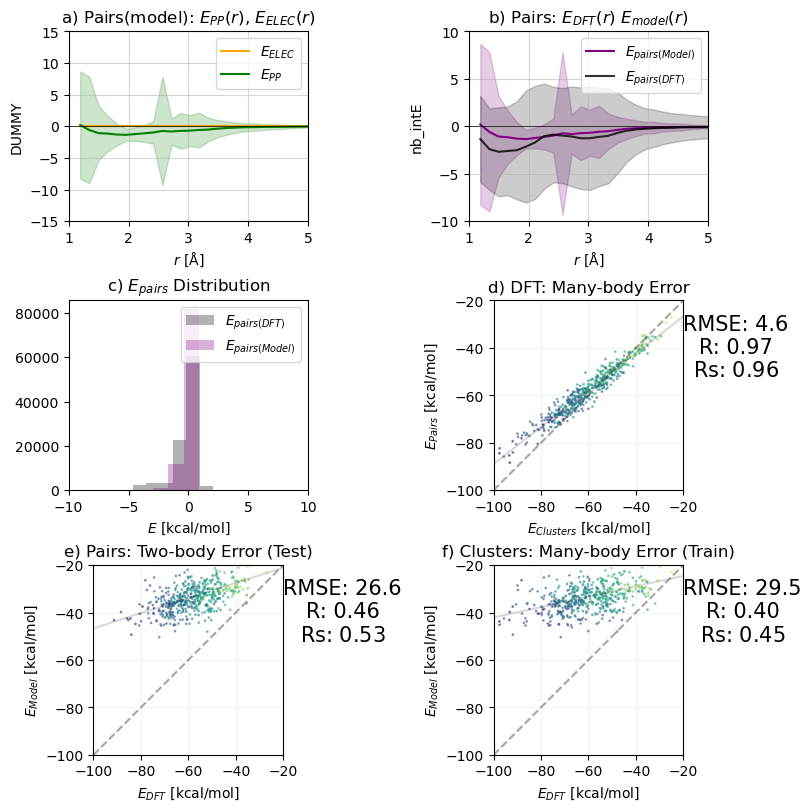

2
1936.3705079124238


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


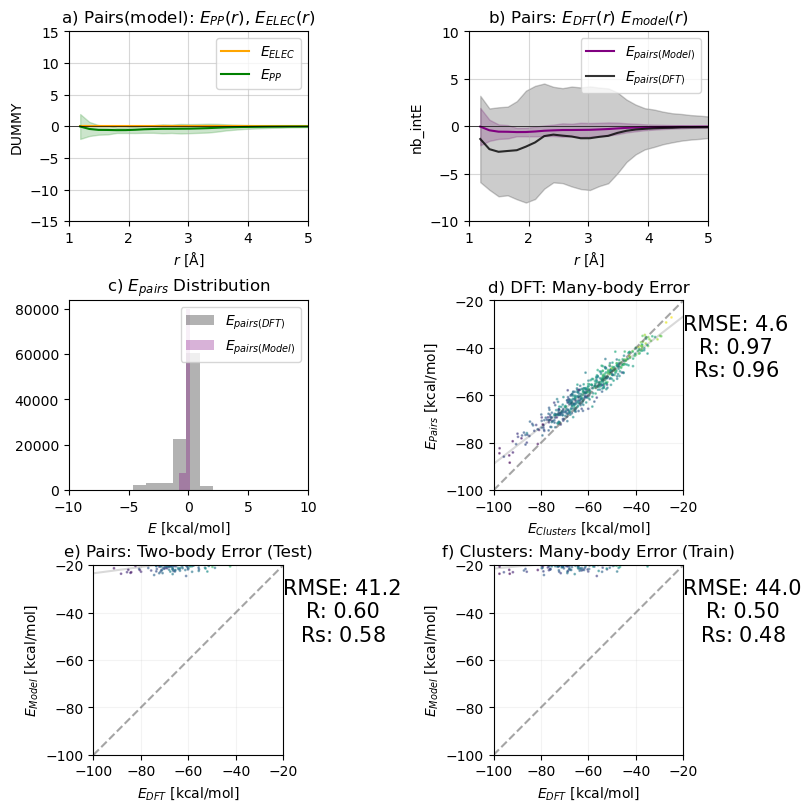

3
872.0655634116857


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


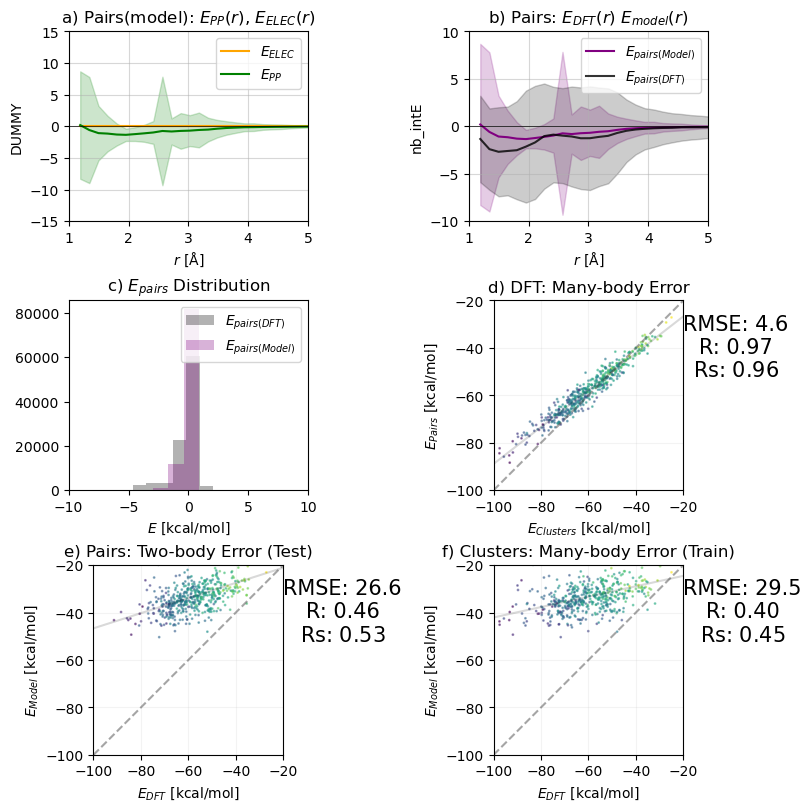

4
1472.1672639912106


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


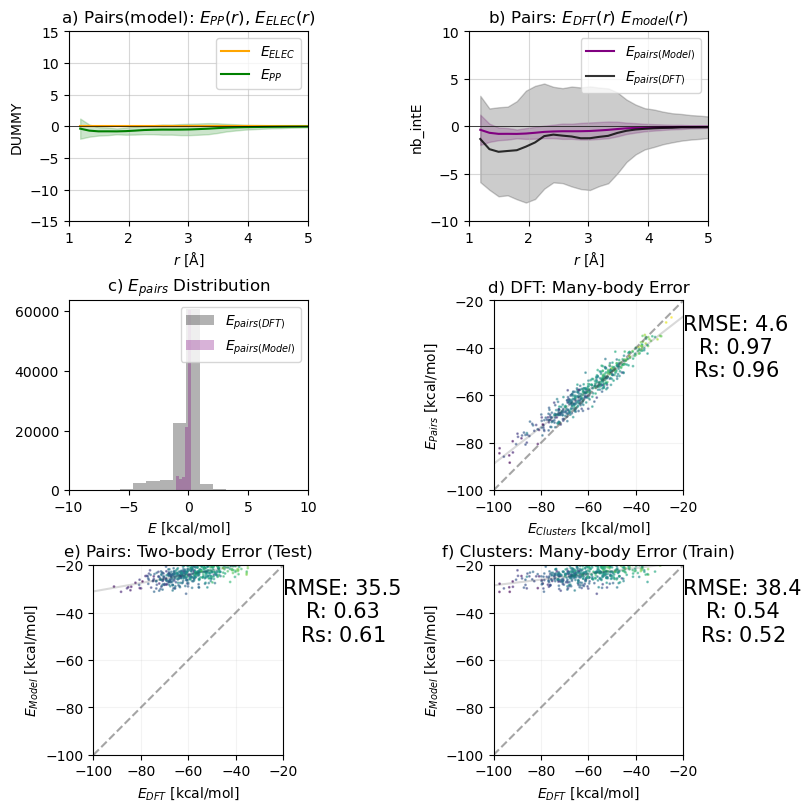

5
1472.1672639924107


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


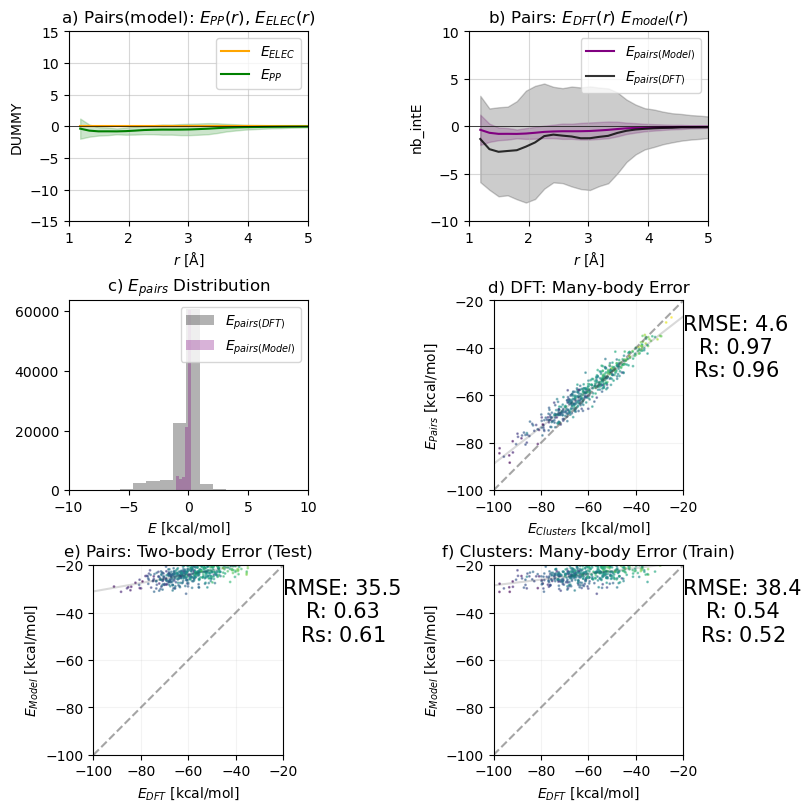

6
872.0655634122435


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


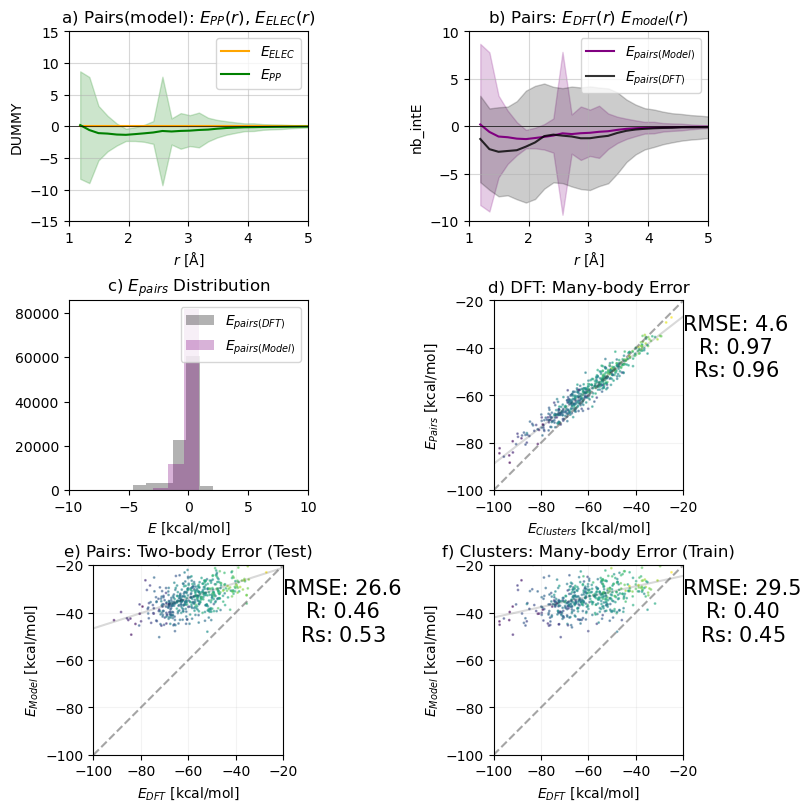

7
872.0655634125156


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


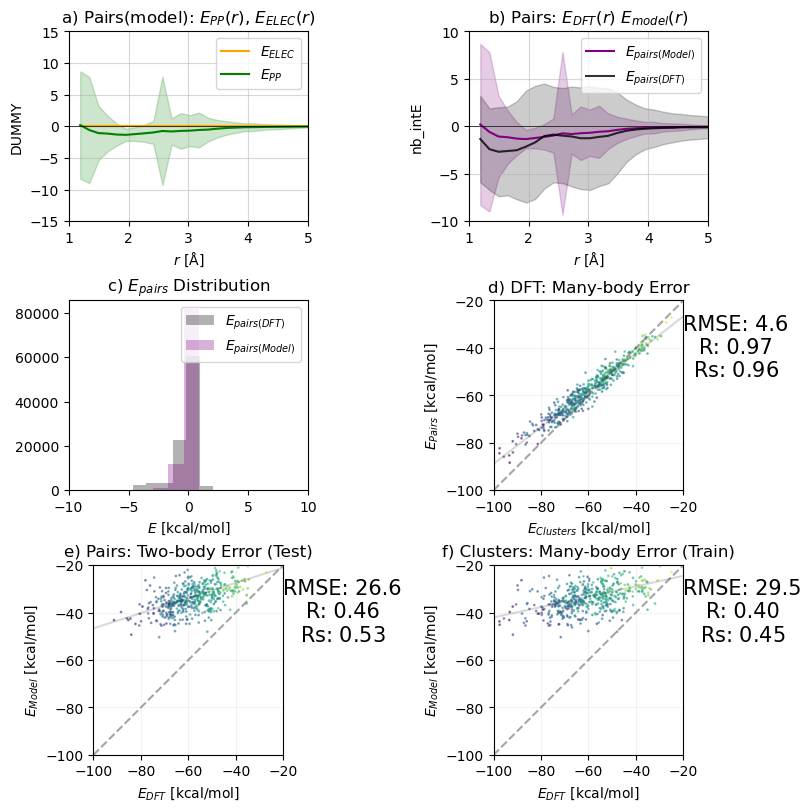

8
1329.027333842187


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


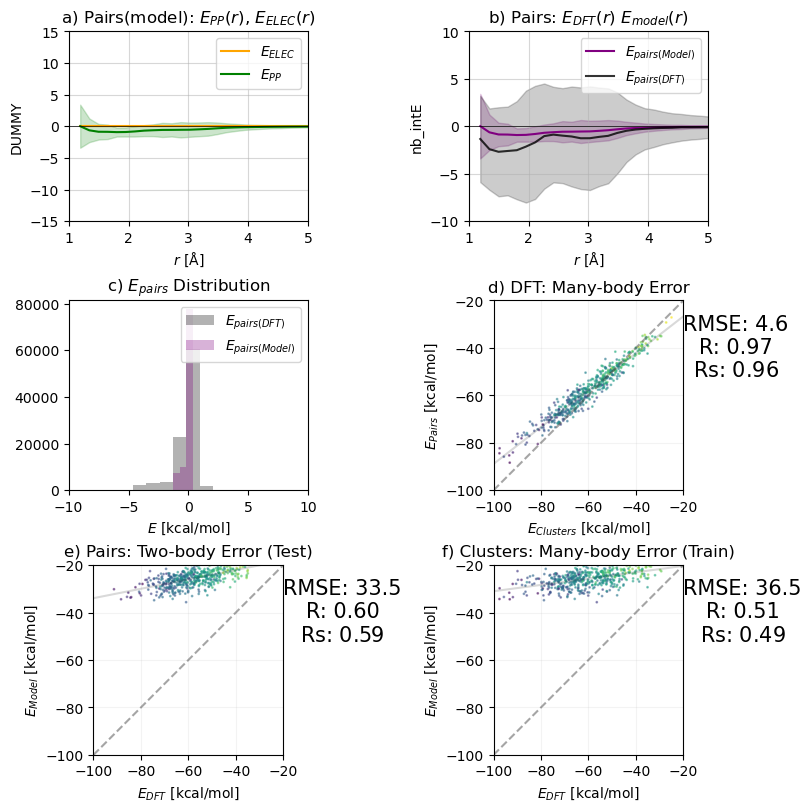

9
872.0655634120769


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


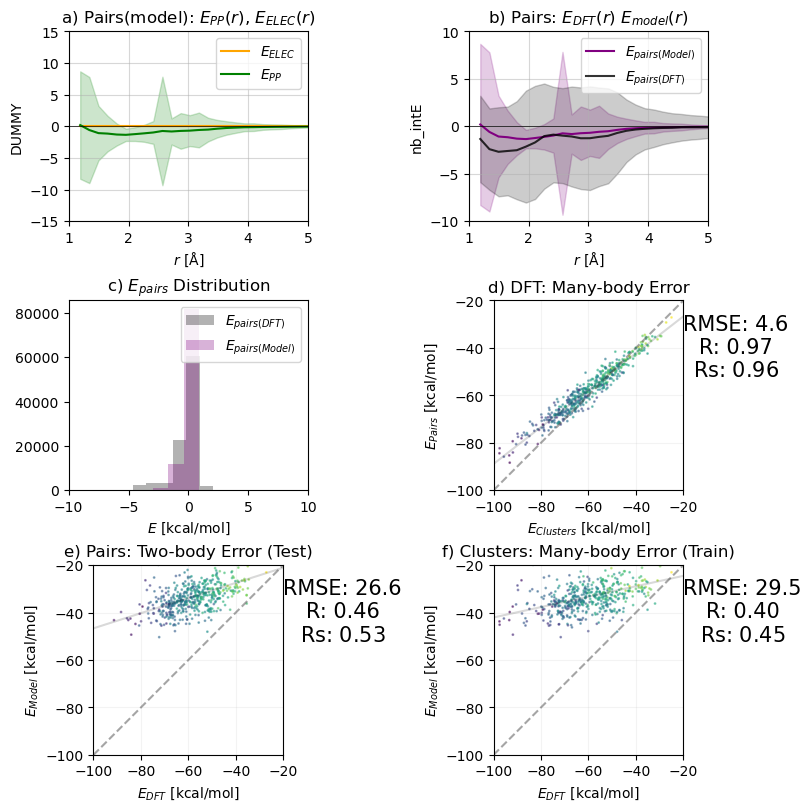

In [677]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_kmdcm = next(read_from_pickle('pickles/pbe0_dz_kmdcm_LJ_water_cluster_DUMMY_Exact_DUMMY.pkl'))
dummy_lj_exact_stats = plot_ff_fit(ff, ff_fit_kmdcm, ecol="DUMMY", EB=("sd", 3), suptitle="DUMMY-LJ")

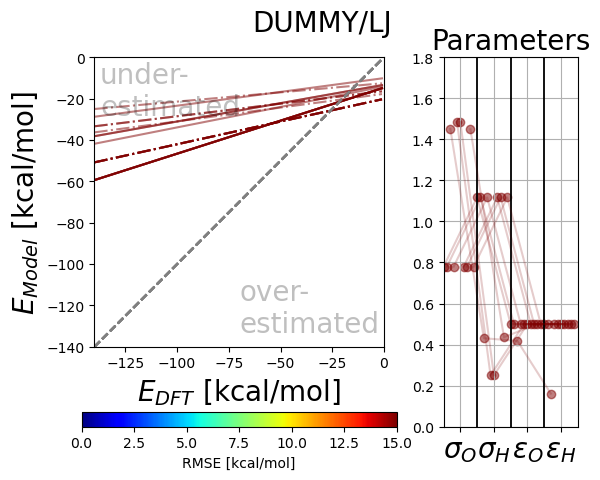

In [682]:
parm_plots(dummy_lj_exact_stats, title="DUMMY/LJ")
plt.savefig("DUMMYLJ.png", bbox_inches="tight")

4772.416975748818 69.08268216962061
0
137.4747014925378


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


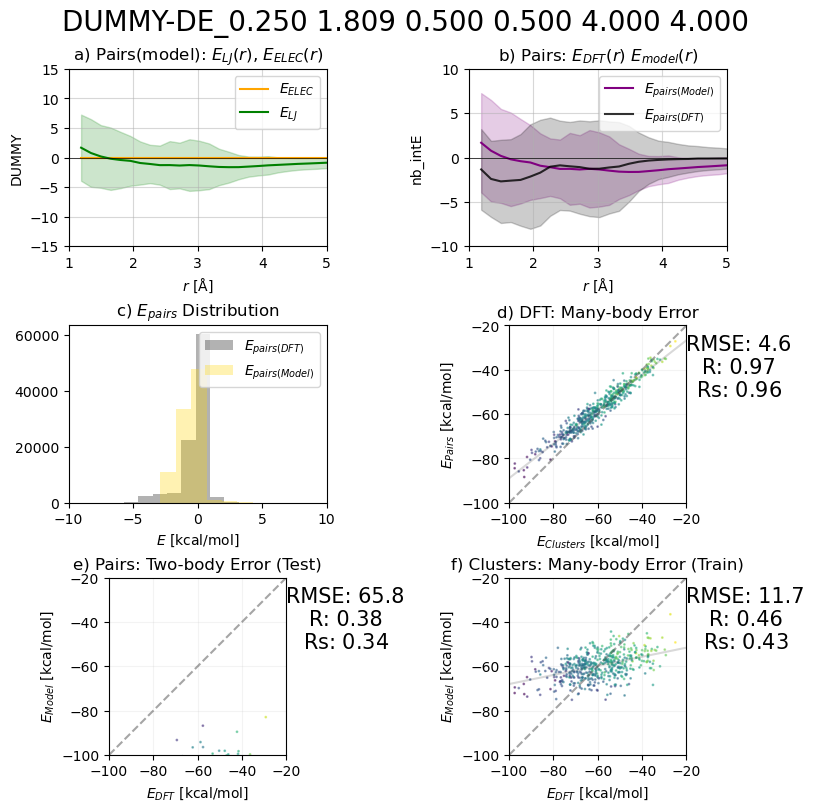

1
524.979605952733


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


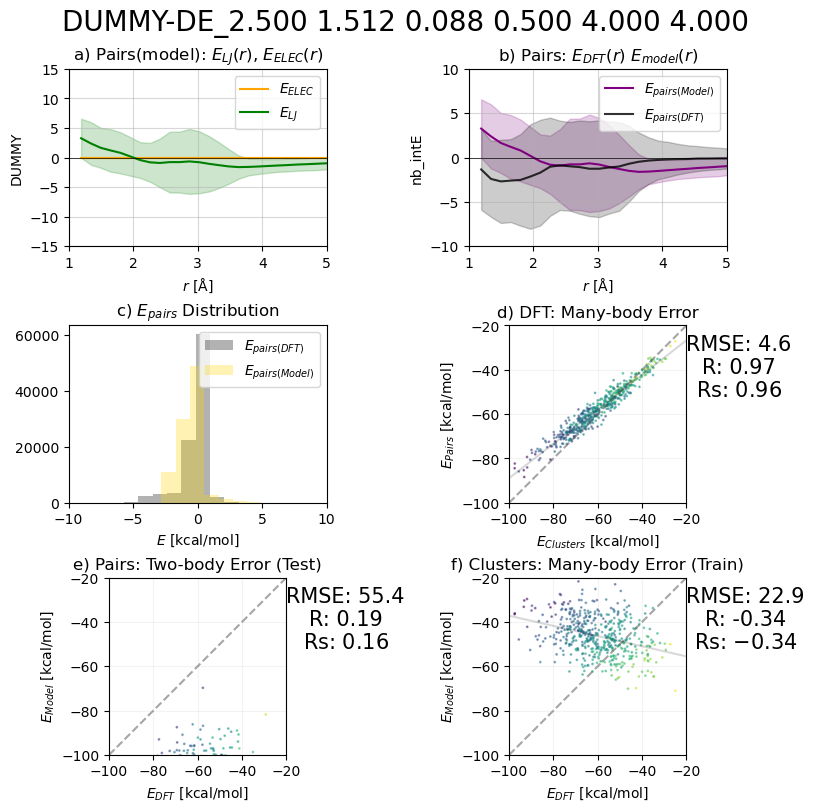

2
137.4746755749712


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


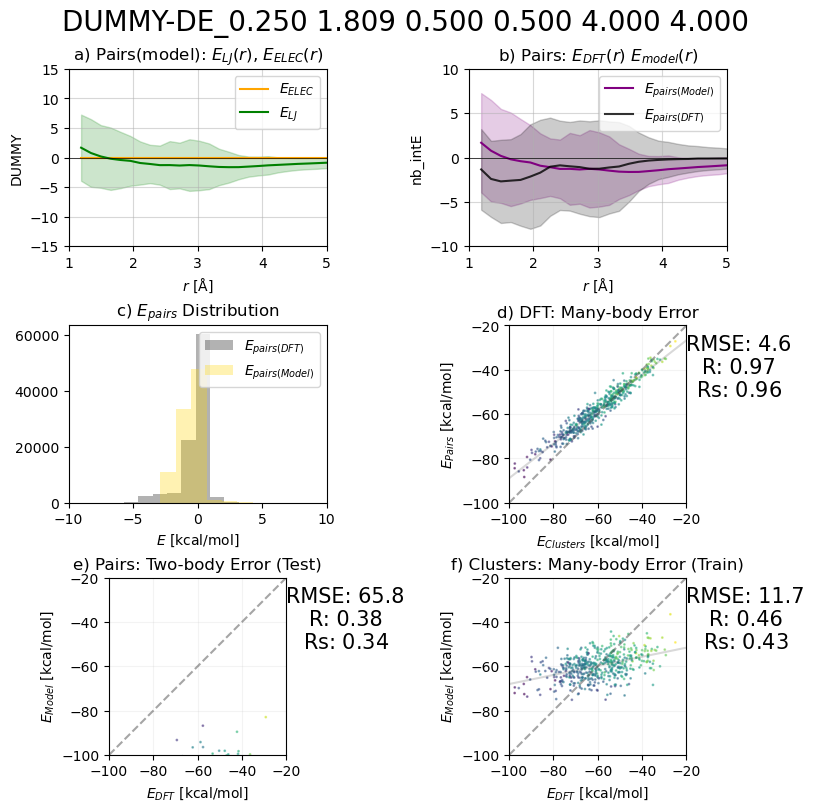

3
137.3228325442121


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


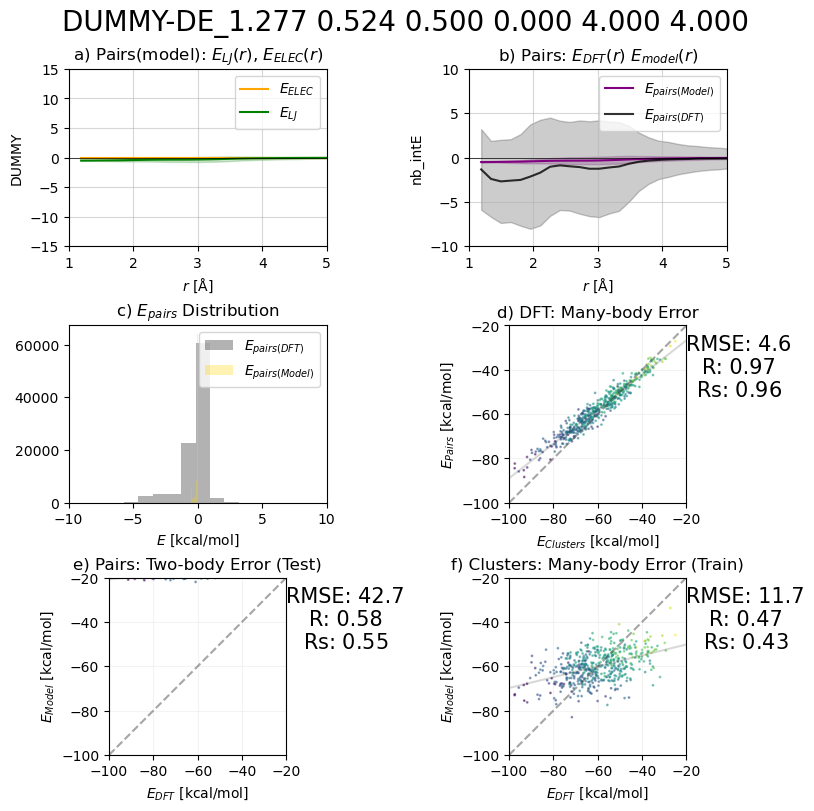

4
131.40527726413075


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


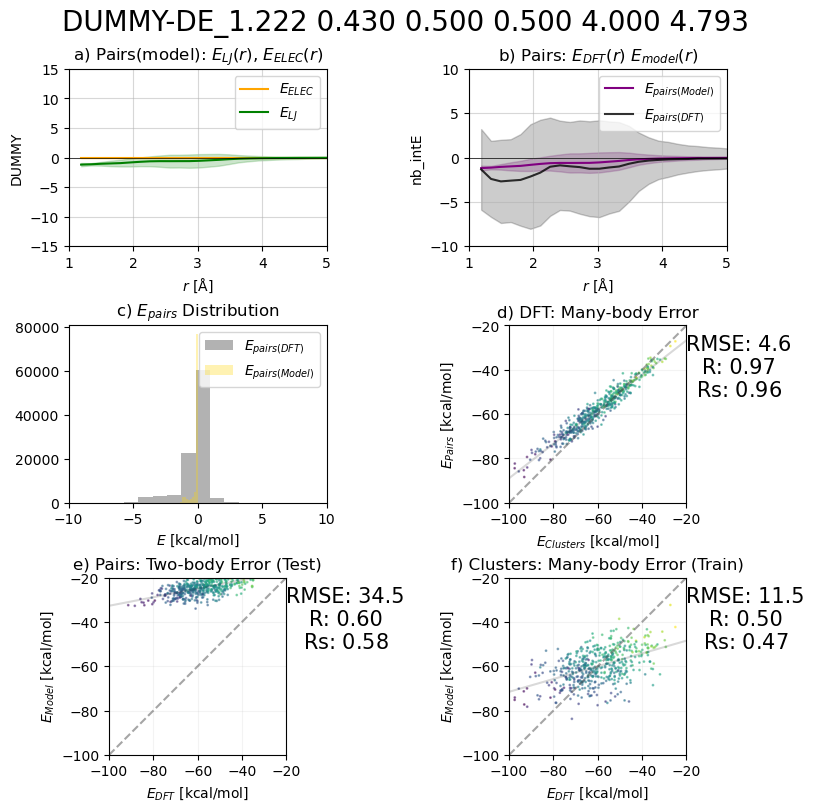

5
131.8063099041103


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


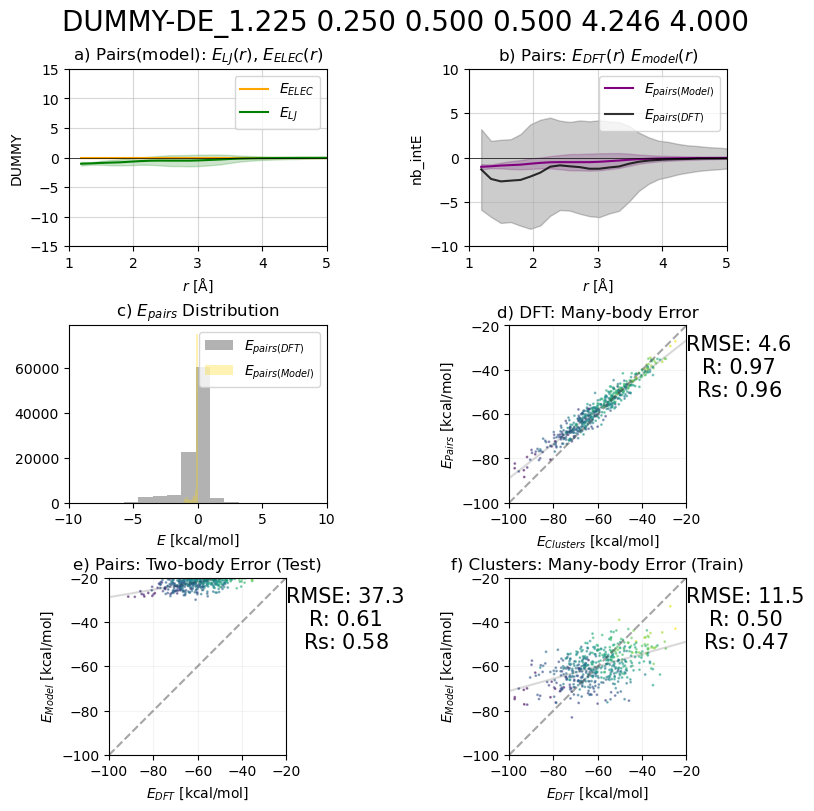

6
1331.9230233042929


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


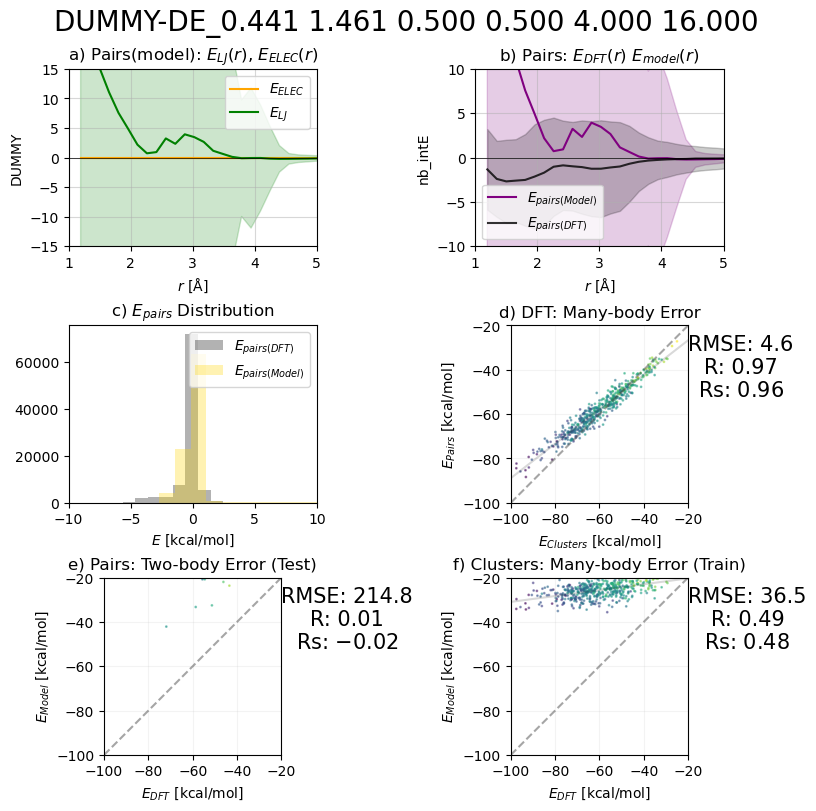

7
136.08869404336363


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


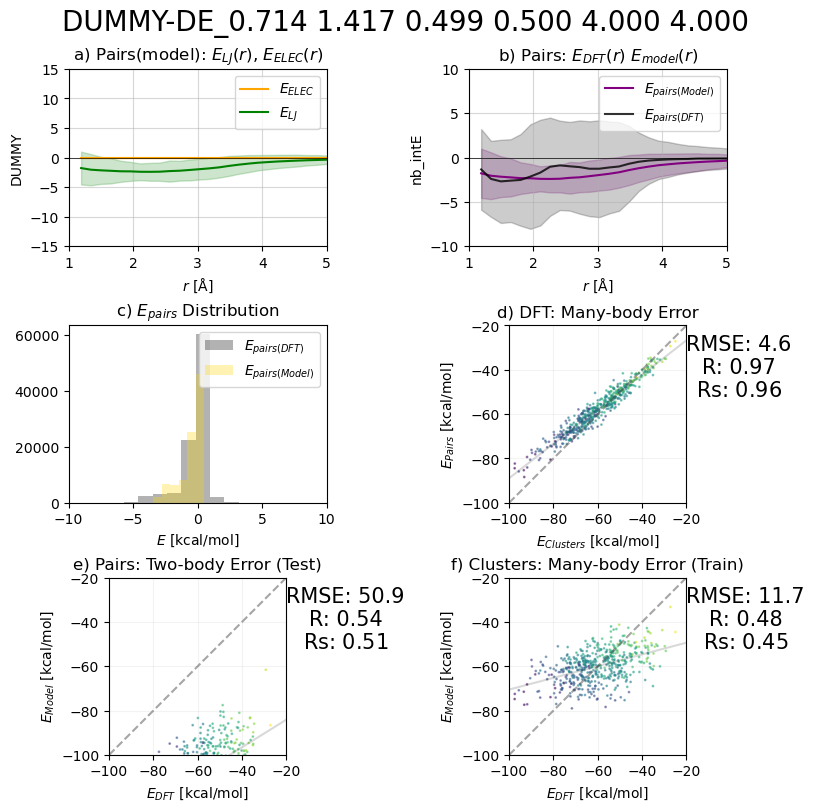

8
131.40527726383425


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


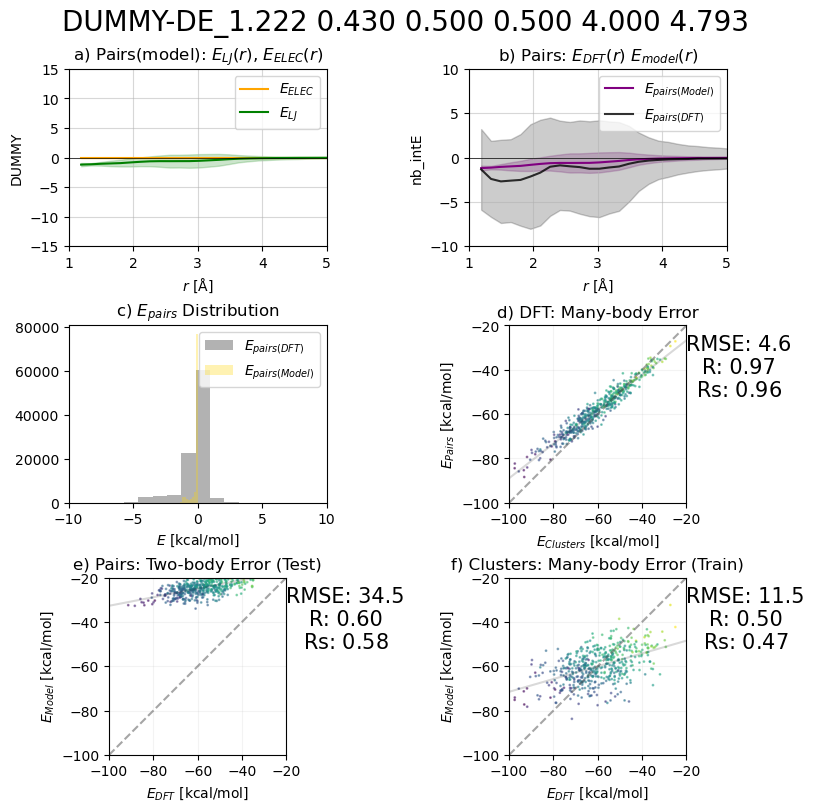

9
131.40527726384852


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:302: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "intE",


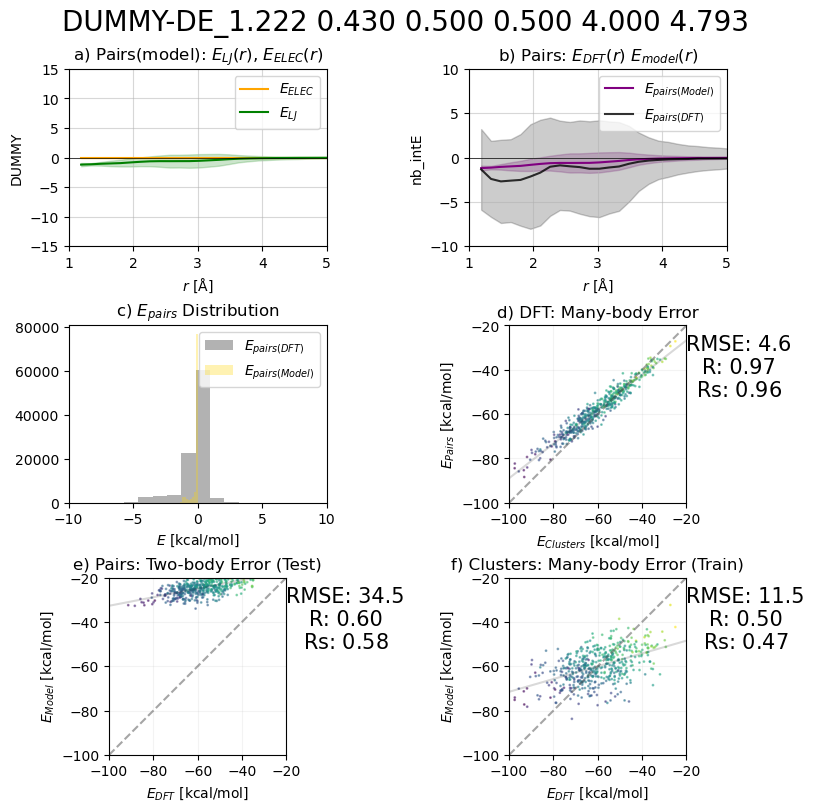

In [553]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_kmdcm = next(read_from_pickle('pickles/pbe0_dz_pc_DE_water_cluster_DUMMY_Exact_DUMMY.pkl'))
dummy_de_exact_stats = plot_ff_fit(ff, ff_fit_kmdcm, ecol="DUMMY", EB=("sd", 3), suptitle="DUMMY-DE")

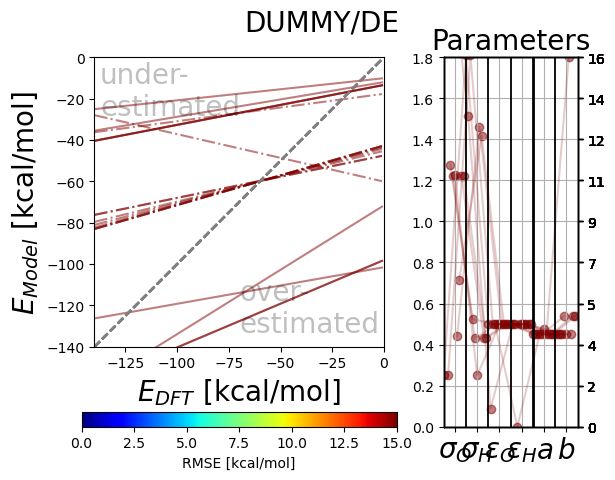

In [683]:
parm_plots(dummy_de_exact_stats, title="DUMMY/DE")
plt.savefig("DUMMYDE.png", bbox_inches="tight")

#  EPOL MIKE (LJ)

6632.377923459048 81.43941259279225
0
8202.4360665481


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


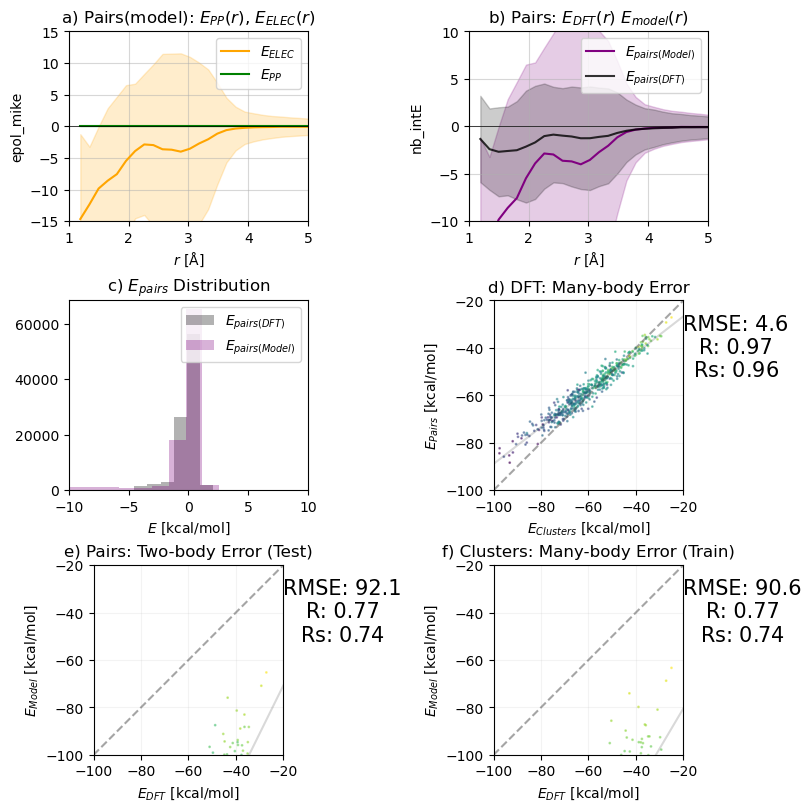

1
8202.4360665481


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


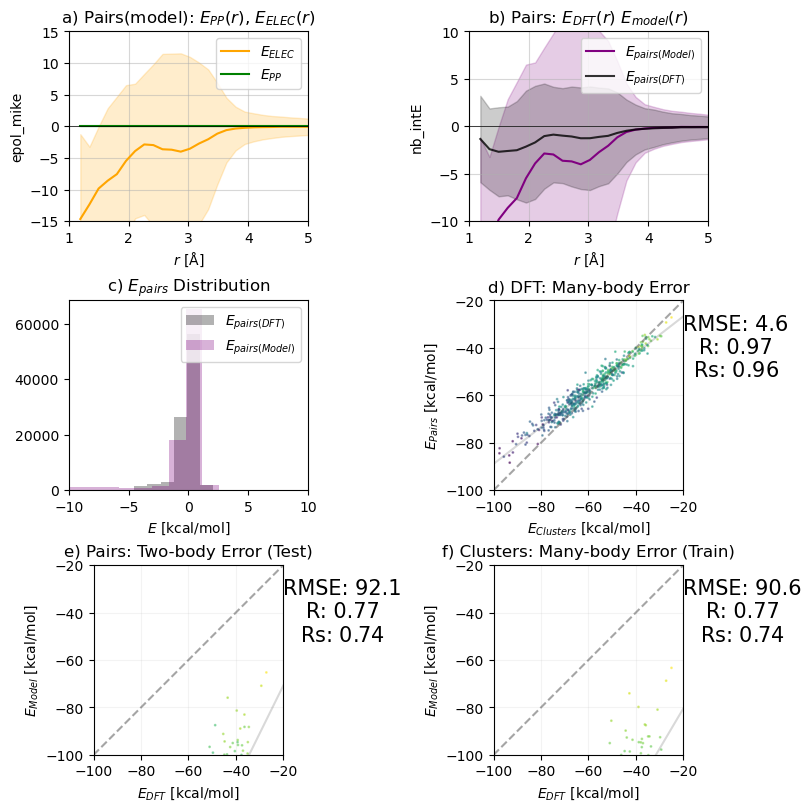

2
16.578252995878408


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


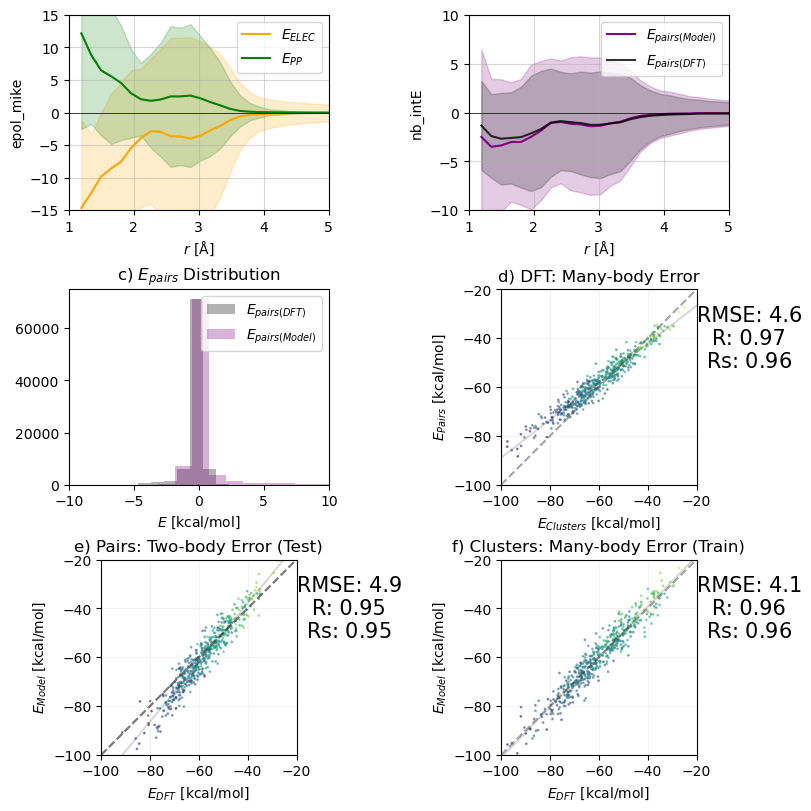

3
19.359653257733246


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


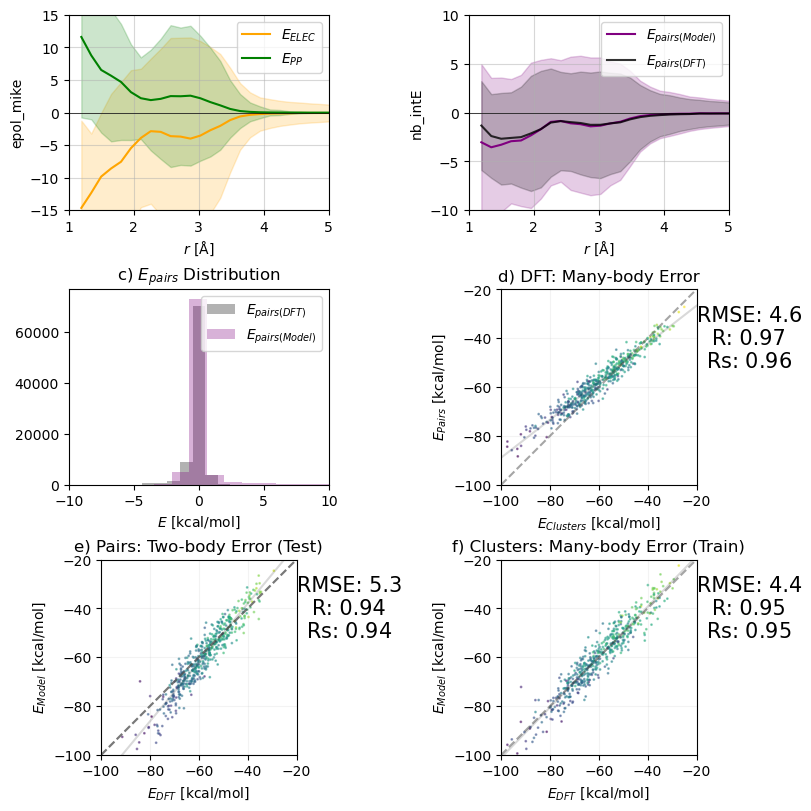

4
171.64435577314097


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


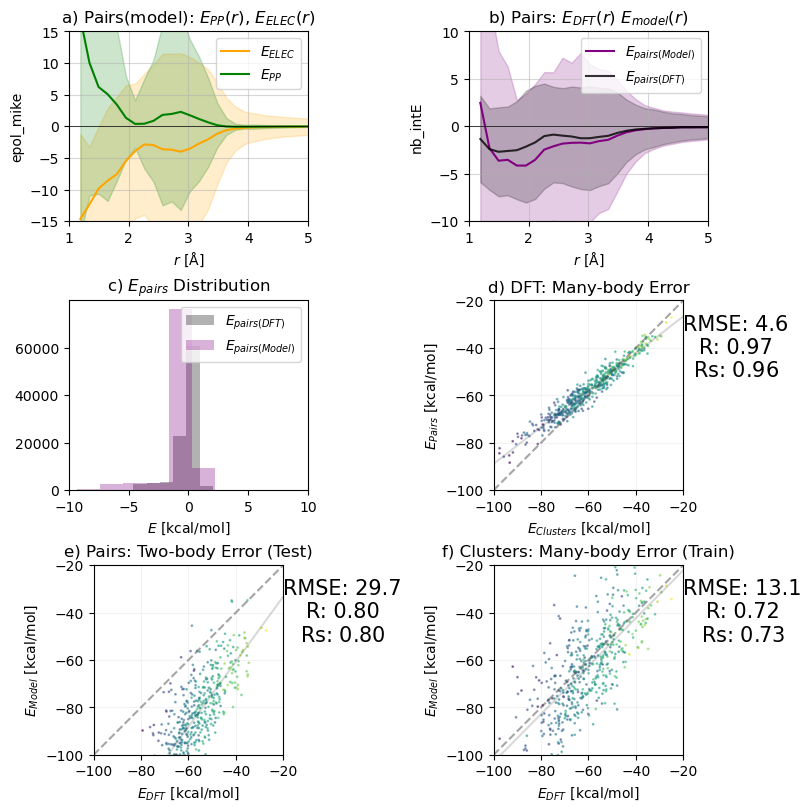

5
8202.4360665481


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


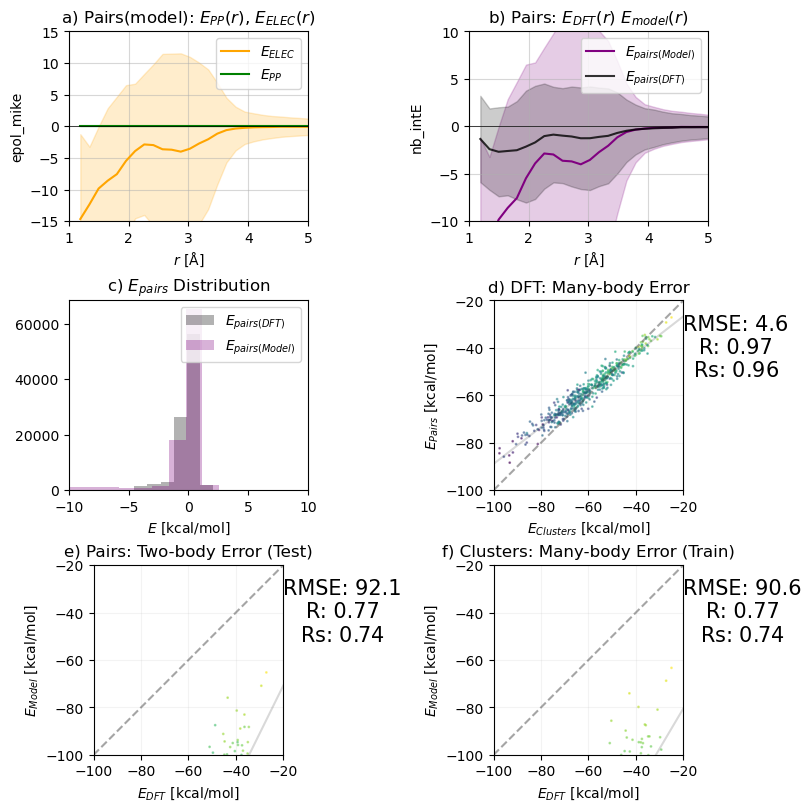

6
16.58032676898855


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


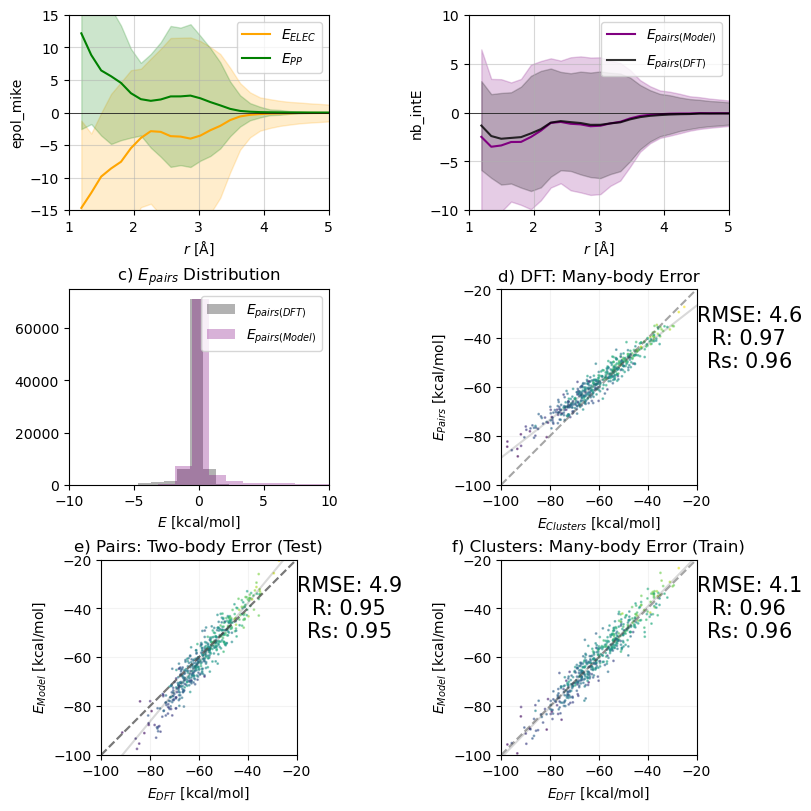

7
1235.6146986016543


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


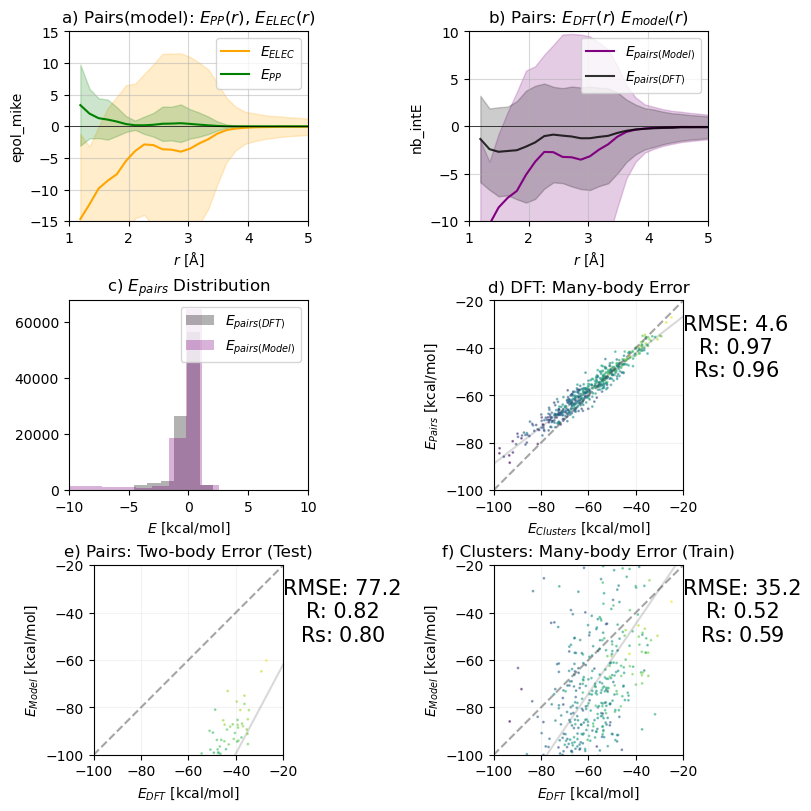

8
171.64435577305713


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


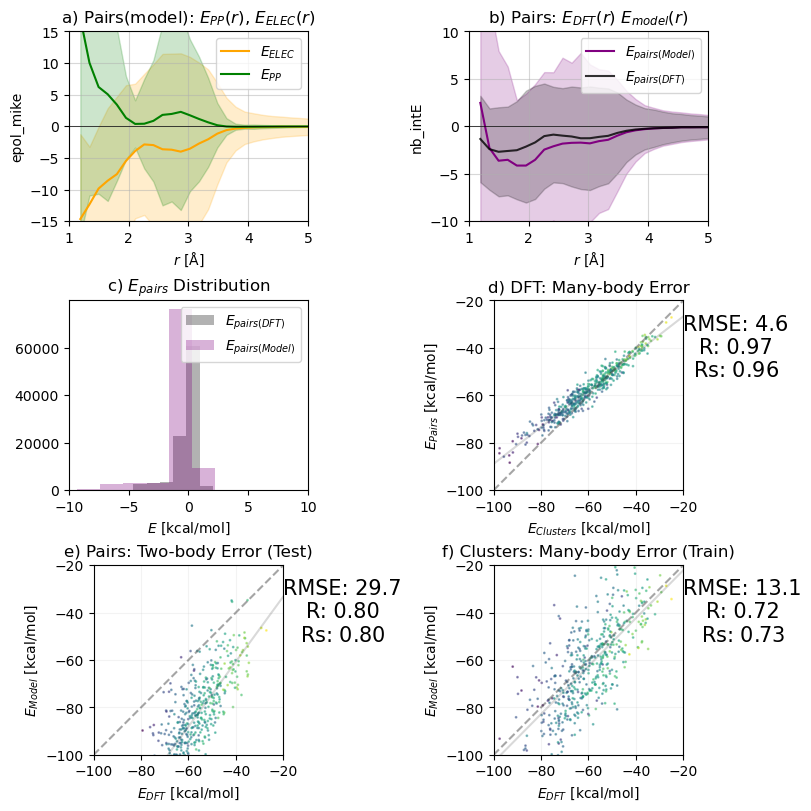

9
16.57825299599876


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


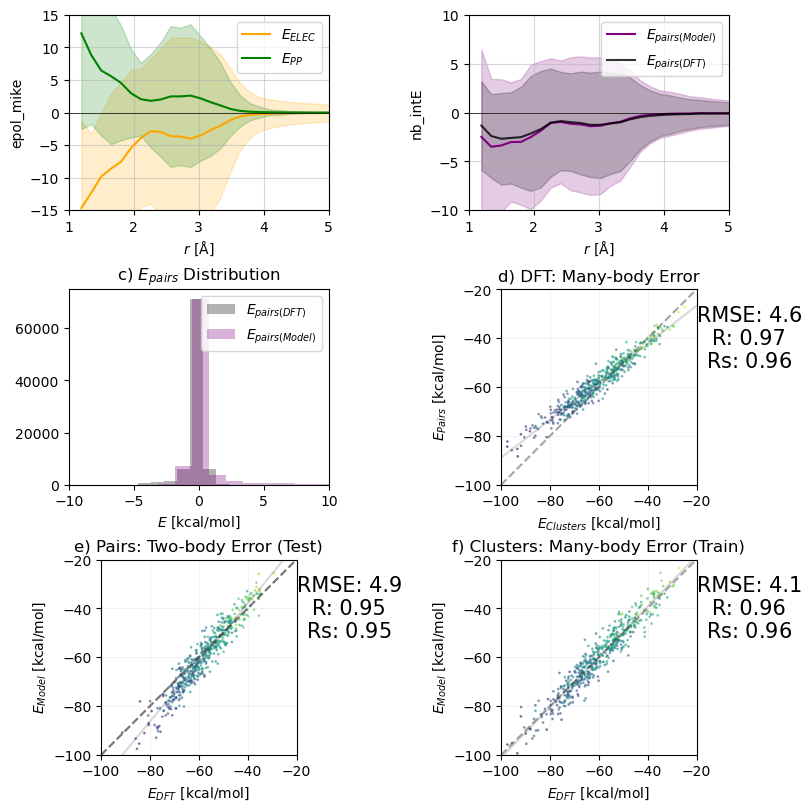

In [678]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_kmdcm = next(read_from_pickle('pickles/pbe0_dz_pc_LJ_water_cluster_epol_mike_Exact_epol_mike.pkl'))
epol_lj_exact_stats = plot_ff_fit(ff, ff_fit_kmdcm, ecol="epol_mike", EB=("sd", 3), suptitle="EPOL-LJ")

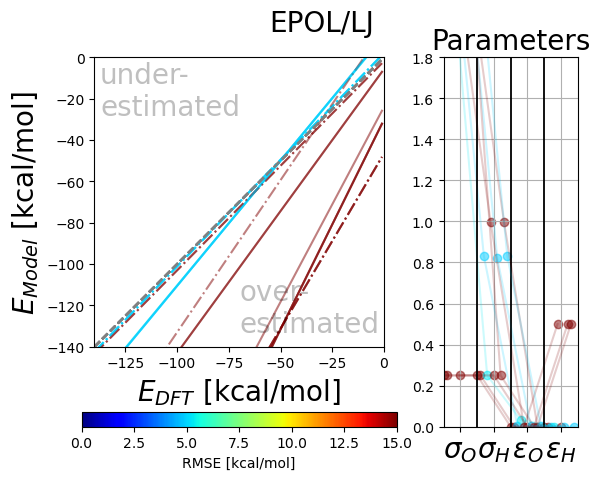

In [691]:
parm_plots(epol_lj_exact_stats, title="EPOL/LJ")
plt.savefig("EPOLLJ.png", bbox_inches="tight")

#  EPOL MIKE (DE)


6632.377923459048 81.43941259279225
0
11.313536734831377


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


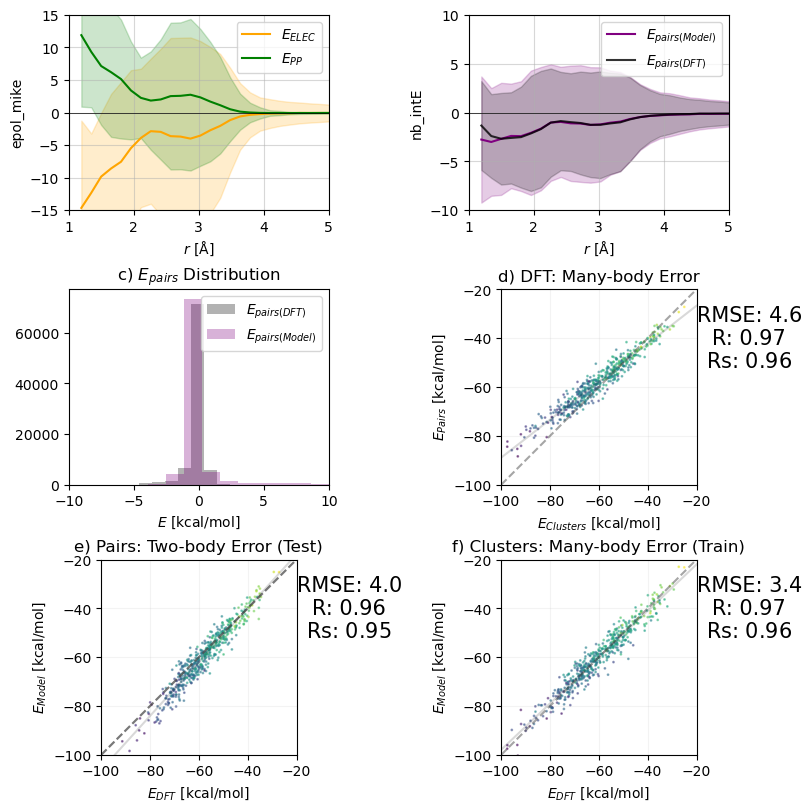

1
11.31566172741974


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


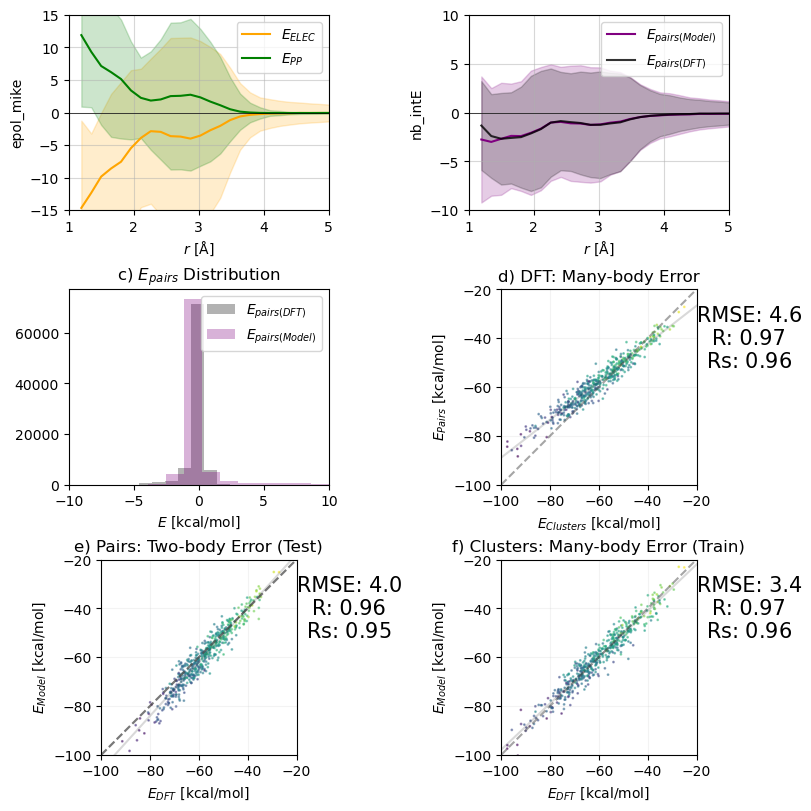

2
12.707146390947841


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


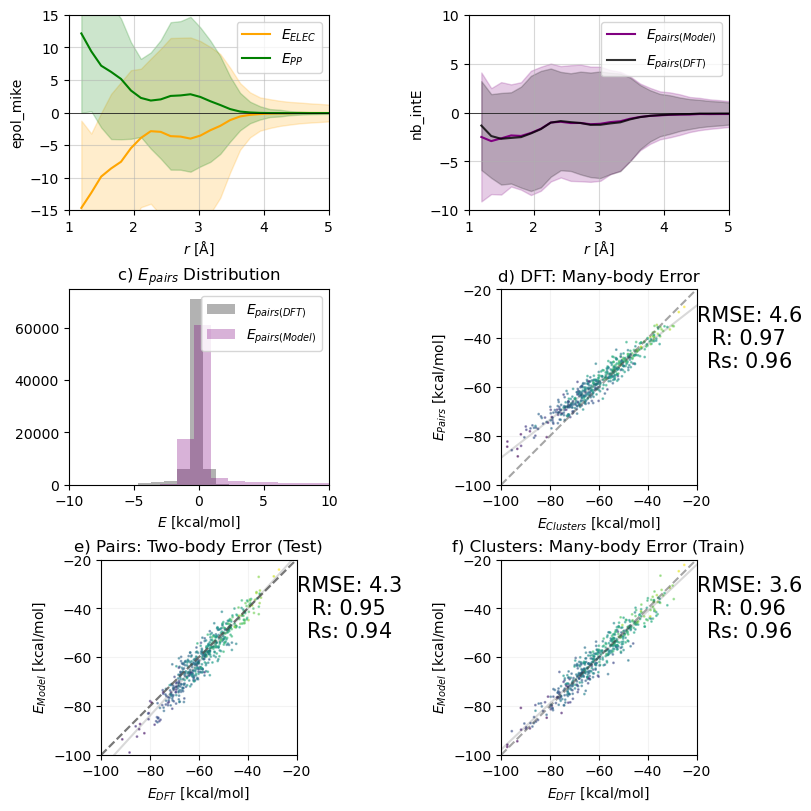

3
12.270512300272097


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


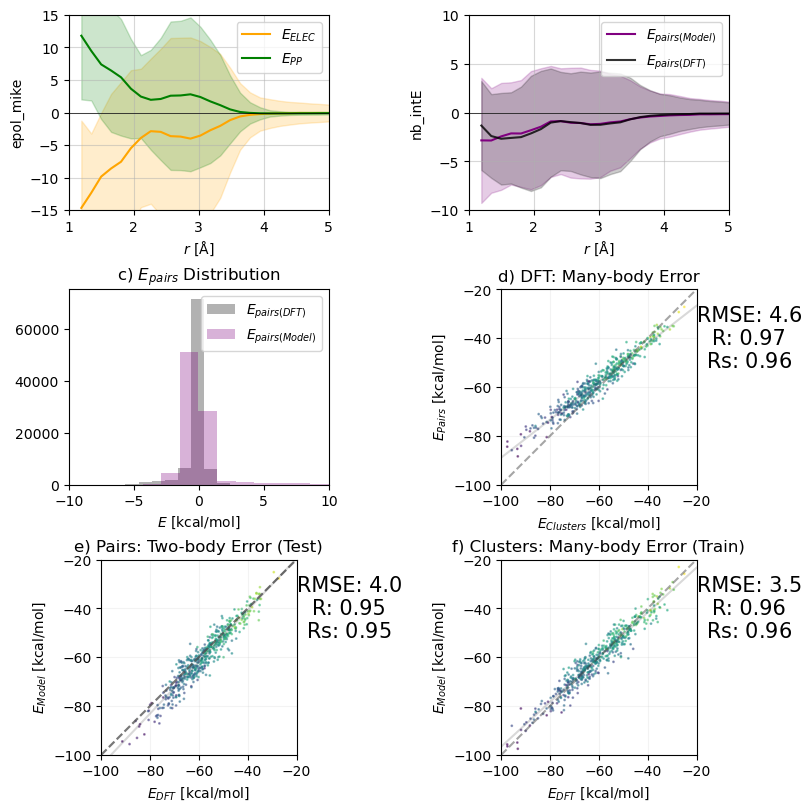

4
13.404873331219518


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


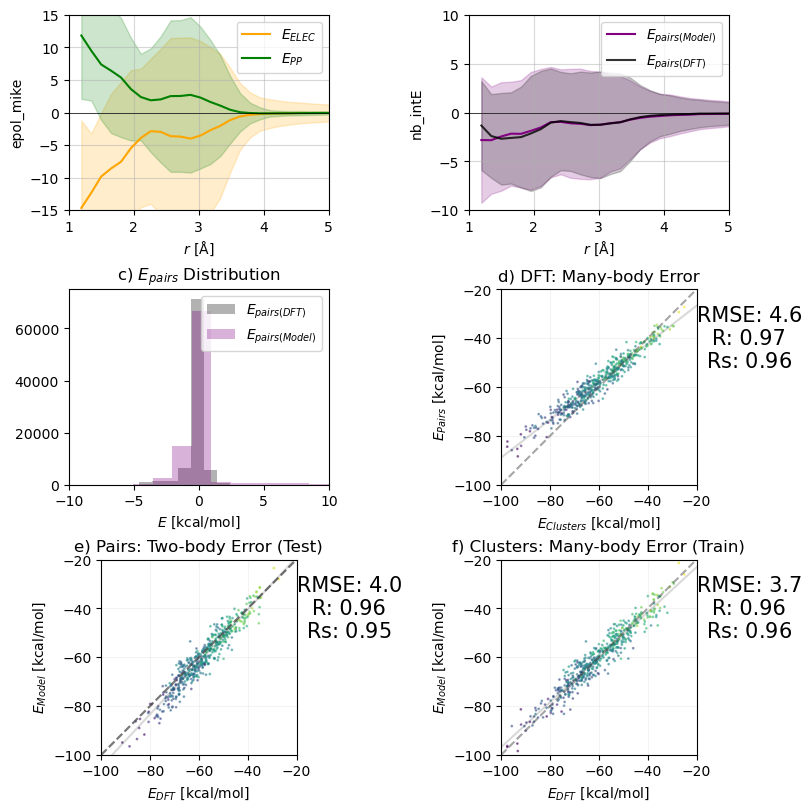

5
11.313553013730726


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


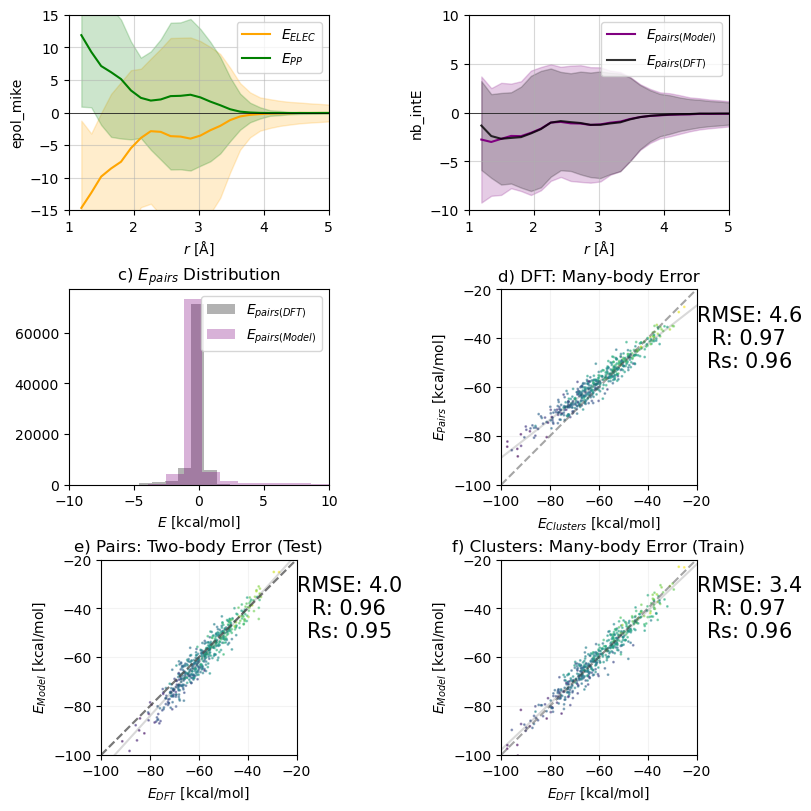

6
8202.43556708755


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


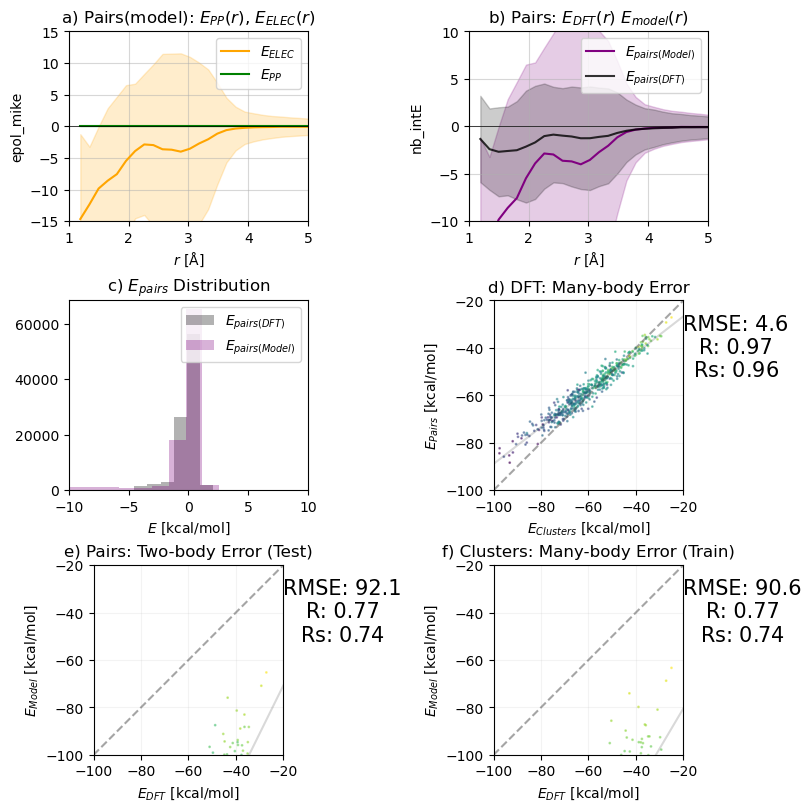

7
11.821520852505461


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


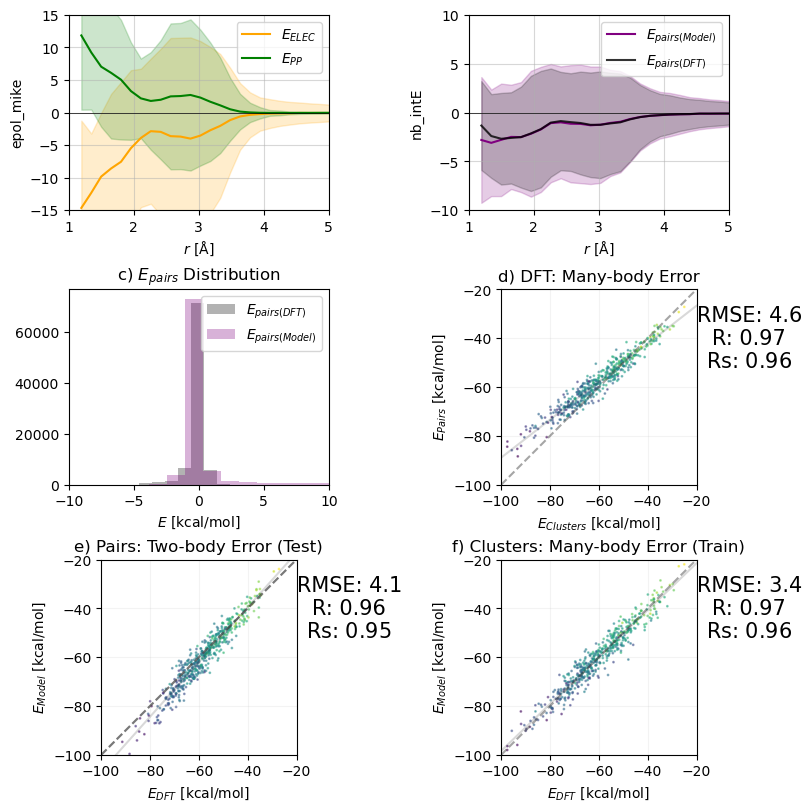

8
12.256982892517085


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


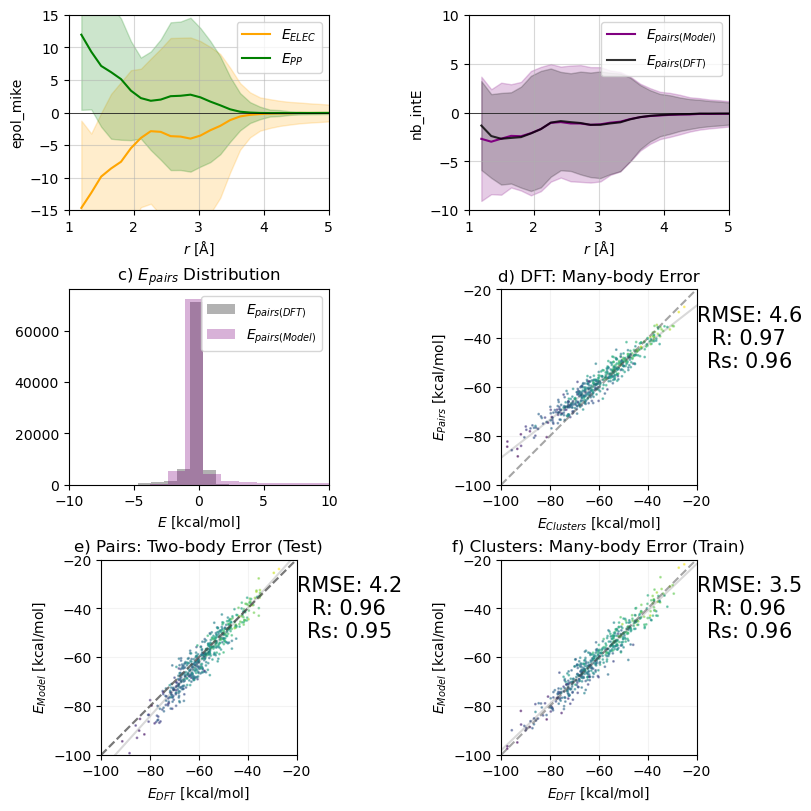

9
11.3135367408909


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


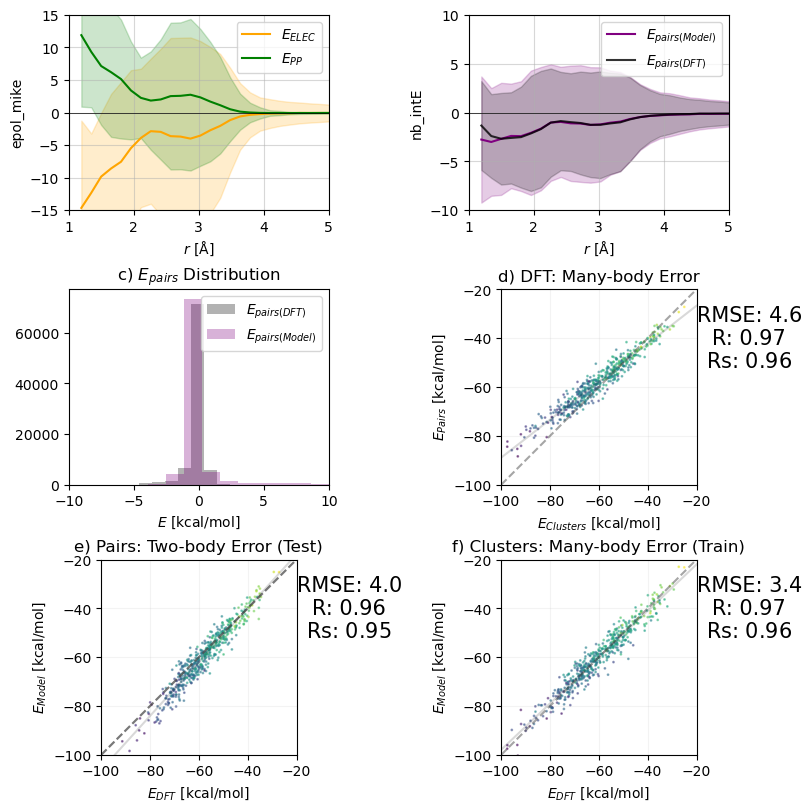

In [679]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_kmdcm = next(read_from_pickle('pickles/pbe0_dz_pc_DE_water_cluster_epol_mike_Exact_epol_mike.pkl'))
epol_de_exact_stats = plot_ff_fit(ff, ff_fit_kmdcm, ecol="epol_mike", EB=("sd", 3), suptitle="EPOL-DE")

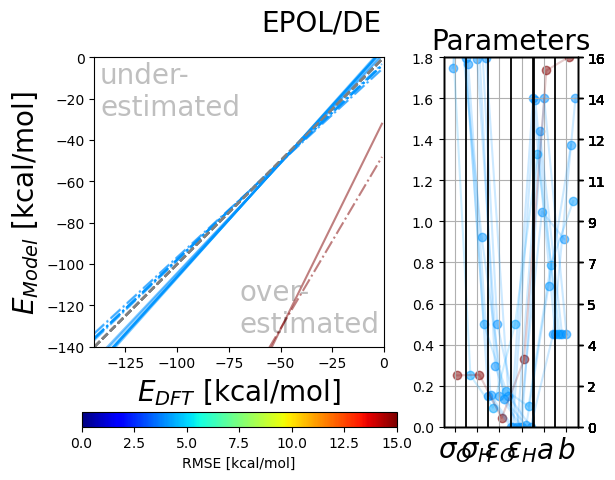

In [692]:
parm_plots(epol_de_exact_stats, title="EPOL/DE")
plt.savefig("EPOLDE.png", bbox_inches="tight")

# ECOL

6632.377923459048 81.43941259279225
0
21.12252923421373


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


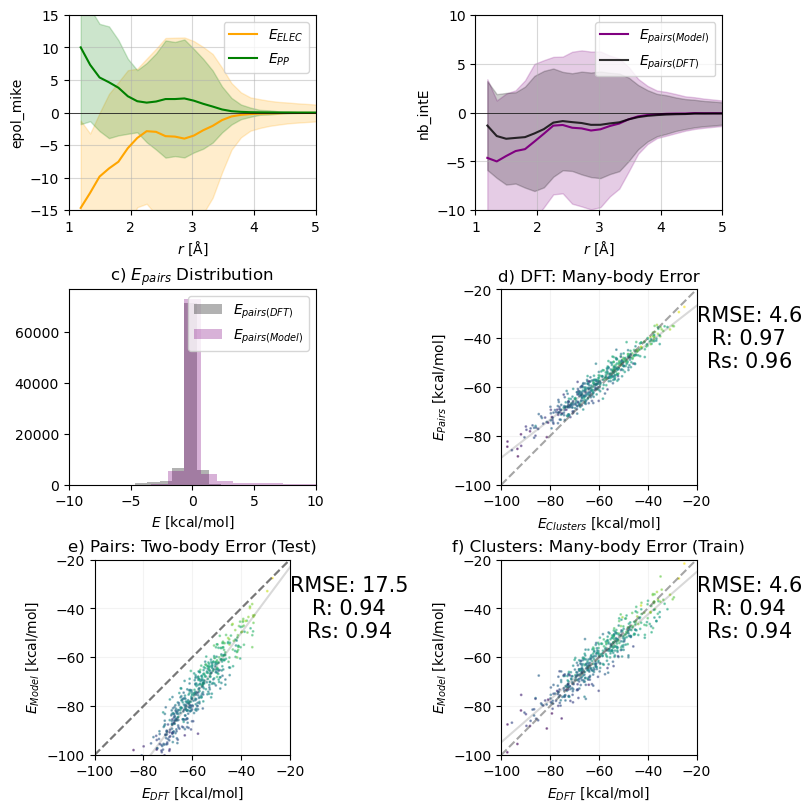

1
21.08952046099696


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


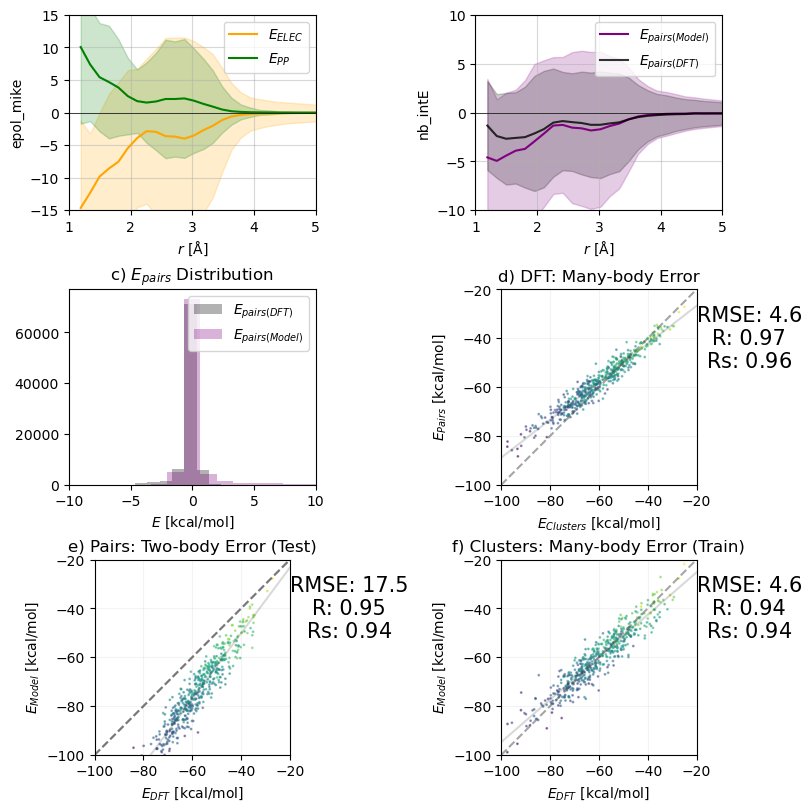

2
103.89261057602033


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


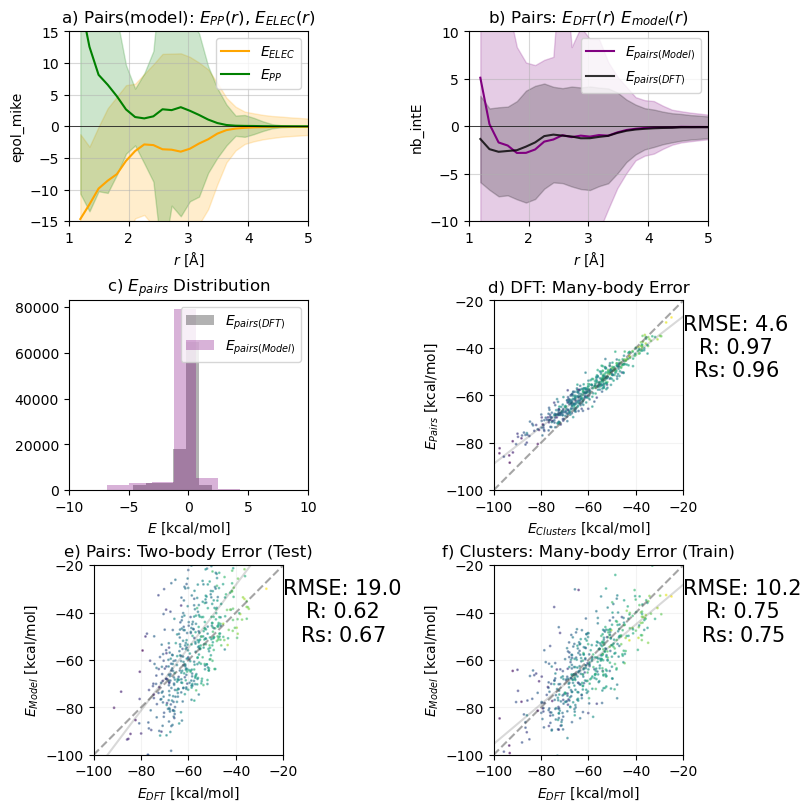

3
21.007001183407354


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


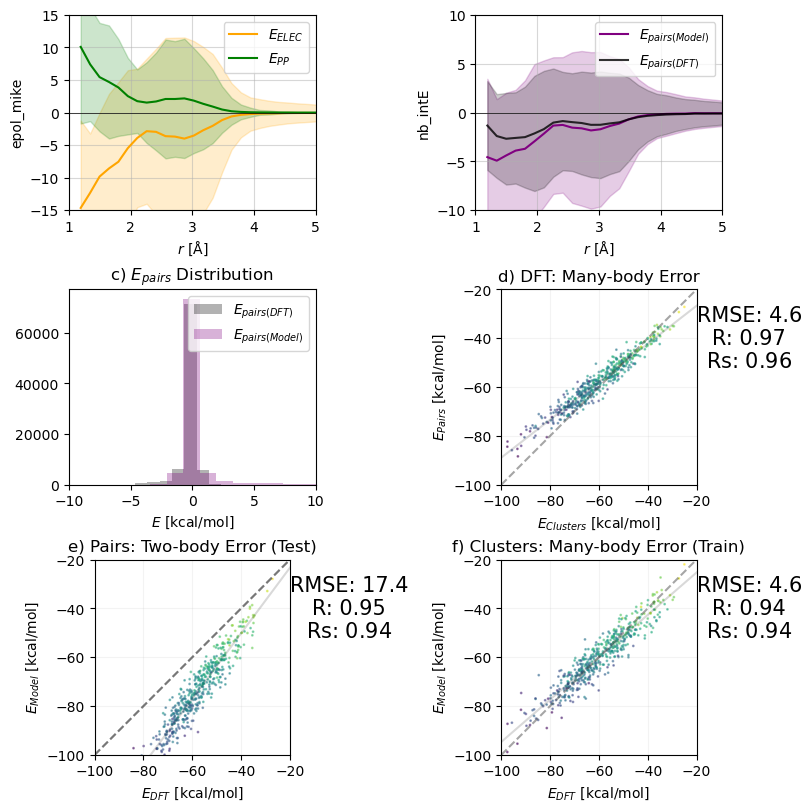

4
20.983617524461085


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


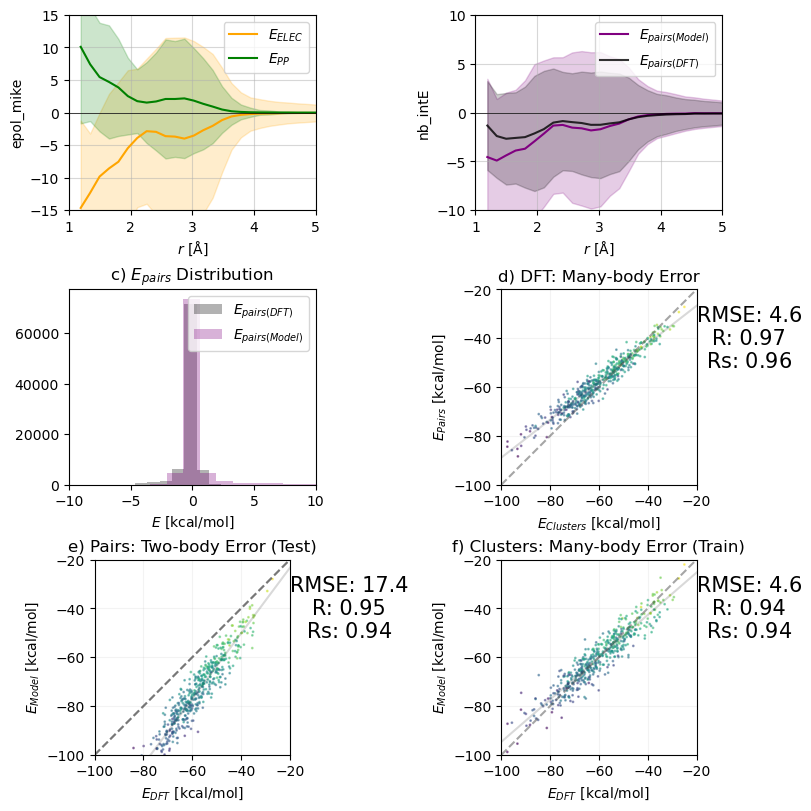

5
20.983617524428322


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


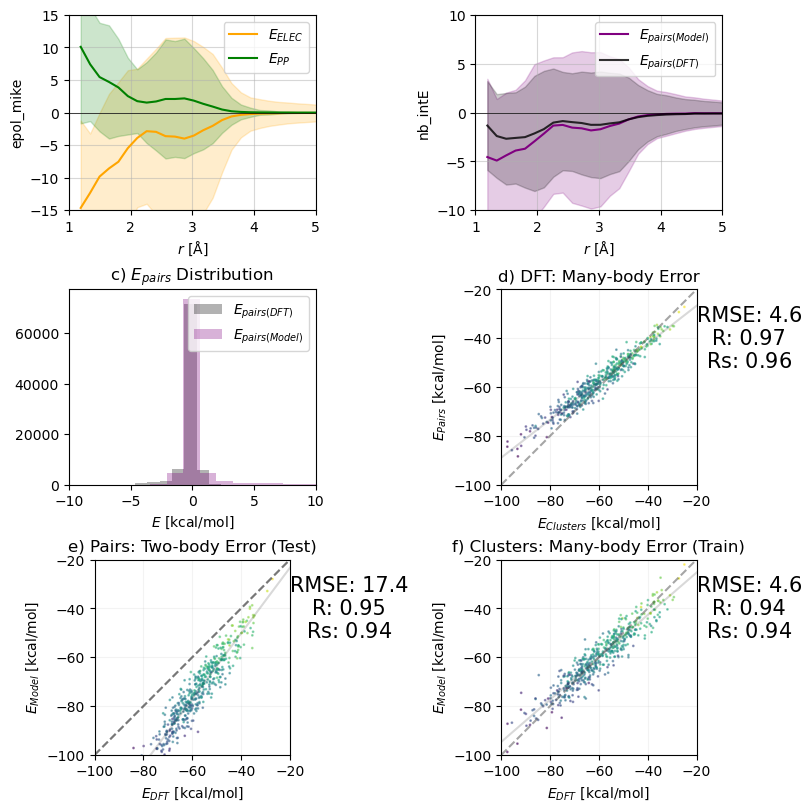

6
103.89261053548964


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


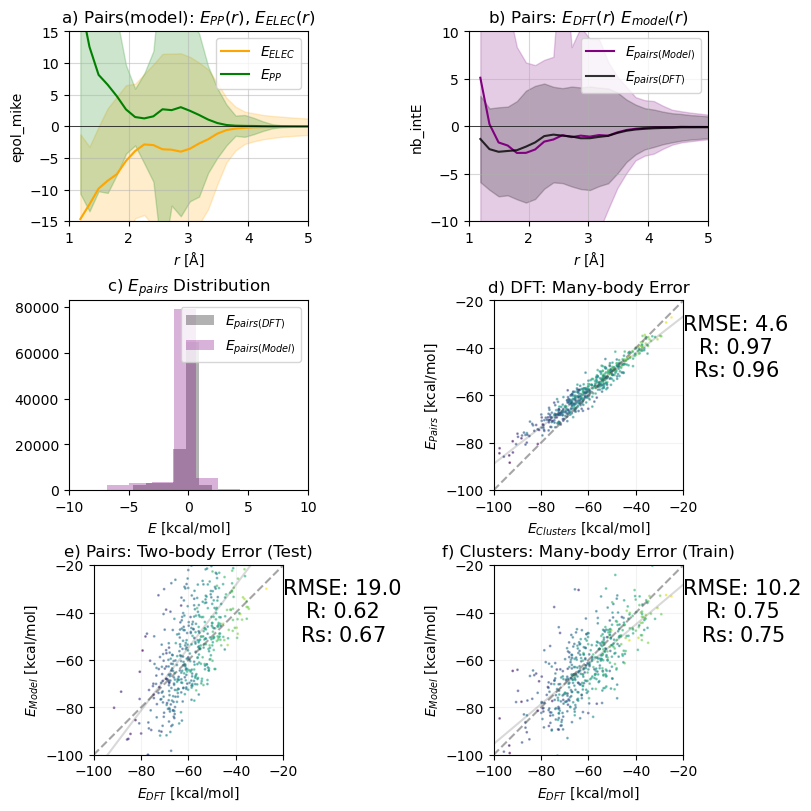

7
103.8926105355352


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


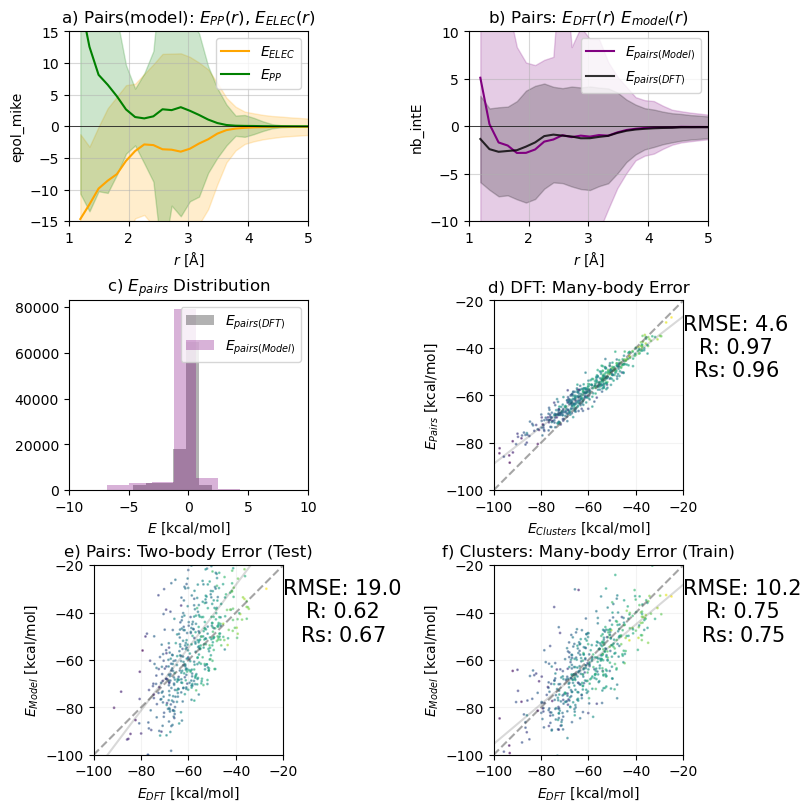

8
103.8926105355392


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


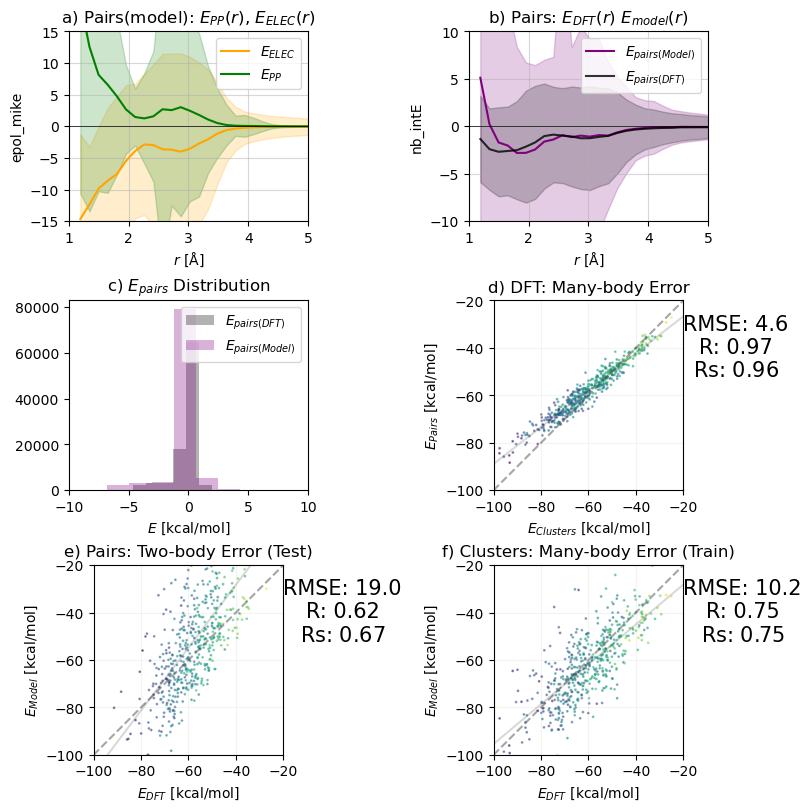

9
20.984205177829033


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax, _, stats = plot_energy_MSE(fit.groupby("key").sum(),


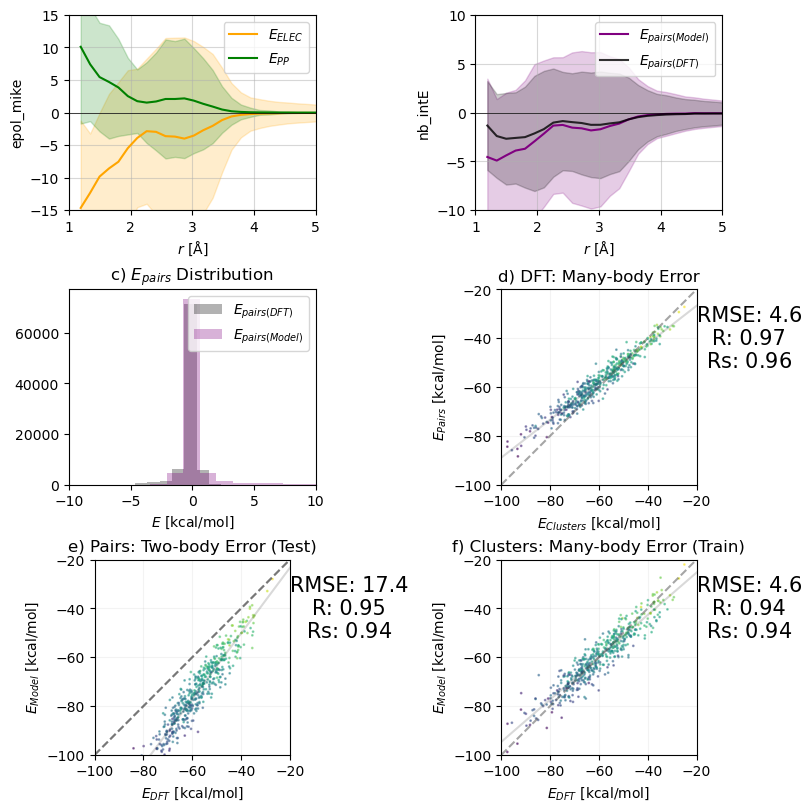

In [689]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_kmdcm = next(read_from_pickle('pickles/pbe0_dz_pc_LJ_water_cluster_ECOL_Exact_ECOL.pkl'))
ecol_lj_exact_stats = plot_ff_fit(ff, ff_fit_kmdcm, ecol="epol_mike", EB=("sd", 3), suptitle="ECOL-LJ")

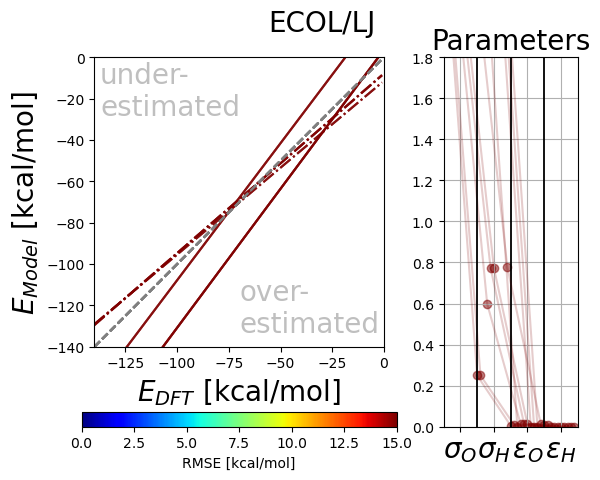

In [687]:
parm_plots(ecol_lj_exact_stats, title="ECOL/LJ")
plt.savefig("ECOLLJ.png", bbox_inches="tight")

6632.377923459048 81.43941259279225
0
20.066852242769478


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


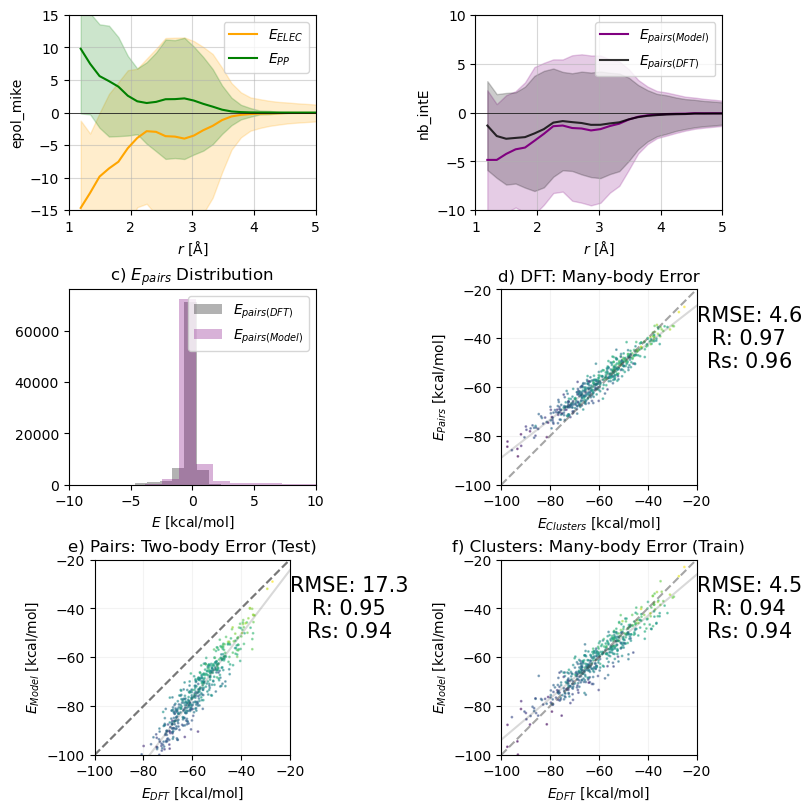

1
20.055532171037804


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


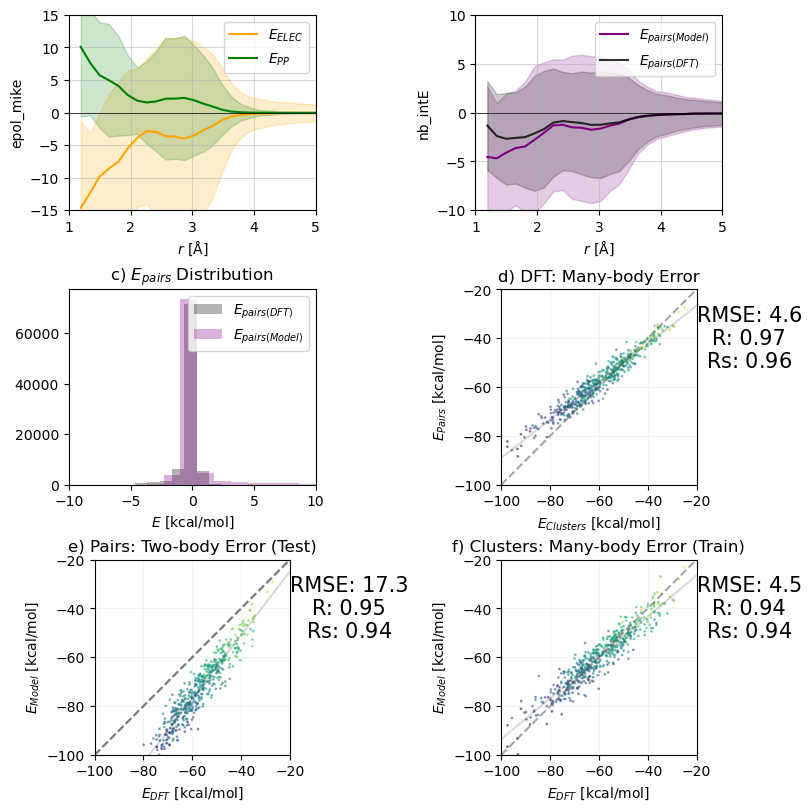

2
21.823247201789403


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


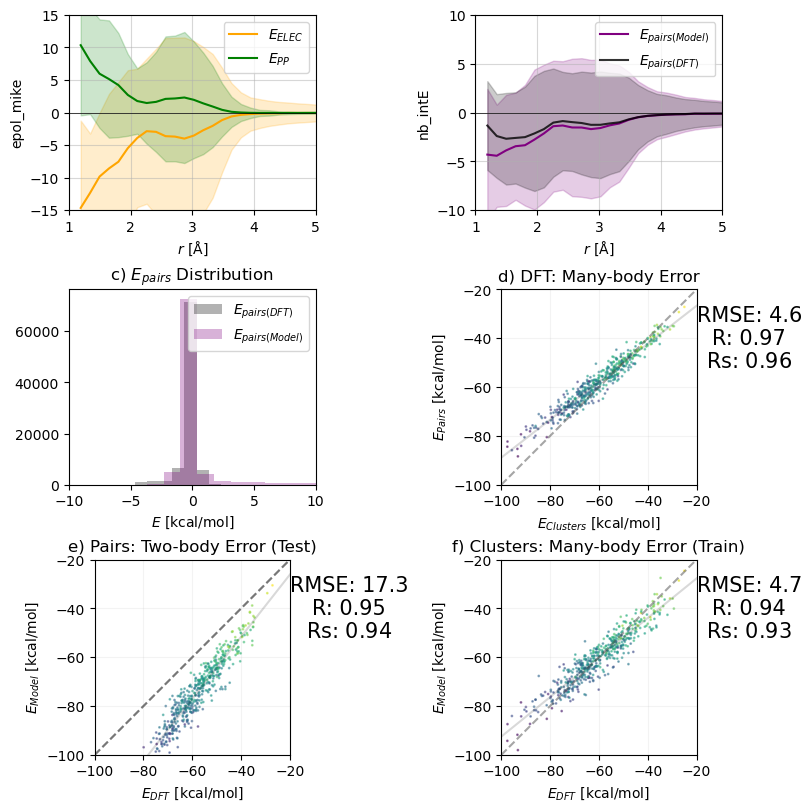

3
20.069721232239907


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


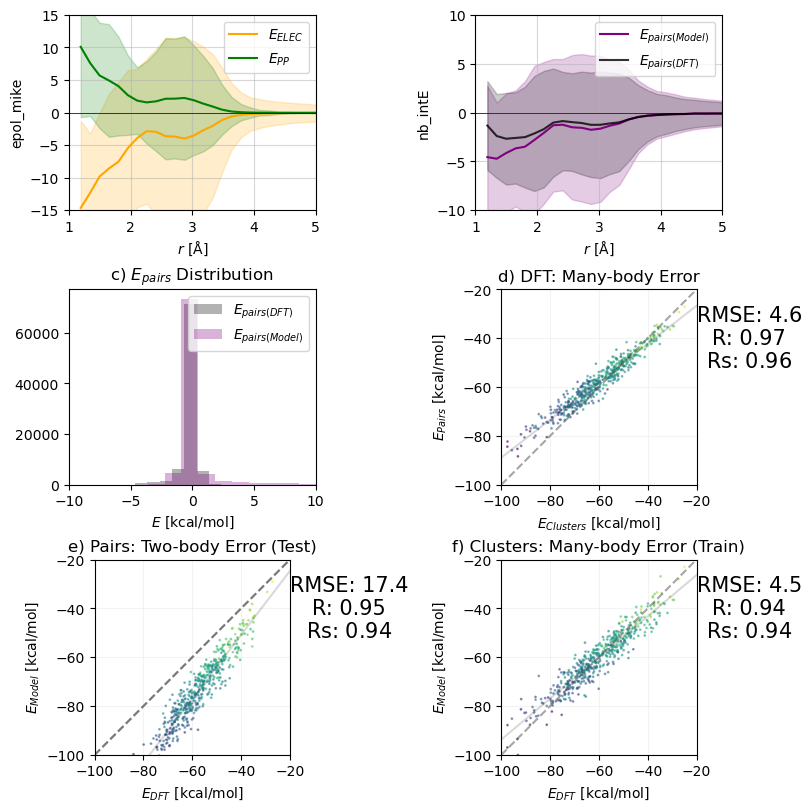

4
5713.157678036958


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


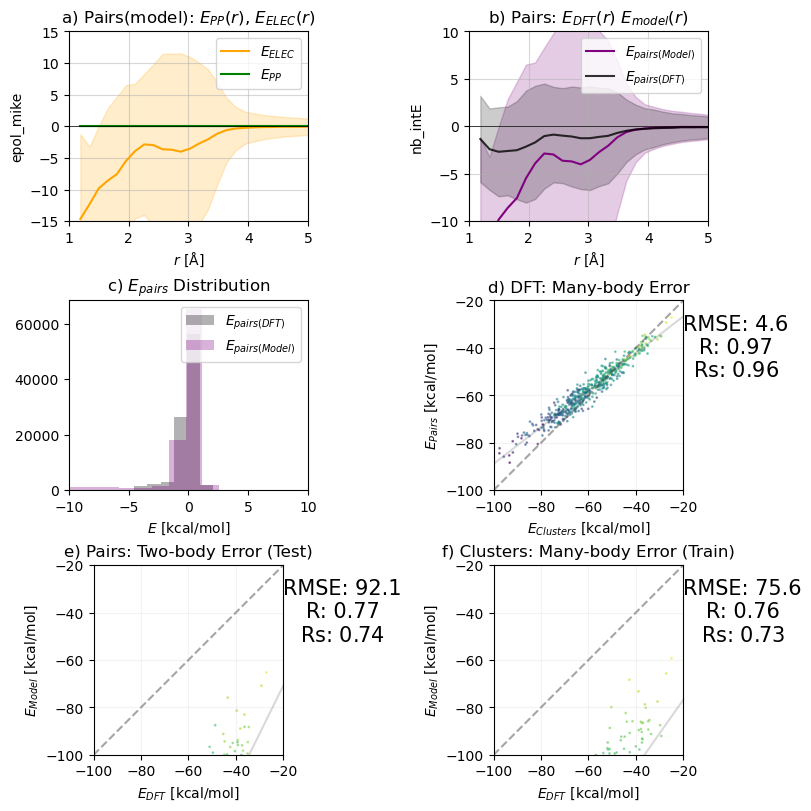

5
19.870351012572282


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


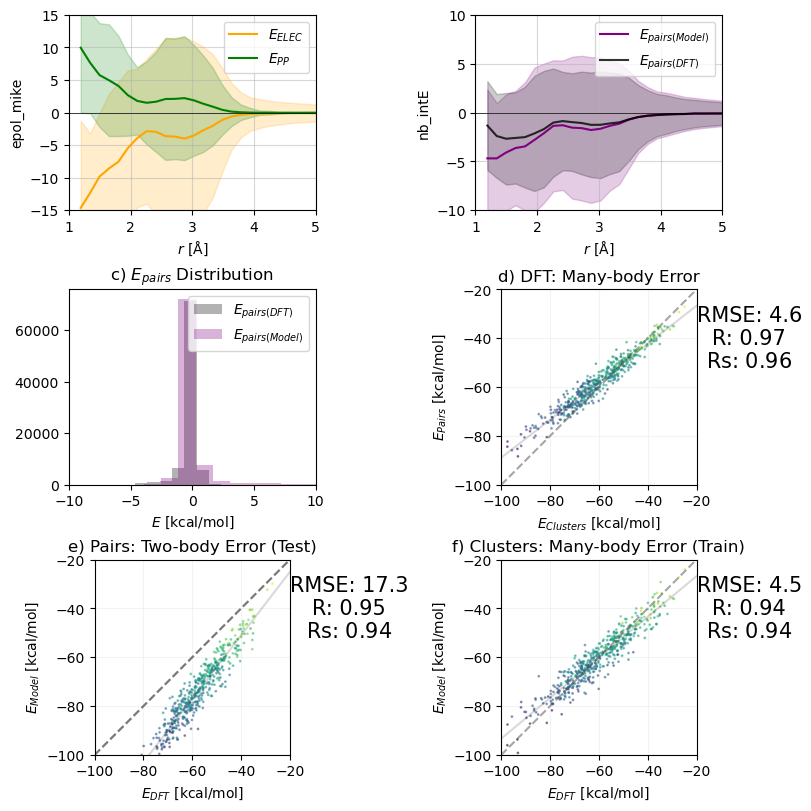

6
19.877215001171933


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


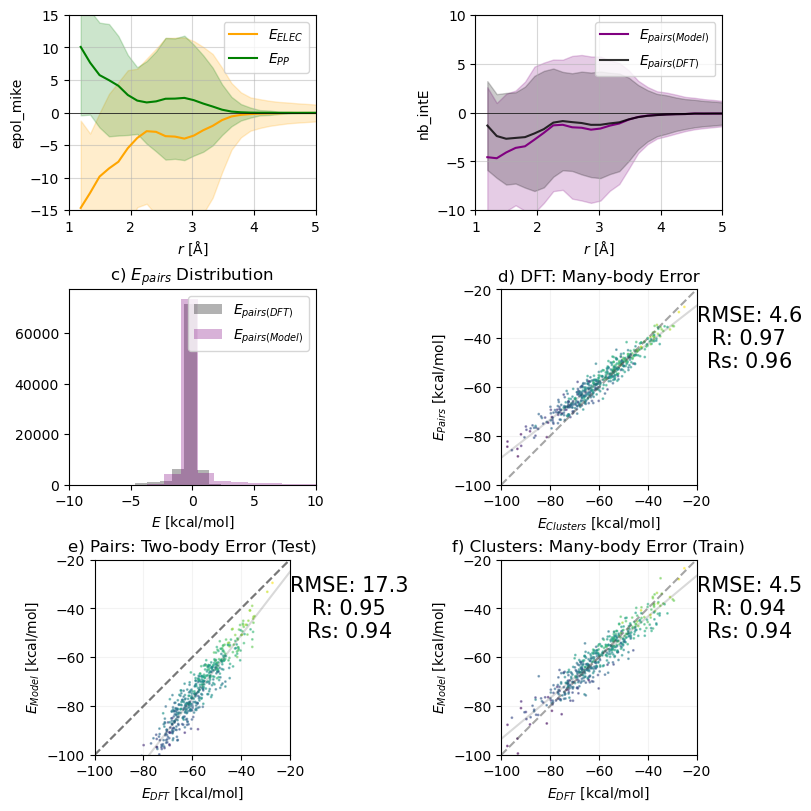

7
20.131811352383373


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


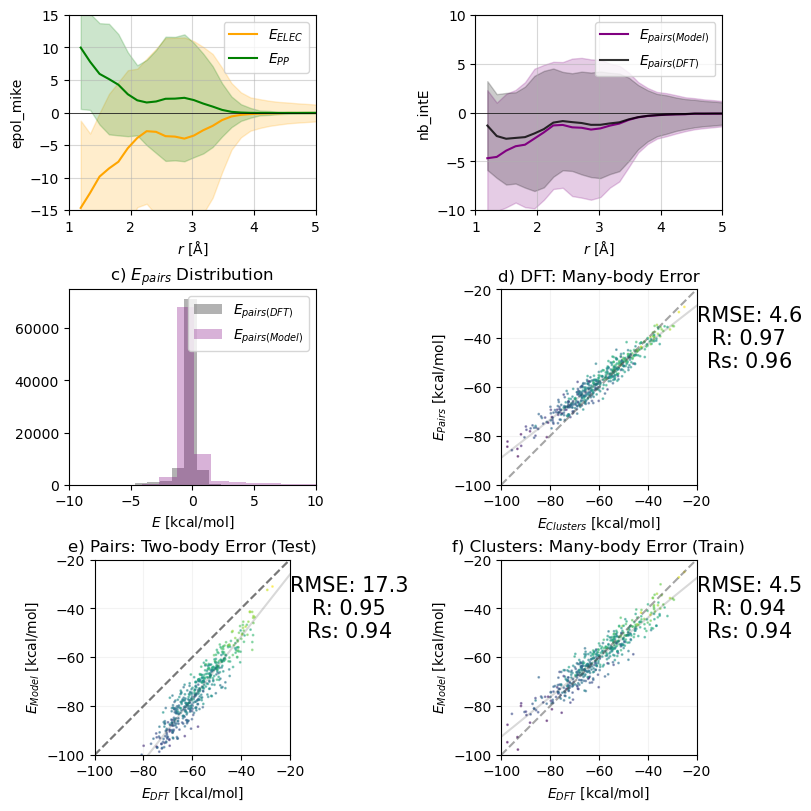

8
19.766360227015568


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


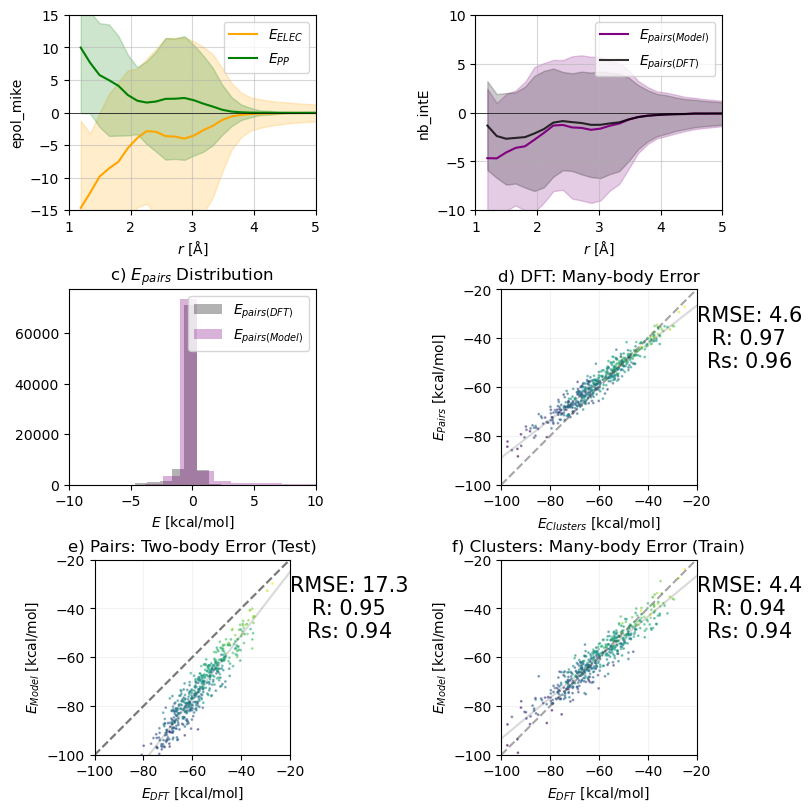

9
19.76116600866166


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


shuffling.. ooops


/home/boittier/Documents/phd/ff_energy/ff_energy/plot.py:312: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  "nb_intE",


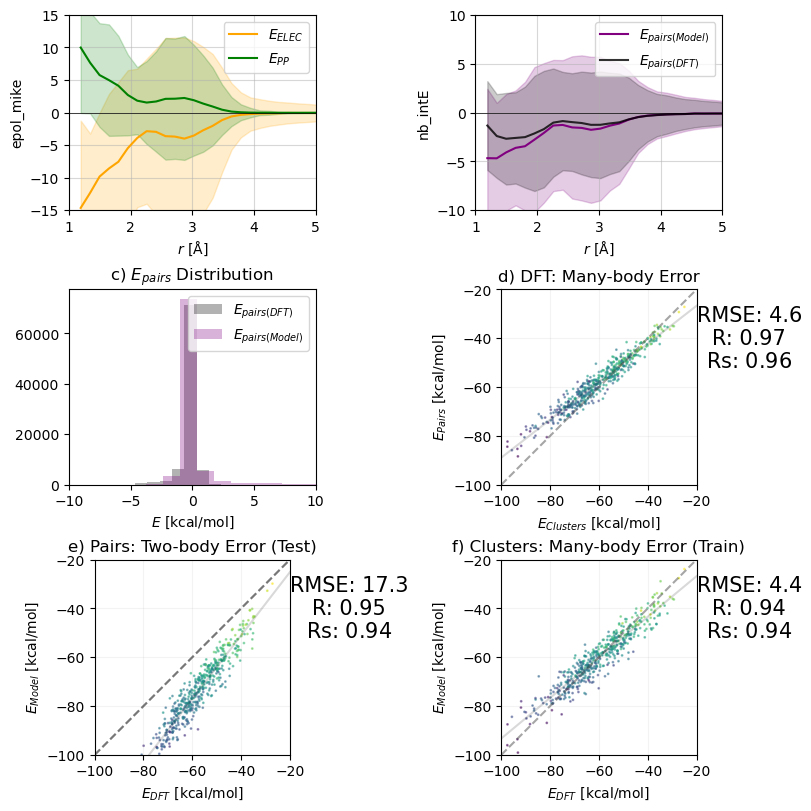

In [681]:
ff = next(read_from_pickle('pickles/ff_pc_pairs.pkl'))
ff_fit_kmdcm = next(read_from_pickle('pickles/pbe0_dz_pc_DE_water_cluster_ECOL_Exact_ECOL.pkl'))
ecol_de_exact_stats = plot_ff_fit(ff, ff_fit_kmdcm, ecol="epol_mike", EB=("sd", 3), suptitle="ECOL-DE")

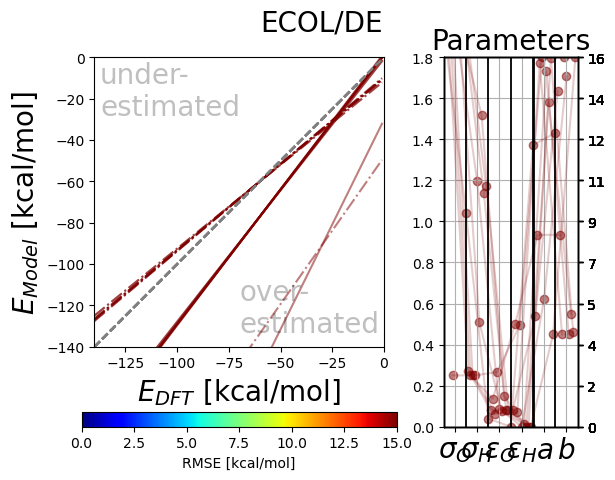

In [587]:
parm_plots(ecol_de_exact_stats, title="ECOL/DE")

In [304]:
# pc_pbe0_dz.plot_pair_monomer_E()

In [305]:
# pc_pbe0tz.plot_pair_monomer_E()

In [306]:
# pc_hf_dz.plot_pair_monomer_E()

In [633]:
pnolccsd_pvtzdf.data = pnolccsd_pvtzdf.data[pnolccsd_pvtzdf.data["intE"] < 0]
pnolccsd_pvtzdf.data = pnolccsd_pvtzdf.data[pnolccsd_pvtzdf.data["P_intE"] < 0]
pnolccsd_pvtzdf.data.describe()

,M_ENERGY,n_monomers,C_ENERGY,n_pairs,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol
count,432.000000,432.0,432.000000,432.000000,432.000000,432.000000,432.000000,432.000000,432.000000
mean,-1527.398698,20.0,-1527.496072,189.986111,-61.102354,-57.265591,-958447.265493,-958448.322266,-958508.367847
std,0.008882,0.0,0.022156,0.135529,12.770159,10.245241,5.573566,5.861843,13.902998
min,-1527.423689,20.0,-1527.558581,188.000000,-97.605124,-86.010979,-958462.946968,-958464.248241,-958547.592329
25%,-1527.404826,20.0,-1527.511039,190.000000,-69.707605,-64.708978,-958451.110529,-958452.223963,-958517.759321
50%,-1527.399172,20.0,-1527.497059,190.000000,-61.717750,-57.655723,-958447.562753,-958448.616550,-958508.986734
75%,-1527.393081,20.0,-1527.481036,190.000000,-52.684793,-50.532214,-958443.740314,-958444.633691,-958498.932659
max,-1527.370598,20.0,-1527.440257,190.000000,-27.355146,-28.268429,-958429.632263,-958430.249915,-958473.343833


<Axes: >

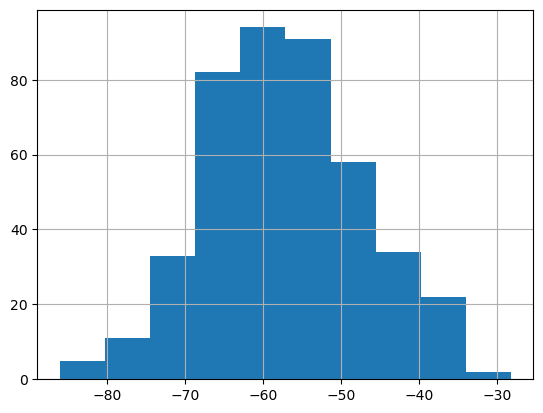

In [634]:
pnolccsd_pvtzdf.data['P_intE'].hist()

In [607]:
pc_pbe0_dz_d4.data.describe()

,ECOL,TOTAL,ELEC,VDW,M_ENERGY,n_monomers,C_ENERGY,n_pairs,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol,NBONDS,nb_intE
count,500.000000,500.000000,500.000000,500.000000,499.000000,500.0,500.000000,500.000000,499.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000
mean,-133.827185,22.381426,-67.859102,16.144373,-1527.149512,20.0,-1527.266244,189.504000,-73.220723,-71.277730,-958290.896097,-958291.987715,-958364.150064,-51.714729,-51.714729
std,24.856582,2.211815,12.957433,5.942390,0.008766,0.0,0.024025,1.279554,14.005057,11.538206,5.495837,5.788407,15.075471,9.496744,9.496744
min,-200.733503,15.659680,-103.426560,-0.473550,-1527.172550,20.0,-1527.355451,180.000000,-119.139401,-107.906274,-958305.356511,-958306.586371,-958420.127876,-79.200120,-79.200120
25%,-151.116341,20.823118,-76.683603,11.621738,-1527.155411,20.0,-1527.281645,190.000000,-82.356226,-79.371719,-958294.596253,-958295.944454,-958373.813919,-58.174290,-58.174290
50%,-133.880791,22.313955,-68.597010,15.881015,-1527.149938,20.0,-1527.267910,190.000000,-74.021816,-71.755623,-958291.137679,-958292.493834,-958365.195605,-51.969300,-51.969300
75%,-117.043617,23.953010,-59.230308,20.017783,-1527.143855,20.0,-1527.249622,190.000000,-63.784764,-63.730310,-958287.353378,-958288.264050,-958353.719814,-45.561567,-45.561567
max,-59.273033,28.093770,-27.200860,35.037000,-1527.121068,20.0,-1527.204174,190.000000,-34.641033,-36.754984,-958273.051609,-958272.274081,-958325.200490,-22.766810,-22.766810


In [608]:
pc_pbe0_dz.data.describe()

,ECOL,TOTAL,ELEC,VDW,M_ENERGY,n_monomers,C_ENERGY,n_pairs,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol,NBONDS,nb_intE,n,epol_mike
count,500.000000,500.000000,500.000000,500.000000,500.000000,500.0,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000
mean,-133.827185,22.381426,-67.859102,16.144373,-1527.146302,20.0,-1527.242271,189.504000,-60.220800,-57.976652,-958288.886029,-958289.978786,-958349.106829,-51.714729,-51.714729,249.500000,-148.453094
std,24.856582,2.211815,12.957433,5.942390,0.008767,0.0,0.022827,1.279554,13.224149,10.628936,5.501566,5.794098,14.324272,9.496744,9.496744,144.481833,28.903127
min,-200.733503,15.659680,-103.426560,-0.473550,-1527.169378,20.0,-1527.325938,180.000000,-102.618427,-91.338505,-958303.366021,-958304.589708,-958401.608110,-79.200120,-79.200120,0.000000,-225.187517
25%,-151.116341,20.823118,-76.683603,11.621738,-1527.152207,20.0,-1527.257165,190.000000,-68.747177,-65.724057,-958292.591169,-958293.939627,-958358.452723,-58.174290,-58.174290,124.750000,-168.686321
50%,-133.880791,22.313955,-68.597010,15.881015,-1527.146693,20.0,-1527.242883,190.000000,-60.845386,-58.342427,-958289.131411,-958290.487174,-958349.490830,-51.969300,-51.969300,249.500000,-148.067779
75%,-117.043617,23.953010,-59.230308,20.017783,-1527.140654,20.0,-1527.226421,190.000000,-51.066453,-50.426095,-958285.341969,-958286.255076,-958339.160783,-45.561567,-45.561567,374.250000,-129.198416
max,-59.273033,28.093770,-27.200860,35.037000,-1527.117848,20.0,-1527.184906,190.000000,-25.015840,-27.178186,-958271.031149,-958270.254739,-958313.110340,-22.766810,-22.766810,499.000000,-63.323064


In [609]:
pc_hf_dz.data.describe()

,M_ENERGY,n_monomers,C_ENERGY,n_pairs,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol
count,500.000000,500.0,500.000000,500.0,500.000000,500.000000,500.000000,500.000000,500.000000
mean,-1520.733466,20.0,-1520.779124,190.0,-28.650990,-22.788556,-954264.811910,-954265.105354,-954293.462900
std,0.013915,0.0,0.023388,0.0,11.645006,9.271737,8.731658,8.826096,14.676203
min,-1520.773955,20.0,-1520.852882,190.0,-61.010968,-46.568714,-954290.219022,-954290.203742,-954339.746277
25%,-1520.742690,20.0,-1520.794304,190.0,-36.431257,-29.186478,-954270.600506,-954271.161047,-954302.988317
50%,-1520.733949,20.0,-1520.780017,190.0,-29.411238,-23.271446,-954265.114980,-954265.486506,-954294.022829
75%,-1520.724297,20.0,-1520.764562,190.0,-20.547045,-16.499341,-954259.058641,-954259.476201,-954284.324905
max,-1520.692966,20.0,-1520.710157,190.0,1.146366,2.099289,-954239.398363,-954239.923506,-954250.185792


In [610]:
pc_pbe0tz.data.describe()

,M_ENERGY,n_monomers,C_ENERGY,n_pairs,intE,P_intE,m_E_tot,p_m_E_tot,C_ENERGY_kcalmol
count,500.000000,500.0,206.000000,500.000000,206.000000,500.000000,500.000000,500.000000,206.000000
mean,-1527.542847,20.0,-1527.628928,189.992000,-54.001603,-52.914172,-958537.718926,-958538.780969,-958591.735105
std,0.009291,0.0,0.022446,0.089173,12.927322,10.295779,5.830229,6.119043,14.085155
min,-1527.568004,20.0,-1527.687217,189.000000,-87.078849,-84.578786,-958553.505183,-958554.759604,-958628.311673
25%,-1527.549226,20.0,-1527.645370,190.000000,-63.112627,-60.432964,-958541.722184,-958542.928948,-958602.052817
50%,-1527.543363,20.0,-1527.630506,190.000000,-54.894201,-53.347405,-958538.042853,-958539.208350,-958592.725416
75%,-1527.536950,20.0,-1527.613400,190.000000,-45.373063,-45.761901,-958534.018563,-958534.804928,-958581.991576
max,-1527.513277,20.0,-1527.575416,190.000000,-21.177743,-22.985821,-958519.164039,-958518.514585,-958558.156266


In [635]:
dataframes = [pc_pbe0_dz_d4.data, 
              pc_pbe0_dz.data, 
              pc_hf_dz.data, 
              pc_pbe0tz.data,
             pnolccsd_pvtzdf.data 
             ]

columns = ["PBE0/DZ", "PBE0/DZ+D4", "HF/DZ", "PBE0/TZ", "CCSD(T)/TZ"]

# Combine the dataframes for each key (column) separately
keys = ['M_ENERGY', 'n_monomers', 'C_ENERGY', 'n_pairs', 'intE', 'P_intE', 'm_E_tot', 'p_m_E_tot', 'C_ENERGY_kcalmol']

combined_dataframes = {}
data_blocks = {}
for key in keys:
    combined_df = pd.concat([df[[key]] for df in dataframes], axis=1)
    combined_dataframes[key] = combined_df
    combined_dataframes[key].columns = columns
    data_blocks[key] = combined_dataframes[key].copy()
    _ = []
    categ = []
    indexes = []
    for cat in columns:
        _.extend(list(combined_dataframes[key][cat]))
        categ.extend([cat]*len(combined_dataframes[key][cat]))
        indexes.extend(combined_dataframes[key][cat].index)
    combined_dataframes[key] = pd.DataFrame({key: _, "theory": categ}, index=indexes)
    

In [636]:
'M_ENERGY', 'n_monomers', 'C_ENERGY', 'n_pairs', 'intE', 'P_intE', 'm_E_tot', 'p_m_E_tot', 'C_ENERGY_kcalmol'

('M_ENERGY',
 'n_monomers',
 'C_ENERGY',
 'n_pairs',
 'intE',
 'P_intE',
 'm_E_tot',
 'p_m_E_tot',
 'C_ENERGY_kcalmol')

In [651]:
key = "intE"
# key = "P_intE"
# key = "M_ENERGY"
# key = "C_ENERGY"
# key = "C_ENERGY_kcalmol"
df = combined_dataframes[key]
df["key"] = df.index
df = df.reset_index()
df.dropna()
data = data_blocks[key]

In [652]:
data = data.dropna()
df = df.dropna()
if key == "M_ENERGY" or key == "C_ENERGY":
    data = data * 627.2
    data = data - data.mean()
    for c in columns:
        df[df["theory"] == c][key] = (df[df["theory"] == c][key] * 627.2).copy()
        df[df["theory"] == c][key] = (df[df["theory"] == c][key] - df[df["theory"] == c][key].mean()).copy()

In [706]:
df.groupby("theory").count()

,index,intE,key
theory,,,
CCSD(T)/TZ,432,432,432
HF/DZ,500,500,500
PBE0/DZ,499,499,499
PBE0/DZ+D4,500,500,500
PBE0/TZ,206,206,206


In [653]:
pc = sp.posthoc_conover(df, val_col=key, group_col='theory', 
                   p_adjust = 'holm')
pc

,CCSD(T)/TZ,HF/DZ,PBE0/DZ,PBE0/DZ+D4,PBE0/TZ
CCSD(T)/TZ,1.000000e+00,2.831075e-211,2.408398e-45,2.070497e-01,2.591903e-12
HF/DZ,2.831075e-211,1.000000e+00,0.000000e+00,1.327988e-211,1.009965e-83
PBE0/DZ,2.408398e-45,0.000000e+00,1.000000e+00,1.262464e-56,3.666278e-73
PBE0/DZ+D4,2.070497e-01,1.327988e-211,1.262464e-56,1.000000e+00,5.032237e-10
PBE0/TZ,2.591903e-12,1.009965e-83,3.666278e-73,5.032237e-10,1.000000e+00


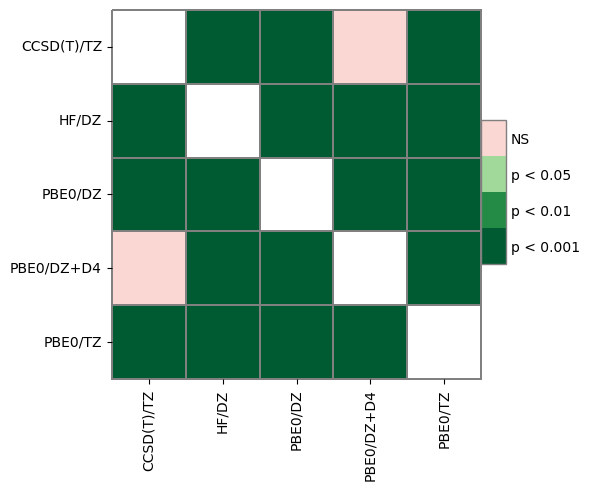

In [665]:
# pc = sp.posthoc_conover(x, val_col='values', group_col='groups')
heatmap_args = {'linewidths': 0.25, 'linecolor': '0.5', 'clip_on': False, 'square': True, 'cbar_ax_bbox': [0.80, 0.35, 0.04, 0.3]}
sp.sign_plot(pc, **heatmap_args)
plt.savefig("conover_intE.pdf", bbox_inches="tight")

In [649]:
palette = ["blue", "skyblue", "green", "darkblue", "k"]

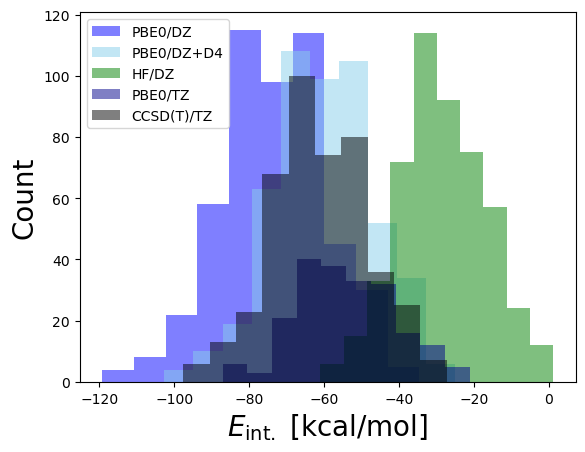

In [664]:
for i, c in enumerate(columns):
    plt.hist(df[df["theory"] == c][key], 
             label=c, alpha=0.5, color=palette[i])

plt.legend()
# plt.title("")
plt.xlabel("$E_{\mathrm{int.}}$ [kcal/mol]", fontsize=20)
plt.ylabel("Count", fontsize=20)
plt.savefig("dists_intE.pdf")

In [655]:
df

,index,intE,theory,key
0,test467,-64.991515,PBE0/DZ,test467
1,test263,-79.682966,PBE0/DZ,test263
2,test35,-84.967747,PBE0/DZ,test35
3,test223,-46.697637,PBE0/DZ,test223
4,test254,-77.608492,PBE0/DZ,test254
...,...,...,...,...
2495,test100,-43.653533,CCSD(T)/TZ,test100
2496,test304,-56.816086,CCSD(T)/TZ,test304
2497,test327,-91.041574,CCSD(T)/TZ,test327
2498,test185,-55.491006,CCSD(T)/TZ,test185


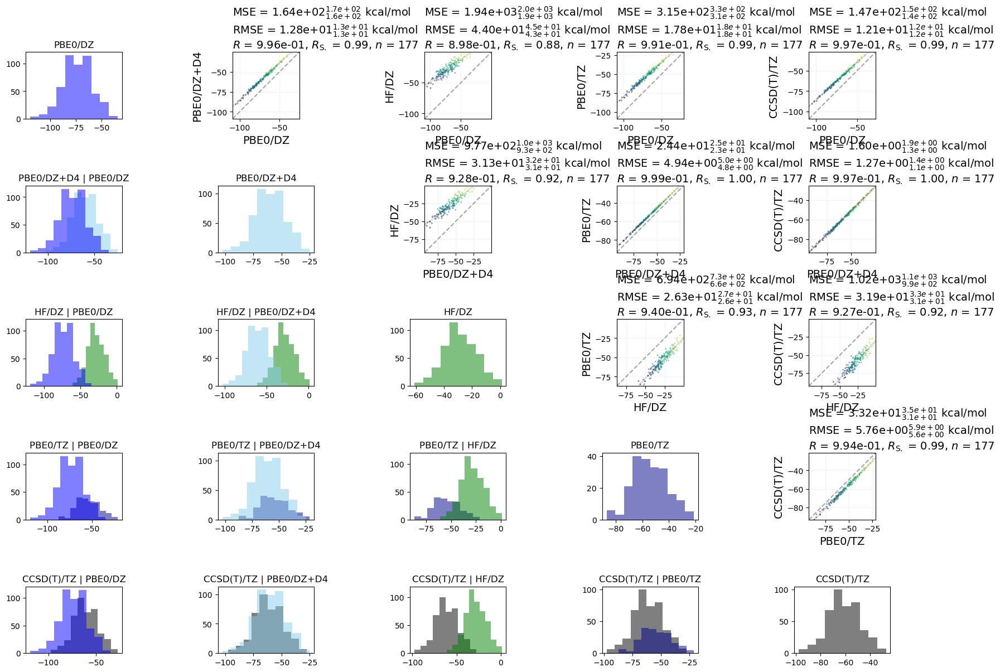

In [656]:
fig, ax = plt.subplots(5,5, figsize=(20,14))
plt.subplots_adjust(hspace=1,wspace=1)

    
for i, K1 in enumerate(columns):
    for j, K2 in enumerate(columns):
        if i < j:
            plot_energy_MSE(data, 
                            K1, 
                            K2, 
                            elec="HF/DZ",
                            xlabel=K1,
                            ylabel=K2,
                            ax=ax[i,j]
                           )
        if i == j:
            c = columns[i]
            ax[i,j].hist(df[df["theory"] == c][key], 
                         label=c, alpha=0.5, color=palette[i])
            ax[i,j].set_title(c)
        if i > j:
            c = columns[i]
            ax[i,j].set_title(f"{columns[i]} | {columns[j]}")
            ax[i,j].hist(df[df["theory"] == c][key], 
                         label=c, alpha=0.5,color=palette[i])
            c = columns[j]
            ax[i,j].hist(df[df["theory"] == c][key], 
                         label=c, alpha=0.5,color=palette[j])
            
plt.savefig(key+"comp.pdf", bbox_inches="tight")

In [657]:
data - data.mean()

,PBE0/DZ,PBE0/DZ+D4,HF/DZ,PBE0/TZ,CCSD(T)/TZ
test263,-7.895939,-5.091113,1.108451,-3.658321,-5.623387
test254,-5.821464,-4.673027,0.235694,-4.444783,-4.311924
test273,1.789545,2.843242,6.952913,3.132548,2.591914
test57,10.469561,10.699705,8.440974,10.530595,9.837534
test478,-33.125023,-31.422218,-28.134300,-30.800411,-30.711559
...,...,...,...,...,...
test46,18.057987,16.487968,10.591634,15.586870,15.195387
test489,-14.756994,-14.261316,-6.481663,-13.714734,-12.209552
test100,16.795262,15.903675,14.104195,15.563890,16.120446
test185,6.030329,4.230795,-0.305282,3.300938,4.282972
